# Задача 1: Прогнозування попиту

### Мета:
Розробити систему прогнозування попиту на короткостроковий період (14 днів) через 7 днів від останньої дати в даних, для всіх груп товарів.



### Опис:
1. Використовуючи надані дані про транзакції, створіть дві моделі
прогнозування:
- Модель машинного навчання.
- Класичну модель прогнозування часових рядів.

2. Дайте обґрунтовані коментарі щодо вибору методів та підходів, поясніть, чому ви обрали саме їх.

3. Надати скрипт або ноутбук (.py/.ipynb), який буде містити технічне рішення та можливість розрахунку прогнозу на майбутній період (scoring).

Очікуваний результат: Файл з кодом (.py або .ipynb), який включає дві моделі прогнозування, пояснення вибору методів, і можливість розрахунку прогнозу на майбутній період.



---



## Розархівуємо папки з даними

In [2]:
import zipfile
import os

In [ ]:

# Here should be your own directories
zip_file = r"/content/drive/MyDrive/Colab Notebooks/SMART_business/Data.zip"
directory = r"/content/drive/MyDrive/Colab Notebooks/SMART_business"


with zipfile.ZipFile(zip_file, "r") as f:
  f.extractall(directory)


In [3]:
data_direct = r"/content/drive/MyDrive/Colab Notebooks/SMART_business/S_Data"

os.listdir(data_direct)

['customers.csv',
 'dicts.zip',
 'geolocation.csv',
 'order_items.csv',
 'order_payments.csv',
 'order_reviews.csv',
 'orders.csv',
 'product_category_name_translation.csv',
 'products.csv',
 'sellers.csv',
 'dicts']

In [ ]:
zip_file = f"{data_direct}/dicts.zip"

with zipfile.ZipFile(zip_file, "r") as f:
  f.extractall(data_direct)


In [ ]:
os.listdir(f"{data_direct}/dicts")

['.DS_Store',
 'orders_dict.csv',
 'customers_dict.csv',
 'order_items_dict.csv',
 'products_dict.csv',
 'order_reviews_dict.csv',
 'order_payments_dict.csv',
 'geolocation_dict.csv']

## Деяке дослідження даних




In [4]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt


In [5]:
df_customers = pd.read_csv(f"{data_direct}/{os.listdir(data_direct)[0]}")
df_geolocation =  pd.read_csv(f"{data_direct}/geolocation.csv")
df_orders = pd.read_csv(f"{data_direct}/orders.csv")
order_items = pd.read_csv(f"{data_direct}/order_items.csv")
order_payments = pd.read_csv(f"{data_direct}/order_payments.csv")
order_reviews = pd.read_csv(f"{data_direct}/order_reviews.csv")
df_product_transcription = pd.read_csv(f"{data_direct}/product_category_name_translation.csv")
df_product = pd.read_csv(f"{data_direct}/products.csv")
df_sellers = pd.read_csv(f"{data_direct}/sellers.csv")


In [ ]:
df_customers


,customer_id,customer_unique_id,customer_zip_code_prefix,customer_city,customer_state
0,06b8999e2fba1a1fbc88172c00ba8bc7,861eff4711a542e4b93843c6dd7febb0,14409,franca,SP
1,18955e83d337fd6b2def6b18a428ac77,290c77bc529b7ac935b93aa66c333dc3,9790,sao bernardo do campo,SP
2,4e7b3e00288586ebd08712fdd0374a03,060e732b5b29e8181a18229c7b0b2b5e,1151,sao paulo,SP
3,b2b6027bc5c5109e529d4dc6358b12c3,259dac757896d24d7702b9acbbff3f3c,8775,mogi das cruzes,SP
4,4f2d8ab171c80ec8364f7c12e35b23ad,345ecd01c38d18a9036ed96c73b8d066,13056,campinas,SP
...,...,...,...,...,...
99436,17ddf5dd5d51696bb3d7c6291687be6f,1a29b476fee25c95fbafc67c5ac95cf8,3937,sao paulo,SP
99437,e7b71a9017aa05c9a7fd292d714858e8,d52a67c98be1cf6a5c84435bd38d095d,6764,taboao da serra,SP
99438,5e28dfe12db7fb50a4b2f691faecea5e,e9f50caf99f032f0bf3c55141f019d99,60115,fortaleza,CE
99439,56b18e2166679b8a959d72dd06da27f9,73c2643a0a458b49f58cea58833b192e,92120,canoas,RS


In [ ]:
print(df_customers.isnull().sum())

customer_id                 0
customer_unique_id          0
customer_zip_code_prefix    0
customer_city               0
customer_state              0
dtype: int64


In [ ]:
df_geolocation


,geolocation_zip_code_prefix,geolocation_lat,geolocation_lng,geolocation_city,geolocation_state
0,1037,-23.545621,-46.639292,sao paulo,SP
1,1046,-23.546081,-46.644820,sao paulo,SP
2,1046,-23.546129,-46.642951,sao paulo,SP
3,1041,-23.544392,-46.639499,sao paulo,SP
4,1035,-23.541578,-46.641607,sao paulo,SP
...,...,...,...,...,...
1000158,99950,-28.068639,-52.010705,tapejara,RS
1000159,99900,-27.877125,-52.224882,getulio vargas,RS
1000160,99950,-28.071855,-52.014716,tapejara,RS
1000161,99980,-28.388932,-51.846871,david canabarro,RS


In [ ]:
print(df_geolocation.isnull().sum())

geolocation_zip_code_prefix    0
geolocation_lat                0
geolocation_lng                0
geolocation_city               0
geolocation_state              0
dtype: int64


In [ ]:
df_orders


,order_id,customer_id,order_status,order_purchase_timestamp,order_approved_at,order_delivered_carrier_date,order_delivered_customer_date,order_estimated_delivery_date
0,e481f51cbdc54678b7cc49136f2d6af7,9ef432eb6251297304e76186b10a928d,delivered,2017-10-02 10:56:33,2017-10-02 11:07:15,2017-10-04 19:55:00,2017-10-10 21:25:13,2017-10-18 00:00:00
1,53cdb2fc8bc7dce0b6741e2150273451,b0830fb4747a6c6d20dea0b8c802d7ef,delivered,2018-07-24 20:41:37,2018-07-26 03:24:27,2018-07-26 14:31:00,2018-08-07 15:27:45,2018-08-13 00:00:00
2,47770eb9100c2d0c44946d9cf07ec65d,41ce2a54c0b03bf3443c3d931a367089,delivered,2018-08-08 08:38:49,2018-08-08 08:55:23,2018-08-08 13:50:00,2018-08-17 18:06:29,2018-09-04 00:00:00
3,949d5b44dbf5de918fe9c16f97b45f8a,f88197465ea7920adcdbec7375364d82,delivered,2017-11-18 19:28:06,2017-11-18 19:45:59,2017-11-22 13:39:59,2017-12-02 00:28:42,2017-12-15 00:00:00
4,ad21c59c0840e6cb83a9ceb5573f8159,8ab97904e6daea8866dbdbc4fb7aad2c,delivered,2018-02-13 21:18:39,2018-02-13 22:20:29,2018-02-14 19:46:34,2018-02-16 18:17:02,2018-02-26 00:00:00
...,...,...,...,...,...,...,...,...
99436,9c5dedf39a927c1b2549525ed64a053c,39bd1228ee8140590ac3aca26f2dfe00,delivered,2017-03-09 09:54:05,2017-03-09 09:54:05,2017-03-10 11:18:03,2017-03-17 15:08:01,2017-03-28 00:00:00
99437,63943bddc261676b46f01ca7ac2f7bd8,1fca14ff2861355f6e5f14306ff977a7,delivered,2018-02-06 12:58:58,2018-02-06 13:10:37,2018-02-07 23:22:42,2018-02-28 17:37:56,2018-03-02 00:00:00
99438,83c1379a015df1e13d02aae0204711ab,1aa71eb042121263aafbe80c1b562c9c,delivered,2017-08-27 14:46:43,2017-08-27 15:04:16,2017-08-28 20:52:26,2017-09-21 11:24:17,2017-09-27 00:00:00
99439,11c177c8e97725db2631073c19f07b62,b331b74b18dc79bcdf6532d51e1637c1,delivered,2018-01-08 21:28:27,2018-01-08 21:36:21,2018-01-12 15:35:03,2018-01-25 23:32:54,2018-02-15 00:00:00


In [ ]:
print(df_orders.isnull().sum())

order_id                            0
customer_id                         0
order_status                        0
order_purchase_timestamp            0
order_approved_at                 160
order_delivered_carrier_date     1783
order_delivered_customer_date    2965
order_estimated_delivery_date       0
dtype: int64


In [ ]:
df_orders[df_orders["order_delivered_customer_date"].isnull()]

,order_id,customer_id,order_status,order_purchase_timestamp,order_approved_at,order_delivered_carrier_date,order_delivered_customer_date,order_estimated_delivery_date
6,136cce7faa42fdb2cefd53fdc79a6098,ed0271e0b7da060a393796590e7b737a,invoiced,2017-04-11 12:22:08,2017-04-13 13:25:17,NaN,NaN,2017-05-09 00:00:00
44,ee64d42b8cf066f35eac1cf57de1aa85,caded193e8e47b8362864762a83db3c5,shipped,2018-06-04 16:44:48,2018-06-05 04:31:18,2018-06-05 14:32:00,NaN,2018-06-28 00:00:00
103,0760a852e4e9d89eb77bf631eaaf1c84,d2a79636084590b7465af8ab374a8cf5,invoiced,2018-08-03 17:44:42,2018-08-07 06:15:14,NaN,NaN,2018-08-21 00:00:00
128,15bed8e2fec7fdbadb186b57c46c92f2,f3f0e613e0bdb9c7cee75504f0f90679,processing,2017-09-03 14:22:03,2017-09-03 14:30:09,NaN,NaN,2017-10-03 00:00:00
154,6942b8da583c2f9957e990d028607019,52006a9383bf149a4fb24226b173106f,shipped,2018-01-10 11:33:07,2018-01-11 02:32:30,2018-01-11 19:39:23,NaN,2018-02-07 00:00:00
...,...,...,...,...,...,...,...,...
99283,3a3cddda5a7c27851bd96c3313412840,0b0d6095c5555fe083844281f6b093bb,canceled,2018-08-31 16:13:44,NaN,NaN,NaN,2018-10-01 00:00:00
99313,e9e64a17afa9653aacf2616d94c005b8,b4cd0522e632e481f8eaf766a2646e86,processing,2018-01-05 23:07:24,2018-01-09 07:18:05,NaN,NaN,2018-02-06 00:00:00
99347,a89abace0dcc01eeb267a9660b5ac126,2f0524a7b1b3845a1a57fcf3910c4333,canceled,2018-09-06 18:45:47,NaN,NaN,NaN,2018-09-27 00:00:00
99348,a69ba794cc7deb415c3e15a0a3877e69,726f0894b5becdf952ea537d5266e543,unavailable,2017-08-23 16:28:04,2017-08-28 15:44:47,NaN,NaN,2017-09-15 00:00:00


In [ ]:
df_orders[df_orders["order_approved_at"].isnull()]

,order_id,customer_id,order_status,order_purchase_timestamp,order_approved_at,order_delivered_carrier_date,order_delivered_customer_date,order_estimated_delivery_date
1130,00b1cb0320190ca0daa2c88b35206009,3532ba38a3fd242259a514ac2b6ae6b6,canceled,2018-08-28 15:26:39,NaN,NaN,NaN,2018-09-12 00:00:00
1801,ed3efbd3a87bea76c2812c66a0b32219,191984a8ba4cbb2145acb4fe35b69664,canceled,2018-09-20 13:54:16,NaN,NaN,NaN,2018-10-17 00:00:00
1868,df8282afe61008dc26c6c31011474d02,aa797b187b5466bc6925aaaa4bb3bed1,canceled,2017-03-04 12:14:30,NaN,NaN,NaN,2017-04-10 00:00:00
2029,8d4c637f1accf7a88a4555f02741e606,b1dd715db389a2077f43174e7a675d07,canceled,2018-08-29 16:27:49,NaN,NaN,NaN,2018-09-13 00:00:00
2161,7a9d4c7f9b068337875b95465330f2fc,7f71ae48074c0cfec9195f88fcbfac55,canceled,2017-05-01 16:12:39,NaN,NaN,NaN,2017-05-30 00:00:00
...,...,...,...,...,...,...,...,...
97696,5a00b4d35edffc56b825c3646a99ba9d,6a3bdf004ca96338fb5fad1b8d93c2e6,canceled,2017-07-02 15:38:46,NaN,NaN,NaN,2017-07-25 00:00:00
98415,227c804e2a44760671a6a5697ea549e4,62e7477e75e542243ee62a0ba73f410f,canceled,2017-09-28 15:02:56,NaN,NaN,NaN,2017-10-16 00:00:00
98909,e49e7ce1471b4693482d40c2bd3ad196,e4e7ab3f449aeb401f0216f86c2104db,canceled,2018-08-07 11:16:28,NaN,NaN,NaN,2018-08-10 00:00:00
99283,3a3cddda5a7c27851bd96c3313412840,0b0d6095c5555fe083844281f6b093bb,canceled,2018-08-31 16:13:44,NaN,NaN,NaN,2018-10-01 00:00:00


In [ ]:
order_items


,order_id,order_item_id,product_id,seller_id,shipping_limit_date,price,freight_value
0,00010242fe8c5a6d1ba2dd792cb16214,1,4244733e06e7ecb4970a6e2683c13e61,48436dade18ac8b2bce089ec2a041202,2017-09-19 09:45:35,58.90,13.29
1,00018f77f2f0320c557190d7a144bdd3,1,e5f2d52b802189ee658865ca93d83a8f,dd7ddc04e1b6c2c614352b383efe2d36,2017-05-03 11:05:13,239.90,19.93
2,000229ec398224ef6ca0657da4fc703e,1,c777355d18b72b67abbeef9df44fd0fd,5b51032eddd242adc84c38acab88f23d,2018-01-18 14:48:30,199.00,17.87
3,00024acbcdf0a6daa1e931b038114c75,1,7634da152a4610f1595efa32f14722fc,9d7a1d34a5052409006425275ba1c2b4,2018-08-15 10:10:18,12.99,12.79
4,00042b26cf59d7ce69dfabb4e55b4fd9,1,ac6c3623068f30de03045865e4e10089,df560393f3a51e74553ab94004ba5c87,2017-02-13 13:57:51,199.90,18.14
...,...,...,...,...,...,...,...
112645,fffc94f6ce00a00581880bf54a75a037,1,4aa6014eceb682077f9dc4bffebc05b0,b8bc237ba3788b23da09c0f1f3a3288c,2018-05-02 04:11:01,299.99,43.41
112646,fffcd46ef2263f404302a634eb57f7eb,1,32e07fd915822b0765e448c4dd74c828,f3c38ab652836d21de61fb8314b69182,2018-07-20 04:31:48,350.00,36.53
112647,fffce4705a9662cd70adb13d4a31832d,1,72a30483855e2eafc67aee5dc2560482,c3cfdc648177fdbbbb35635a37472c53,2017-10-30 17:14:25,99.90,16.95
112648,fffe18544ffabc95dfada21779c9644f,1,9c422a519119dcad7575db5af1ba540e,2b3e4a2a3ea8e01938cabda2a3e5cc79,2017-08-21 00:04:32,55.99,8.72


In [ ]:
print(order_items.isnull().sum())

order_id               0
order_item_id          0
product_id             0
seller_id              0
shipping_limit_date    0
price                  0
freight_value          0
dtype: int64


In [ ]:
order_payments


,order_id,payment_sequential,payment_type,payment_installments,payment_value
0,b81ef226f3fe1789b1e8b2acac839d17,1,credit_card,8,99.33
1,a9810da82917af2d9aefd1278f1dcfa0,1,credit_card,1,24.39
2,25e8ea4e93396b6fa0d3dd708e76c1bd,1,credit_card,1,65.71
3,ba78997921bbcdc1373bb41e913ab953,1,credit_card,8,107.78
4,42fdf880ba16b47b59251dd489d4441a,1,credit_card,2,128.45
...,...,...,...,...,...
103881,0406037ad97740d563a178ecc7a2075c,1,boleto,1,363.31
103882,7b905861d7c825891d6347454ea7863f,1,credit_card,2,96.80
103883,32609bbb3dd69b3c066a6860554a77bf,1,credit_card,1,47.77
103884,b8b61059626efa996a60be9bb9320e10,1,credit_card,5,369.54


In [ ]:
print(order_payments.isnull().sum())

order_id                0
payment_sequential      0
payment_type            0
payment_installments    0
payment_value           0
dtype: int64


In [ ]:
order_reviews


,review_id,order_id,review_score,review_comment_title,review_comment_message,review_creation_date,review_answer_timestamp
0,7bc2406110b926393aa56f80a40eba40,73fc7af87114b39712e6da79b0a377eb,4,NaN,NaN,2018-01-18 00:00:00,2018-01-18 21:46:59
1,80e641a11e56f04c1ad469d5645fdfde,a548910a1c6147796b98fdf73dbeba33,5,NaN,NaN,2018-03-10 00:00:00,2018-03-11 03:05:13
2,228ce5500dc1d8e020d8d1322874b6f0,f9e4b658b201a9f2ecdecbb34bed034b,5,NaN,NaN,2018-02-17 00:00:00,2018-02-18 14:36:24
3,e64fb393e7b32834bb789ff8bb30750e,658677c97b385a9be170737859d3511b,5,NaN,Recebi bem antes do prazo estipulado.,2017-04-21 00:00:00,2017-04-21 22:02:06
4,f7c4243c7fe1938f181bec41a392bdeb,8e6bfb81e283fa7e4f11123a3fb894f1,5,NaN,Parabéns lojas lannister adorei comprar pela I...,2018-03-01 00:00:00,2018-03-02 10:26:53
...,...,...,...,...,...,...,...
99995,f3897127253a9592a73be9bdfdf4ed7a,22ec9f0669f784db00fa86d035cf8602,5,NaN,NaN,2017-12-09 00:00:00,2017-12-11 20:06:42
99996,b3de70c89b1510c4cd3d0649fd302472,55d4004744368f5571d1f590031933e4,5,NaN,"Excelente mochila, entrega super rápida. Super...",2018-03-22 00:00:00,2018-03-23 09:10:43
99997,1adeb9d84d72fe4e337617733eb85149,7725825d039fc1f0ceb7635e3f7d9206,4,NaN,NaN,2018-07-01 00:00:00,2018-07-02 12:59:13
99998,be360f18f5df1e0541061c87021e6d93,f8bd3f2000c28c5342fedeb5e50f2e75,1,NaN,Solicitei a compra de uma capa de retrovisor c...,2017-12-15 00:00:00,2017-12-16 01:29:43


In [ ]:
len(order_reviews["order_id"].unique())

99441

In [ ]:
print(order_reviews.isnull().sum())

review_id                      0
order_id                       0
review_score                   0
review_comment_title       88285
review_comment_message     58247
review_creation_date           0
review_answer_timestamp        0
dtype: int64


In [ ]:
df_product_transcription


,product_category_name,product_category_name_english
0,beleza_saude,health_beauty
1,informatica_acessorios,computers_accessories
2,automotivo,auto
3,cama_mesa_banho,bed_bath_table
4,moveis_decoracao,furniture_decor
...,...,...
66,flores,flowers
67,artes_e_artesanato,arts_and_craftmanship
68,fraldas_higiene,diapers_and_hygiene
69,fashion_roupa_infanto_juvenil,fashion_childrens_clothes


In [ ]:
print(df_product_transcription.isnull().sum())

product_category_name            0
product_category_name_english    0
dtype: int64


In [ ]:
df_product


,product_id,product_category_name,product_name_lenght,product_description_lenght,product_photos_qty,product_weight_g,product_length_cm,product_height_cm,product_width_cm
0,1e9e8ef04dbcff4541ed26657ea517e5,perfumaria,40.0,287.0,1.0,225.0,16.0,10.0,14.0
1,3aa071139cb16b67ca9e5dea641aaa2f,artes,44.0,276.0,1.0,1000.0,30.0,18.0,20.0
2,96bd76ec8810374ed1b65e291975717f,esporte_lazer,46.0,250.0,1.0,154.0,18.0,9.0,15.0
3,cef67bcfe19066a932b7673e239eb23d,bebes,27.0,261.0,1.0,371.0,26.0,4.0,26.0
4,9dc1a7de274444849c219cff195d0b71,utilidades_domesticas,37.0,402.0,4.0,625.0,20.0,17.0,13.0
...,...,...,...,...,...,...,...,...,...
32946,a0b7d5a992ccda646f2d34e418fff5a0,moveis_decoracao,45.0,67.0,2.0,12300.0,40.0,40.0,40.0
32947,bf4538d88321d0fd4412a93c974510e6,construcao_ferramentas_iluminacao,41.0,971.0,1.0,1700.0,16.0,19.0,16.0
32948,9a7c6041fa9592d9d9ef6cfe62a71f8c,cama_mesa_banho,50.0,799.0,1.0,1400.0,27.0,7.0,27.0
32949,83808703fc0706a22e264b9d75f04a2e,informatica_acessorios,60.0,156.0,2.0,700.0,31.0,13.0,20.0


In [ ]:
print(df_product.isnull().sum())

product_id                      0
product_category_name         610
product_name_lenght           610
product_description_lenght    610
product_photos_qty            610
product_weight_g                2
product_length_cm               2
product_height_cm               2
product_width_cm                2
dtype: int64


In [ ]:
df_product[df_product["product_category_name"].isnull()]

,product_id,product_category_name,product_name_lenght,product_description_lenght,product_photos_qty,product_weight_g,product_length_cm,product_height_cm,product_width_cm
105,a41e356c76fab66334f36de622ecbd3a,NaN,NaN,NaN,NaN,650.0,17.0,14.0,12.0
128,d8dee61c2034d6d075997acef1870e9b,NaN,NaN,NaN,NaN,300.0,16.0,7.0,20.0
145,56139431d72cd51f19eb9f7dae4d1617,NaN,NaN,NaN,NaN,200.0,20.0,20.0,20.0
154,46b48281eb6d663ced748f324108c733,NaN,NaN,NaN,NaN,18500.0,41.0,30.0,41.0
197,5fb61f482620cb672f5e586bb132eae9,NaN,NaN,NaN,NaN,300.0,35.0,7.0,12.0
...,...,...,...,...,...,...,...,...,...
32515,b0a0c5dd78e644373b199380612c350a,NaN,NaN,NaN,NaN,1800.0,30.0,20.0,70.0
32589,10dbe0fbaa2c505123c17fdc34a63c56,NaN,NaN,NaN,NaN,800.0,30.0,10.0,23.0
32616,bd2ada37b58ae94cc838b9c0569fecd8,NaN,NaN,NaN,NaN,200.0,21.0,8.0,16.0
32772,fa51e914046aab32764c41356b9d4ea4,NaN,NaN,NaN,NaN,1300.0,45.0,16.0,45.0


In [ ]:
df_sellers


,seller_id,seller_zip_code_prefix,seller_city,seller_state
0,3442f8959a84dea7ee197c632cb2df15,13023,campinas,SP
1,d1b65fc7debc3361ea86b5f14c68d2e2,13844,mogi guacu,SP
2,ce3ad9de960102d0677a81f5d0bb7b2d,20031,rio de janeiro,RJ
3,c0f3eea2e14555b6faeea3dd58c1b1c3,4195,sao paulo,SP
4,51a04a8a6bdcb23deccc82b0b80742cf,12914,braganca paulista,SP
...,...,...,...,...
3090,98dddbc4601dd4443ca174359b237166,87111,sarandi,PR
3091,f8201cab383e484733266d1906e2fdfa,88137,palhoca,SC
3092,74871d19219c7d518d0090283e03c137,4650,sao paulo,SP
3093,e603cf3fec55f8697c9059638d6c8eb5,96080,pelotas,RS


In [ ]:
print(df_sellers.isnull().sum())

seller_id                 0
seller_zip_code_prefix    0
seller_city               0
seller_state              0
dtype: int64


In [ ]:
dicts = r"/content/drive/MyDrive/Colab Notebooks/SMART_business/S_Data/dicts"
os.listdir(dicts)[1:]

In [ ]:
def open_dict(file_name):
  result = {}
  with open(f"{dicts}/{file_name}", "r", encoding="utf-8") as f:
    data = f.readlines()

  for i in data:
    i = i.split(";")
    result[i[0]] = i[1][:-1]

  return result

In [ ]:
# explanation for information
for i in os.listdir(dicts)[1:]:
  data = open_dict(i)
  print(f"\n --- {i} ---")

  for k, v in data.items():
    print(f"{k}: {v}")


 --- orders_dict.csv ---
order_id: unique identifier of the order.
customer_id: key to the customer dataset. Each order has a unique customer_id.
order_status: Reference to the order status (delivered, shipped, etc).
order_purchase_timestamp: Shows the purchase timestamp.
order_approved_at: Shows the payment approval timestamp.
order_delivered_carrier_date: Shows the order posting timestamp. When it was handled to the logistic partner.
order_delivered_customer_date: Shows the actual order delivery date to the customer.
order_estimated_delivery_date: Shows the estimated delivery date that was informed to customer at the purchase moment

 --- customers_dict.csv ---
customer_id: key to the orders dataset. Each order has a unique customer_id
customer_unique_id: unique identifier of a customer.
customer_zip_code_prefix: first five digits of customer zip code
customer_city: customer city name
customer_state: customer state
: 

 --- order_items_dict.csv ---
order_id: order unique identifier


## Створимо основний DataFrame про товари

In [ ]:
# df_customers
# df_geolocation
# df_orders +
# order_items +
# order_payments -+
# order_reviews -+
# df_product_transcription +
# df_product +
# df_sellers

In [ ]:
print(f"Products table: {df_product.shape}\n")
print(f"Translation table: {df_product_transcription.shape}\n")
print(f"Order items table: {order_items.shape}\n")
print(f"Orders table: {df_product.shape}\n")

Products table: (32951, 9)

Translation table: (71, 2)

Order items table: (112650, 7)

Orders table: (32951, 9)



In [ ]:
print(f"Products: {df_product.columns.values}\n")
print(f"translation: {df_product_transcription.columns.values}\n")
print(f"Order items: {order_items.columns.values}\n")
print(f"Orders: {df_orders.columns.values}\n")

Products: ['product_id' 'product_category_name' 'product_name_lenght'
 'product_description_lenght' 'product_photos_qty' 'product_weight_g'
 'product_length_cm' 'product_height_cm' 'product_width_cm']

translation: ['product_category_name' 'product_category_name_english']

Order items: ['order_id' 'order_item_id' 'product_id' 'seller_id' 'shipping_limit_date'
 'price' 'freight_value']

Orders: ['order_id' 'customer_id' 'order_status' 'order_purchase_timestamp'
 'order_approved_at' 'order_delivered_carrier_date'
 'order_delivered_customer_date' 'order_estimated_delivery_date']



In [6]:
data = pd.merge(df_product, df_product_transcription, on="product_category_name")
data = pd.merge(data, order_items, on="product_id")
data = pd.merge(data, df_orders, on="order_id")
data

,product_id,product_category_name,product_name_lenght,product_description_lenght,product_photos_qty,product_weight_g,product_length_cm,product_height_cm,product_width_cm,product_category_name_english,...,shipping_limit_date,price,freight_value,customer_id,order_status,order_purchase_timestamp,order_approved_at,order_delivered_carrier_date,order_delivered_customer_date,order_estimated_delivery_date
0,1e9e8ef04dbcff4541ed26657ea517e5,perfumaria,40.0,287.0,1.0,225.0,16.0,10.0,14.0,perfumery,...,2018-04-30 17:33:54,10.91,7.39,f8a3e963a310aa58b60a5b1fed5bceb5,delivered,2018-04-24 16:16:53,2018-04-24 19:04:19,2018-04-25 17:01:00,2018-04-27 16:42:17,2018-05-09 00:00:00
1,6a2fb4dd53d2cdb88e0432f1284a004c,perfumaria,39.0,346.0,2.0,400.0,27.0,5.0,20.0,perfumery,...,2017-11-23 21:31:31,16.90,7.78,12a2c614dfc8926e793516b1638c7471,delivered,2017-11-16 21:28:00,2017-11-17 21:35:39,2017-11-21 22:14:50,2017-11-23 15:39:38,2017-11-29 00:00:00
2,6a2fb4dd53d2cdb88e0432f1284a004c,perfumaria,39.0,346.0,2.0,400.0,27.0,5.0,20.0,perfumery,...,2017-12-14 16:33:14,16.90,7.78,c15eed3881abc9e06763c989679c5094,delivered,2017-11-30 01:51:23,2017-12-08 16:33:14,2017-12-09 00:53:08,2017-12-13 20:52:32,2017-12-18 00:00:00
3,0d009643171aee696f4733340bc2fdd0,perfumaria,52.0,150.0,1.0,422.0,21.0,16.0,18.0,perfumery,...,2017-08-03 09:50:14,339.00,17.13,6d699e3ab0fd90fffb3d1379d937de77,delivered,2017-07-28 09:34:29,2017-07-28 09:50:14,2017-07-28 21:42:11,2017-08-08 16:03:45,2017-08-21 00:00:00
4,0d009643171aee696f4733340bc2fdd0,perfumaria,52.0,150.0,1.0,422.0,21.0,16.0,18.0,perfumery,...,2018-05-30 10:38:35,275.00,23.48,45d942b1af5529f8990f27848a40e645,delivered,2018-05-17 09:24:18,2018-05-17 10:38:35,2018-06-01 09:04:00,2018-06-07 19:12:50,2018-06-05 00:00:00
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
111018,1dceebcc5f23c02ea23e16d5bedca000,cds_dvds_musicais,47.0,117.0,2.0,550.0,35.0,15.0,25.0,cds_dvds_musicals,...,2018-05-02 11:54:43,65.00,52.58,1ce59f480a5fbb7054f9f8e59c577858,delivered,2018-04-20 11:30:06,2018-04-20 11:54:43,2018-04-20 21:03:34,2018-05-09 23:38:24,2018-05-25 00:00:00
111019,1dceebcc5f23c02ea23e16d5bedca000,cds_dvds_musicais,47.0,117.0,2.0,550.0,35.0,15.0,25.0,cds_dvds_musicals,...,2017-07-19 11:35:22,45.00,16.11,9cedc9b5217be6c8cb89e73ce5390c1e,delivered,2017-07-10 11:26:19,2017-07-10 11:35:22,2017-07-12 20:40:54,2017-07-18 18:29:36,2017-08-08 00:00:00
111020,1dceebcc5f23c02ea23e16d5bedca000,cds_dvds_musicais,47.0,117.0,2.0,550.0,35.0,15.0,25.0,cds_dvds_musicals,...,2017-11-14 11:50:17,65.00,9.94,c09801227c7f48130b33a8ddb9d91660,delivered,2017-11-04 09:48:44,2017-11-05 11:50:17,2017-11-07 21:06:48,2017-11-14 21:37:04,2017-11-27 00:00:00
111021,1dceebcc5f23c02ea23e16d5bedca000,cds_dvds_musicais,47.0,117.0,2.0,550.0,35.0,15.0,25.0,cds_dvds_musicals,...,2017-11-03 11:29:30,45.00,16.11,63155d2512ff588adce41f3fb43f6a6d,delivered,2017-10-24 11:15:05,2017-10-24 11:29:30,2017-10-26 20:52:47,2017-11-03 18:57:44,2017-11-29 00:00:00


In [ ]:
# Приберемо повторювання
data = data.drop_duplicates()
data

In [ ]:
len(data["order_id"].unique())

97256

In [ ]:
print(data.isnull().sum())

product_id                          0
product_category_name               0
product_name_lenght                 0
product_description_lenght          0
product_photos_qty                  0
product_weight_g                    1
product_length_cm                   1
product_height_cm                   1
product_width_cm                    1
product_category_name_english       0
order_id                            0
order_item_id                       0
seller_id                           0
shipping_limit_date                 0
price                               0
freight_value                       0
customer_id                         0
order_status                        0
order_purchase_timestamp            0
order_approved_at                  14
order_delivered_carrier_date     1155
order_delivered_customer_date    2386
order_estimated_delivery_date       0
dtype: int64


In [ ]:
print(df_orders.isnull().sum())

order_id                            0
customer_id                         0
order_status                        0
order_purchase_timestamp            0
order_approved_at                 160
order_delivered_carrier_date     1783
order_delivered_customer_date    2965
order_estimated_delivery_date       0
dtype: int64


Тобто, бачимо, що залишилося ще 14 не підтверджених замовлень, 1155 невизначених дат доставки кур'єру та 2386 невизначених дат доставки покупцю

Для точного визначення статусу замовлення треба передивитися саме статус і наявність оплати за дані угоди

In [ ]:
data[data["product_weight_g"].isnull()]

,product_id,product_category_name,product_name_lenght,product_description_lenght,product_photos_qty,product_weight_g,product_length_cm,product_height_cm,product_width_cm,product_category_name_english,...,shipping_limit_date,price,freight_value,customer_id,order_status,order_purchase_timestamp,order_approved_at,order_delivered_carrier_date,order_delivered_customer_date,order_estimated_delivery_date
13185,09ff539a621711667c43eba6a3bd8466,bebes,60.0,865.0,3.0,NaN,NaN,NaN,NaN,baby,...,2017-02-03 21:40:02,1934.0,27.0,1d088dea8732788ec35dd4ee6dd76112,delivered,2017-01-29 21:40:02,2017-01-30 22:32:20,2017-02-02 05:04:58,2017-02-07 10:46:00,2017-03-08 00:00:00


Також маємо 1 замовлення без визначених параметрів, але зі статусом замовлення все добре

In [ ]:
delivery = data[["order_delivered_customer_date", "order_status", "order_delivered_carrier_date", "order_estimated_delivery_date"]]
delivery[delivery["order_delivered_customer_date"].isnull()]


In [ ]:
delivery["order_status"].unique()

array(['delivered', 'invoiced', 'shipped', 'unavailable', 'canceled',
       'processing', 'approved'], dtype=object)

In [ ]:
delivery[delivery["order_status"] == "canceled"]

,order_delivered_customer_date,order_status,order_delivered_carrier_date,order_estimated_delivery_date
220,2016-10-14 15:07:11,canceled,2016-10-11 15:07:11,2016-11-29 00:00:00
531,NaN,canceled,NaN,2017-03-27 00:00:00
1153,NaN,canceled,2018-02-28 20:07:53,2018-03-13 00:00:00
1191,2016-10-16 14:36:59,canceled,2016-10-13 13:36:59,2016-11-30 00:00:00
1192,2016-10-16 14:36:59,canceled,2016-10-13 13:36:59,2016-11-30 00:00:00
...,...,...,...,...
109780,NaN,canceled,2018-02-05 20:41:28,2018-02-23 00:00:00
110471,NaN,canceled,NaN,2017-11-22 00:00:00
110664,NaN,canceled,NaN,2017-11-06 00:00:00
110667,NaN,canceled,NaN,2017-03-22 00:00:00


In [ ]:
delivery[delivery["order_status"] == "canceled"][delivery["order_delivered_carrier_date"].isnull()]

Відмінені і без часової інформації замовлення можна прибрати

In [ ]:
data[data["order_status"] == "unavailable"]

,product_id,product_category_name,product_name_lenght,product_description_lenght,product_photos_qty,product_weight_g,product_length_cm,product_height_cm,product_width_cm,product_category_name_english,...,shipping_limit_date,price,freight_value,customer_id,order_status,order_purchase_timestamp,order_approved_at,order_delivered_carrier_date,order_delivered_customer_date,order_estimated_delivery_date
210,eba7488e1c67729f045ab43fac426f2e,perfumaria,43.0,259.0,1.0,610.0,22.0,14.0,16.0,perfumery,...,2016-10-11 18:53:48,249.90,20.85,3d8e326c3cef3a9bba7ca121baac5fc3,unavailable,2016-10-07 18:16:31,2016-10-07 18:53:48,NaN,NaN,2016-12-07 00:00:00
617,2aa489c905e1d41d8c716a6d6912d8c2,perfumaria,35.0,776.0,1.0,635.0,20.0,17.0,17.0,perfumery,...,2016-10-11 01:09:09,299.90,13.68,96bbcbc8372c86da857d842dfda6bd72,unavailable,2016-10-06 23:49:18,2016-10-07 01:09:08,NaN,NaN,2016-11-24 00:00:00
12707,966a067b38634929844120e39b1576bc,bebes,34.0,496.0,2.0,2050.0,33.0,13.0,29.0,baby,...,2016-10-10 15:55:41,59.99,24.08,7f51c513004ef3f35e834c142f286778,unavailable,2016-10-05 17:21:29,2016-10-06 15:55:40,NaN,NaN,2016-11-29 00:00:00
12708,17c7ec33a1657924ad493e6978b4bf91,bebes,31.0,594.0,6.0,950.0,22.0,20.0,28.0,baby,...,2016-10-10 15:55:42,99.00,9.12,7f51c513004ef3f35e834c142f286778,unavailable,2016-10-05 17:21:29,2016-10-06 15:55:40,NaN,NaN,2016-11-29 00:00:00
25719,bef13288a0f8b26d763411ced1dfa268,cool_stuff,50.0,450.0,2.0,350.0,20.0,30.0,40.0,cool_stuff,...,2016-10-29 09:43:46,64.90,25.33,98bfbf477ed9f40a0264f5e527a446be,unavailable,2016-10-06 13:38:39,2016-10-06 14:22:19,NaN,NaN,2016-12-12 00:00:00
76735,ac6c24af9f913c9375a3ea77883bda6e,automotivo,28.0,325.0,6.0,300.0,35.0,3.0,26.0,auto,...,2016-10-12 13:21:35,35.00,10.96,88c36fbd3df96094f90f0315e1d2dd90,unavailable,2016-10-08 12:13:38,2016-10-08 13:21:35,NaN,NaN,2016-11-30 00:00:00
81439,faa268ecc8a8434cb4ebee091b3222d6,eletronicos,48.0,2276.0,4.0,1800.0,55.0,20.0,45.0,electronics,...,2016-10-21 16:18:52,1199.00,28.78,4a06381959b6670756de02e07b83815f,unavailable,2016-10-05 14:16:28,2016-10-06 15:56:49,NaN,NaN,2016-11-29 00:00:00


Додамо інформацію про оплату

In [ ]:
order_payments.columns

Index(['order_id', 'payment_sequential', 'payment_type',
       'payment_installments', 'payment_value'],
      dtype='object')

In [8]:
data_copy = data.copy()
data_copy.columns

Index(['product_id', 'product_category_name', 'product_name_lenght',
       'product_description_lenght', 'product_photos_qty', 'product_weight_g',
       'product_length_cm', 'product_height_cm', 'product_width_cm',
       'product_category_name_english', 'order_id', 'order_item_id',
       'seller_id', 'shipping_limit_date', 'price', 'freight_value',
       'customer_id', 'order_status', 'order_purchase_timestamp',
       'order_approved_at', 'order_delivered_carrier_date',
       'order_delivered_customer_date', 'order_estimated_delivery_date'],
      dtype='object')

In [9]:
data_copy = pd.merge(data_copy, order_payments[["order_id", "payment_value"]], on="order_id")
data_copy

,product_id,product_category_name,product_name_lenght,product_description_lenght,product_photos_qty,product_weight_g,product_length_cm,product_height_cm,product_width_cm,product_category_name_english,...,price,freight_value,customer_id,order_status,order_purchase_timestamp,order_approved_at,order_delivered_carrier_date,order_delivered_customer_date,order_estimated_delivery_date,payment_value
0,1e9e8ef04dbcff4541ed26657ea517e5,perfumaria,40.0,287.0,1.0,225.0,16.0,10.0,14.0,perfumery,...,10.91,7.39,f8a3e963a310aa58b60a5b1fed5bceb5,delivered,2018-04-24 16:16:53,2018-04-24 19:04:19,2018-04-25 17:01:00,2018-04-27 16:42:17,2018-05-09 00:00:00,18.30
1,6a2fb4dd53d2cdb88e0432f1284a004c,perfumaria,39.0,346.0,2.0,400.0,27.0,5.0,20.0,perfumery,...,16.90,7.78,12a2c614dfc8926e793516b1638c7471,delivered,2017-11-16 21:28:00,2017-11-17 21:35:39,2017-11-21 22:14:50,2017-11-23 15:39:38,2017-11-29 00:00:00,24.68
2,6a2fb4dd53d2cdb88e0432f1284a004c,perfumaria,39.0,346.0,2.0,400.0,27.0,5.0,20.0,perfumery,...,16.90,7.78,c15eed3881abc9e06763c989679c5094,delivered,2017-11-30 01:51:23,2017-12-08 16:33:14,2017-12-09 00:53:08,2017-12-13 20:52:32,2017-12-18 00:00:00,24.68
3,0d009643171aee696f4733340bc2fdd0,perfumaria,52.0,150.0,1.0,422.0,21.0,16.0,18.0,perfumery,...,339.00,17.13,6d699e3ab0fd90fffb3d1379d937de77,delivered,2017-07-28 09:34:29,2017-07-28 09:50:14,2017-07-28 21:42:11,2017-08-08 16:03:45,2017-08-21 00:00:00,356.13
4,0d009643171aee696f4733340bc2fdd0,perfumaria,52.0,150.0,1.0,422.0,21.0,16.0,18.0,perfumery,...,275.00,23.48,45d942b1af5529f8990f27848a40e645,delivered,2018-05-17 09:24:18,2018-05-17 10:38:35,2018-06-01 09:04:00,2018-06-07 19:12:50,2018-06-05 00:00:00,298.48
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
115873,1dceebcc5f23c02ea23e16d5bedca000,cds_dvds_musicais,47.0,117.0,2.0,550.0,35.0,15.0,25.0,cds_dvds_musicals,...,65.00,52.58,1ce59f480a5fbb7054f9f8e59c577858,delivered,2018-04-20 11:30:06,2018-04-20 11:54:43,2018-04-20 21:03:34,2018-05-09 23:38:24,2018-05-25 00:00:00,117.58
115874,1dceebcc5f23c02ea23e16d5bedca000,cds_dvds_musicais,47.0,117.0,2.0,550.0,35.0,15.0,25.0,cds_dvds_musicals,...,45.00,16.11,9cedc9b5217be6c8cb89e73ce5390c1e,delivered,2017-07-10 11:26:19,2017-07-10 11:35:22,2017-07-12 20:40:54,2017-07-18 18:29:36,2017-08-08 00:00:00,61.11
115875,1dceebcc5f23c02ea23e16d5bedca000,cds_dvds_musicais,47.0,117.0,2.0,550.0,35.0,15.0,25.0,cds_dvds_musicals,...,65.00,9.94,c09801227c7f48130b33a8ddb9d91660,delivered,2017-11-04 09:48:44,2017-11-05 11:50:17,2017-11-07 21:06:48,2017-11-14 21:37:04,2017-11-27 00:00:00,74.94
115876,1dceebcc5f23c02ea23e16d5bedca000,cds_dvds_musicais,47.0,117.0,2.0,550.0,35.0,15.0,25.0,cds_dvds_musicals,...,45.00,16.11,63155d2512ff588adce41f3fb43f6a6d,delivered,2017-10-24 11:15:05,2017-10-24 11:29:30,2017-10-26 20:52:47,2017-11-03 18:57:44,2017-11-29 00:00:00,61.11


In [ ]:
order_payments.columns


Index(['order_id', 'payment_sequential', 'payment_type',
       'payment_installments', 'payment_value'],
      dtype='object')

*Тобто там, де і статус замовлення "canceled" і де нема дати доставки є оплата

In [ ]:
data_copy[data_copy["order_status"] == "unavailable"][["order_status", "payment_value",
                                                    "order_purchase_timestamp",
                                                    "order_delivered_carrier_date",
                                                    "order_delivered_customer_date"]]

,order_status,payment_value,order_purchase_timestamp,order_delivered_carrier_date,order_delivered_customer_date
216,unavailable,270.75,2016-10-07 18:16:31,NaN,NaN
650,unavailable,313.58,2016-10-06 23:49:18,NaN,NaN
13185,unavailable,192.19,2016-10-05 17:21:29,NaN,NaN
13186,unavailable,192.19,2016-10-05 17:21:29,NaN,NaN
26926,unavailable,90.23,2016-10-06 13:38:39,NaN,NaN
80203,unavailable,45.96,2016-10-08 12:13:38,NaN,NaN
85062,unavailable,1227.78,2016-10-05 14:16:28,NaN,NaN


Ми не маємо інформацію про доставку товарів з order_status == "unavailable", тому можна прибрати ці рядки або замінити

In [10]:
data_new = data_copy[data_copy["order_status"] != "unavailable"]
data_new

,product_id,product_category_name,product_name_lenght,product_description_lenght,product_photos_qty,product_weight_g,product_length_cm,product_height_cm,product_width_cm,product_category_name_english,...,price,freight_value,customer_id,order_status,order_purchase_timestamp,order_approved_at,order_delivered_carrier_date,order_delivered_customer_date,order_estimated_delivery_date,payment_value
0,1e9e8ef04dbcff4541ed26657ea517e5,perfumaria,40.0,287.0,1.0,225.0,16.0,10.0,14.0,perfumery,...,10.91,7.39,f8a3e963a310aa58b60a5b1fed5bceb5,delivered,2018-04-24 16:16:53,2018-04-24 19:04:19,2018-04-25 17:01:00,2018-04-27 16:42:17,2018-05-09 00:00:00,18.30
1,6a2fb4dd53d2cdb88e0432f1284a004c,perfumaria,39.0,346.0,2.0,400.0,27.0,5.0,20.0,perfumery,...,16.90,7.78,12a2c614dfc8926e793516b1638c7471,delivered,2017-11-16 21:28:00,2017-11-17 21:35:39,2017-11-21 22:14:50,2017-11-23 15:39:38,2017-11-29 00:00:00,24.68
2,6a2fb4dd53d2cdb88e0432f1284a004c,perfumaria,39.0,346.0,2.0,400.0,27.0,5.0,20.0,perfumery,...,16.90,7.78,c15eed3881abc9e06763c989679c5094,delivered,2017-11-30 01:51:23,2017-12-08 16:33:14,2017-12-09 00:53:08,2017-12-13 20:52:32,2017-12-18 00:00:00,24.68
3,0d009643171aee696f4733340bc2fdd0,perfumaria,52.0,150.0,1.0,422.0,21.0,16.0,18.0,perfumery,...,339.00,17.13,6d699e3ab0fd90fffb3d1379d937de77,delivered,2017-07-28 09:34:29,2017-07-28 09:50:14,2017-07-28 21:42:11,2017-08-08 16:03:45,2017-08-21 00:00:00,356.13
4,0d009643171aee696f4733340bc2fdd0,perfumaria,52.0,150.0,1.0,422.0,21.0,16.0,18.0,perfumery,...,275.00,23.48,45d942b1af5529f8990f27848a40e645,delivered,2018-05-17 09:24:18,2018-05-17 10:38:35,2018-06-01 09:04:00,2018-06-07 19:12:50,2018-06-05 00:00:00,298.48
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
115873,1dceebcc5f23c02ea23e16d5bedca000,cds_dvds_musicais,47.0,117.0,2.0,550.0,35.0,15.0,25.0,cds_dvds_musicals,...,65.00,52.58,1ce59f480a5fbb7054f9f8e59c577858,delivered,2018-04-20 11:30:06,2018-04-20 11:54:43,2018-04-20 21:03:34,2018-05-09 23:38:24,2018-05-25 00:00:00,117.58
115874,1dceebcc5f23c02ea23e16d5bedca000,cds_dvds_musicais,47.0,117.0,2.0,550.0,35.0,15.0,25.0,cds_dvds_musicals,...,45.00,16.11,9cedc9b5217be6c8cb89e73ce5390c1e,delivered,2017-07-10 11:26:19,2017-07-10 11:35:22,2017-07-12 20:40:54,2017-07-18 18:29:36,2017-08-08 00:00:00,61.11
115875,1dceebcc5f23c02ea23e16d5bedca000,cds_dvds_musicais,47.0,117.0,2.0,550.0,35.0,15.0,25.0,cds_dvds_musicals,...,65.00,9.94,c09801227c7f48130b33a8ddb9d91660,delivered,2017-11-04 09:48:44,2017-11-05 11:50:17,2017-11-07 21:06:48,2017-11-14 21:37:04,2017-11-27 00:00:00,74.94
115876,1dceebcc5f23c02ea23e16d5bedca000,cds_dvds_musicais,47.0,117.0,2.0,550.0,35.0,15.0,25.0,cds_dvds_musicals,...,45.00,16.11,63155d2512ff588adce41f3fb43f6a6d,delivered,2017-10-24 11:15:05,2017-10-24 11:29:30,2017-10-26 20:52:47,2017-11-03 18:57:44,2017-11-29 00:00:00,61.11


In [12]:
data_new.isnull().sum()

,0
product_id,0
product_category_name,0
product_name_lenght,0
product_description_lenght,0
product_photos_qty,0
product_weight_g,1
product_length_cm,1
product_height_cm,1
product_width_cm,1
product_category_name_english,0


In [11]:
df = data_new[["product_id",
               "product_category_name",
               "product_category_name_english",
               "order_id",
               "price",
               "customer_id",
               "order_status",
               "order_purchase_timestamp",
               "order_delivered_carrier_date",
               "order_delivered_customer_date",
               "order_estimated_delivery_date"]]
df

,product_id,product_category_name,product_category_name_english,order_id,price,customer_id,order_status,order_purchase_timestamp,order_delivered_carrier_date,order_delivered_customer_date,order_estimated_delivery_date
0,1e9e8ef04dbcff4541ed26657ea517e5,perfumaria,perfumery,e17e4f88e31525f7deef66779844ddce,10.91,f8a3e963a310aa58b60a5b1fed5bceb5,delivered,2018-04-24 16:16:53,2018-04-25 17:01:00,2018-04-27 16:42:17,2018-05-09 00:00:00
1,6a2fb4dd53d2cdb88e0432f1284a004c,perfumaria,perfumery,048cc42e03ca8d43c729adf6962cb348,16.90,12a2c614dfc8926e793516b1638c7471,delivered,2017-11-16 21:28:00,2017-11-21 22:14:50,2017-11-23 15:39:38,2017-11-29 00:00:00
2,6a2fb4dd53d2cdb88e0432f1284a004c,perfumaria,perfumery,5fa78e91b5cb84b6a8ccc42733f95742,16.90,c15eed3881abc9e06763c989679c5094,delivered,2017-11-30 01:51:23,2017-12-09 00:53:08,2017-12-13 20:52:32,2017-12-18 00:00:00
3,0d009643171aee696f4733340bc2fdd0,perfumaria,perfumery,24b1c4d88fdb7a2dc87f8ecc7d8f47f1,339.00,6d699e3ab0fd90fffb3d1379d937de77,delivered,2017-07-28 09:34:29,2017-07-28 21:42:11,2017-08-08 16:03:45,2017-08-21 00:00:00
4,0d009643171aee696f4733340bc2fdd0,perfumaria,perfumery,7b13c77c64a9a956500cbf1a9a23798d,275.00,45d942b1af5529f8990f27848a40e645,delivered,2018-05-17 09:24:18,2018-06-01 09:04:00,2018-06-07 19:12:50,2018-06-05 00:00:00
...,...,...,...,...,...,...,...,...,...,...,...
115873,1dceebcc5f23c02ea23e16d5bedca000,cds_dvds_musicais,cds_dvds_musicals,7ed69fbc79fbda50e09caa9c127026e5,65.00,1ce59f480a5fbb7054f9f8e59c577858,delivered,2018-04-20 11:30:06,2018-04-20 21:03:34,2018-05-09 23:38:24,2018-05-25 00:00:00
115874,1dceebcc5f23c02ea23e16d5bedca000,cds_dvds_musicais,cds_dvds_musicals,9c782cb7854e5dfa91927cfca8949eb8,45.00,9cedc9b5217be6c8cb89e73ce5390c1e,delivered,2017-07-10 11:26:19,2017-07-12 20:40:54,2017-07-18 18:29:36,2017-08-08 00:00:00
115875,1dceebcc5f23c02ea23e16d5bedca000,cds_dvds_musicais,cds_dvds_musicals,cea54c1853c864ab36cea3ef732d7191,65.00,c09801227c7f48130b33a8ddb9d91660,delivered,2017-11-04 09:48:44,2017-11-07 21:06:48,2017-11-14 21:37:04,2017-11-27 00:00:00
115876,1dceebcc5f23c02ea23e16d5bedca000,cds_dvds_musicais,cds_dvds_musicals,d4e8d3bb5e3673ed68ac154fe86de946,45.00,63155d2512ff588adce41f3fb43f6a6d,delivered,2017-10-24 11:15:05,2017-10-26 20:52:47,2017-11-03 18:57:44,2017-11-29 00:00:00


In [14]:
df.isnull().sum()

,0
product_id,0
product_category_name,0
product_category_name_english,0
order_id,0
price,0
customer_id,0
order_status,0
order_purchase_timestamp,0
order_delivered_carrier_date,1198
order_delivered_customer_date,2488


Приберемо рядки, де order_status == canceled і немає інформації про час доставки

In [12]:
to_drop = df[(df["order_status"] == "canceled") & (df["order_delivered_carrier_date"].isnull())]
to_drop

,product_id,product_category_name,product_category_name_english,order_id,price,customer_id,order_status,order_purchase_timestamp,order_delivered_carrier_date,order_delivered_customer_date,order_estimated_delivery_date
560,5c12fb778168a77e3ffc8d7dd7a689fd,perfumaria,perfumery,90ff3cffbad0c03e76cdb32a788a649e,16.90,404625763e1fb3d80a8f2b984a19b1eb,canceled,2017-02-20 11:29:19,NaN,NaN,2017-03-27 00:00:00
2073,99867d4e33798b303108f7eeb2f91b41,perfumaria,perfumery,5d790fe3637a350e66c1f7f6d91f4c4e,20.90,af2ae43836ce7dc21710105ceddd1644,canceled,2017-07-03 09:43:13,NaN,NaN,2017-07-21 00:00:00
2074,99867d4e33798b303108f7eeb2f91b41,perfumaria,perfumery,5d790fe3637a350e66c1f7f6d91f4c4e,20.90,af2ae43836ce7dc21710105ceddd1644,canceled,2017-07-03 09:43:13,NaN,NaN,2017-07-21 00:00:00
2607,ab9aa96e13784729bde0fddf698eb1e1,perfumaria,perfumery,9aeaadde646cd9e4c51638f24ecf63cb,17.00,b9f1e74e29e518dde4d453acdcd1c7e6,canceled,2018-02-09 16:25:56,NaN,NaN,2018-02-23 00:00:00
2959,2dfda1ff7f02fb76576e5961ddd85e38,perfumaria,perfumery,168823ad1b77477540db78ab357f18b5,489.00,d0b3bccd5ab7d4920b0a8318ce9d997b,canceled,2018-07-17 11:16:54,NaN,NaN,2018-08-17 00:00:00
...,...,...,...,...,...,...,...,...,...,...,...
115296,1b46816aa838ce9ae97feda7b2f51f26,artigos_de_natal,christmas_supplies,ee6c0c64fe661230879a8491ce7dac76,12.99,54f0d9edf7462c205cbba39b9fbab0b0,canceled,2017-11-08 00:11:54,NaN,NaN,2017-11-22 00:00:00
115497,0350ac874c8937571b129554110ec3b6,dvds_blu_ray,dvds_blu_ray,263f5778d1130e9c186958780172a107,19.90,7324ecb0ff143f561193d22bea7d63fb,canceled,2017-10-12 08:39:30,NaN,NaN,2017-11-06 00:00:00
115498,0350ac874c8937571b129554110ec3b6,dvds_blu_ray,dvds_blu_ray,263f5778d1130e9c186958780172a107,19.90,7324ecb0ff143f561193d22bea7d63fb,canceled,2017-10-12 08:39:30,NaN,NaN,2017-11-06 00:00:00
115501,47d52bb24ef8a3aa09724f00604be3ba,dvds_blu_ray,dvds_blu_ray,a9957adf297a6be5e8625b3e93329c6d,1420.00,7e779aeb9722a44ac85680883c9ee20f,canceled,2017-03-06 20:51:57,NaN,NaN,2017-03-22 00:00:00


In [ ]:
df.drop(to_drop.index, inplace=True)
df

In [14]:
df.isnull().sum()

,0
product_id,0
product_category_name,0
product_category_name_english,0
order_id,0
price,0
customer_id,0
order_status,0
order_purchase_timestamp,0
order_delivered_carrier_date,726
order_delivered_customer_date,2016


Також можна прибрати рядки, де order_status == "canceled" і немає часу доставки покупцеві

In [15]:
to_drop = df[(df["order_status"] == "canceled") & (df["order_delivered_customer_date"].isnull())]
to_drop.shape

(70, 11)

In [ ]:
df.drop(to_drop.index, inplace=True)

In [17]:
df.isnull().sum()

,0
product_id,0
product_category_name,0
product_category_name_english,0
order_id,0
price,0
customer_id,0
order_status,0
order_purchase_timestamp,0
order_delivered_carrier_date,726
order_delivered_customer_date,1946


Тепер у нас із інформації зі значеннями "NaN" залишилася тільки або про те, що замовлення товару було скасовано коли кур'єр отримав товар, або просто поки виставлений рахунок або відправлений або в замовлення в процесі підтвердження або доставлений товар, але без зазначеного часу доставки

In [ ]:
df[df["order_delivered_customer_date"].isnull()]

## Фінальна таблиця

In [18]:
df

,product_id,product_category_name,product_category_name_english,order_id,price,customer_id,order_status,order_purchase_timestamp,order_delivered_carrier_date,order_delivered_customer_date,order_estimated_delivery_date
0,1e9e8ef04dbcff4541ed26657ea517e5,perfumaria,perfumery,e17e4f88e31525f7deef66779844ddce,10.91,f8a3e963a310aa58b60a5b1fed5bceb5,delivered,2018-04-24 16:16:53,2018-04-25 17:01:00,2018-04-27 16:42:17,2018-05-09 00:00:00
1,6a2fb4dd53d2cdb88e0432f1284a004c,perfumaria,perfumery,048cc42e03ca8d43c729adf6962cb348,16.90,12a2c614dfc8926e793516b1638c7471,delivered,2017-11-16 21:28:00,2017-11-21 22:14:50,2017-11-23 15:39:38,2017-11-29 00:00:00
2,6a2fb4dd53d2cdb88e0432f1284a004c,perfumaria,perfumery,5fa78e91b5cb84b6a8ccc42733f95742,16.90,c15eed3881abc9e06763c989679c5094,delivered,2017-11-30 01:51:23,2017-12-09 00:53:08,2017-12-13 20:52:32,2017-12-18 00:00:00
3,0d009643171aee696f4733340bc2fdd0,perfumaria,perfumery,24b1c4d88fdb7a2dc87f8ecc7d8f47f1,339.00,6d699e3ab0fd90fffb3d1379d937de77,delivered,2017-07-28 09:34:29,2017-07-28 21:42:11,2017-08-08 16:03:45,2017-08-21 00:00:00
4,0d009643171aee696f4733340bc2fdd0,perfumaria,perfumery,7b13c77c64a9a956500cbf1a9a23798d,275.00,45d942b1af5529f8990f27848a40e645,delivered,2018-05-17 09:24:18,2018-06-01 09:04:00,2018-06-07 19:12:50,2018-06-05 00:00:00
...,...,...,...,...,...,...,...,...,...,...,...
115873,1dceebcc5f23c02ea23e16d5bedca000,cds_dvds_musicais,cds_dvds_musicals,7ed69fbc79fbda50e09caa9c127026e5,65.00,1ce59f480a5fbb7054f9f8e59c577858,delivered,2018-04-20 11:30:06,2018-04-20 21:03:34,2018-05-09 23:38:24,2018-05-25 00:00:00
115874,1dceebcc5f23c02ea23e16d5bedca000,cds_dvds_musicais,cds_dvds_musicals,9c782cb7854e5dfa91927cfca8949eb8,45.00,9cedc9b5217be6c8cb89e73ce5390c1e,delivered,2017-07-10 11:26:19,2017-07-12 20:40:54,2017-07-18 18:29:36,2017-08-08 00:00:00
115875,1dceebcc5f23c02ea23e16d5bedca000,cds_dvds_musicais,cds_dvds_musicals,cea54c1853c864ab36cea3ef732d7191,65.00,c09801227c7f48130b33a8ddb9d91660,delivered,2017-11-04 09:48:44,2017-11-07 21:06:48,2017-11-14 21:37:04,2017-11-27 00:00:00
115876,1dceebcc5f23c02ea23e16d5bedca000,cds_dvds_musicais,cds_dvds_musicals,d4e8d3bb5e3673ed68ac154fe86de946,45.00,63155d2512ff588adce41f3fb43f6a6d,delivered,2017-10-24 11:15:05,2017-10-26 20:52:47,2017-11-03 18:57:44,2017-11-29 00:00:00


In [19]:
print(type(df["order_purchase_timestamp"].values[0]))

<class 'str'>


In [ ]:
df["order_purchase_timestamp"] = pd.to_datetime(df["order_purchase_timestamp"])
df["order_delivered_carrier_date"] = pd.to_datetime(df["order_delivered_carrier_date"])
df["order_delivered_customer_date"] = pd.to_datetime(df["order_delivered_customer_date"])
df["order_estimated_delivery_date"] = pd.to_datetime(df["order_estimated_delivery_date"])

In [21]:
print(type(df["order_purchase_timestamp"].values[0]))

<class 'numpy.datetime64'>


In [22]:
df.describe()

,price,order_purchase_timestamp,order_delivered_carrier_date,order_delivered_customer_date,order_estimated_delivery_date
count,115329.000000,115329,114603,113383,115329
mean,120.622859,2017-12-31 13:58:20.356476160,2018-01-04 11:26:25.946179584,2018-01-14 00:32:31.390014464,2018-01-24 10:52:49.887886080
min,0.850000,2016-09-04 21:15:19,2016-10-08 10:34:01,2016-10-11 13:46:32,2016-10-20 00:00:00
25%,39.900000,2017-09-12 18:17:51,2017-09-15 18:52:57,2017-09-25 19:39:41,2017-10-04 00:00:00
50%,74.900000,2018-01-19 12:28:33,2018-01-24 01:06:47,2018-02-02 16:09:06,2018-02-15 00:00:00
75%,134.900000,2018-05-04 19:43:13,2018-05-08 13:51:00,2018-05-15 21:17:07,2018-05-28 00:00:00
max,6735.000000,2018-09-03 09:06:57,2018-09-11 19:48:28,2018-10-17 13:22:46,2018-10-25 00:00:00
std,183.066580,NaN,NaN,NaN,NaN


In [23]:
daily_orders = df.groupby([df["order_delivered_customer_date"].dt.date, "product_category_name_english"])["order_id"].count().reset_index()
daily_orders

,order_delivered_customer_date,product_category_name_english,order_id
0,2016-10-11,furniture_decor,3
1,2016-10-13,auto,1
2,2016-10-13,fashion_bags_accessories,2
3,2016-10-13,fixed_telephony,1
4,2016-10-13,furniture_decor,4
...,...,...,...
16314,2018-09-25,fashion_bags_accessories,1
16315,2018-09-27,cool_stuff,1
16316,2018-10-02,furniture_decor,1
16317,2018-10-11,watches_gifts,1


## Підготовка даних для прогнозування

Прогнозуємо зважаючи на останню дату в даних, як сказано в завданні, тому беремо дати доставки. Проте, попередньо ми видалили "погані" дані, які містили в собі невизначеність. Тобто, за прогноз можна брати останню дату купівлі товару, а не доставки

In [24]:
a = df["order_purchase_timestamp"].count()
b = df["order_delivered_customer_date"].count()
print(f'Order purchase dates: {a}\nOrder delivered dates: {b}')
print(f'Difference: {a - b}')

Order purchase dates: 115329
Order delivered dates: 113383
Difference: 1946


In [25]:
data = daily_orders.pivot(index="order_delivered_customer_date", columns="product_category_name_english", values="order_id").fillna(0)
data

product_category_name_english,agro_industry_and_commerce,air_conditioning,art,arts_and_craftmanship,audio,auto,baby,bed_bath_table,books_general_interest,books_imported,...,security_and_services,signaling_and_security,small_appliances,small_appliances_home_oven_and_coffee,sports_leisure,stationery,tablets_printing_image,telephony,toys,watches_gifts
order_delivered_customer_date,,,,,,,,,,,,,,,,,,,,,
2016-10-11,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
2016-10-13,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0
2016-10-14,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,2.0,0.0
2016-10-15,0.0,0.0,0.0,0.0,0.0,0.0,3.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,2.0,0.0,0.0,1.0,0.0,0.0
2016-10-16,0.0,0.0,0.0,0.0,0.0,0.0,0.0,2.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2018-09-25,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
2018-09-27,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
2018-10-02,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0


## Візуалізація частоти продажів

In [26]:
product_counts = df["product_category_name_english"].value_counts()
product_counts

,count
product_category_name_english,
bed_bath_table,11805
health_beauty,9934
sports_leisure,8894
furniture_decor,8707
computers_accessories,8036
housewares,7296
watches_gifts,6180
telephony,4702
garden_tools,4554


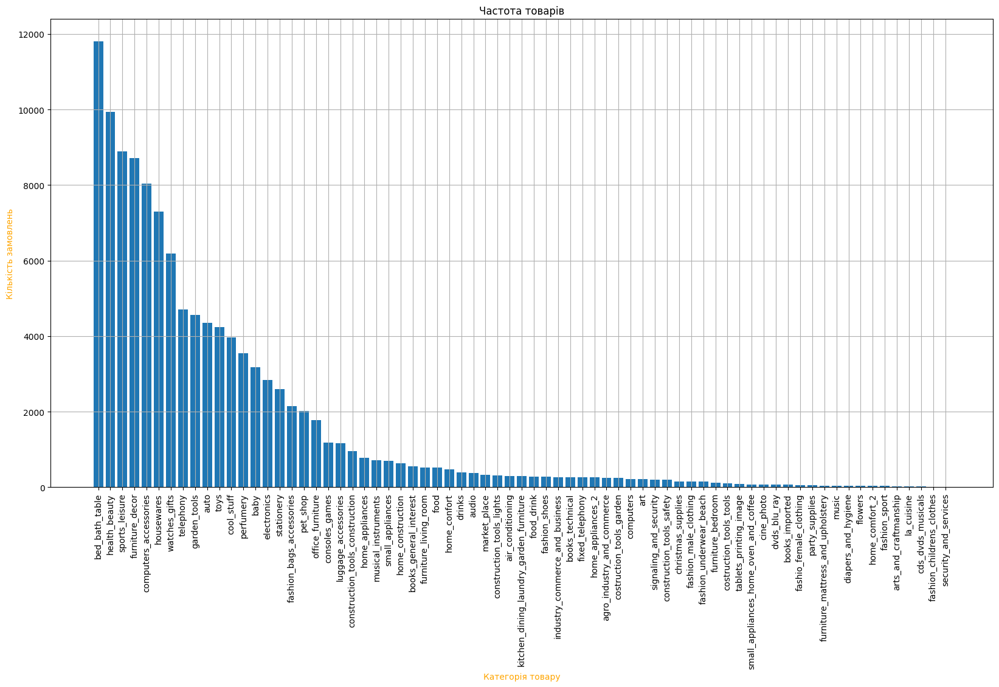

In [31]:
# Візуалізація частоти товарів
plt.figure(figsize=(20, 10))
plt.bar(product_counts.index, product_counts.values)
plt.title("Частота товарів")
plt.xlabel("Категорія товару", color="orange")
plt.ylabel("Кількість замовлень", color="orange")
plt.xticks(rotation=90)
plt.grid()
plt.show()

In [ ]:
product_counts.values

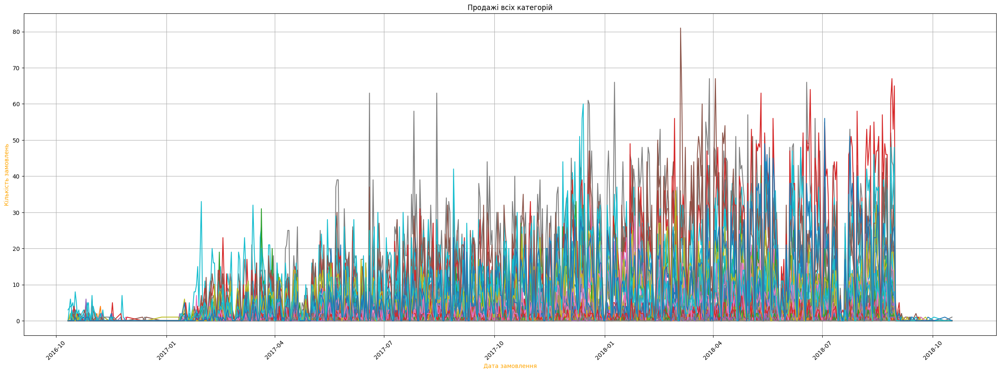

In [59]:
plt.figure(figsize=(30, 10))
for category in data.columns:
  plt.plot(data.index, data[category].values, label=category)

plt.title(f"Продажі всіх категорій")
plt.xlabel("Дата замовлення", color="orange")
plt.ylabel("Кількість замовлень", color="orange")
plt.xticks(rotation=45)
# plt.legend()
plt.grid()
plt.show()

Розглянемо продажі деяких категорій

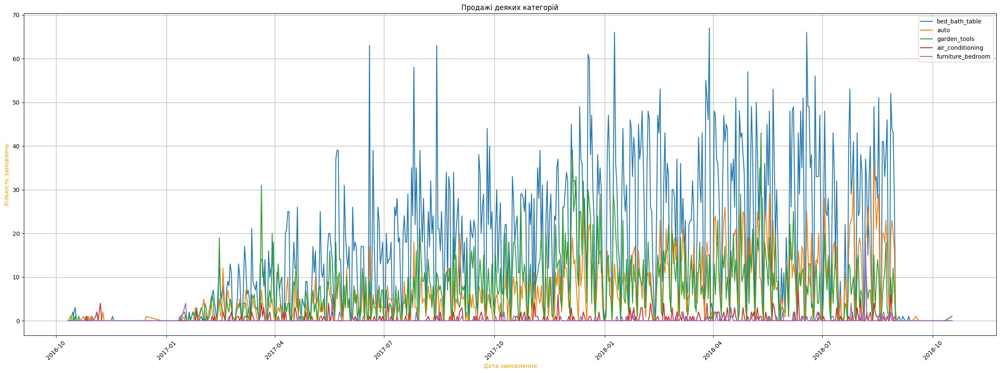

In [55]:
categories = ["bed_bath_table", "auto", "garden_tools", "air_conditioning", "furniture_bedroom"]
# categories = ["furniture_bedroom"]

plt.figure(figsize=(30, 10))
for category in categories:
  plt.plot(data.index, data[category].values, label=category)

plt.title(f"Продажі деяких категорій")
plt.xlabel("Дата замовлення", color="orange")
plt.ylabel("Кількість замовлень", color="orange")
plt.xticks(rotation=45)
plt.legend()
plt.grid()
plt.show()

In [41]:
data.index

Index([2016-10-11, 2016-10-13, 2016-10-14, 2016-10-15, 2016-10-16, 2016-10-17,
       2016-10-18, 2016-10-19, 2016-10-20, 2016-10-21,
       ...
       2018-09-14, 2018-09-17, 2018-09-19, 2018-09-20, 2018-09-21, 2018-09-25,
       2018-09-27, 2018-10-02, 2018-10-11, 2018-10-17],
      dtype='object', name='order_delivered_customer_date', length=644)

In [ ]:
period = data.loc[data.index[400]:data.index[599]]
period

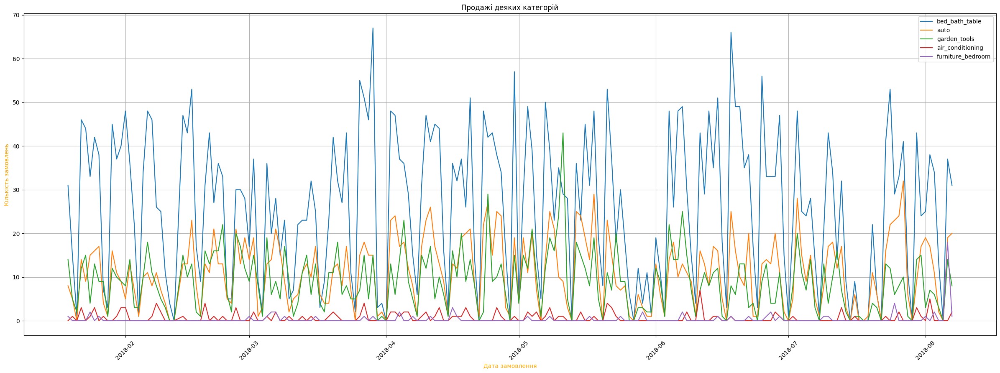

In [56]:
plt.figure(figsize=(30, 10))
for category in categories:
  plt.plot(period.index, period[category].values, label=category)

plt.title(f"Продажі деяких категорій")
plt.xlabel("Дата замовлення", color="orange")
plt.ylabel("Кількість замовлень", color="orange")
plt.xticks(rotation=45)
plt.legend()
plt.grid()
plt.show()

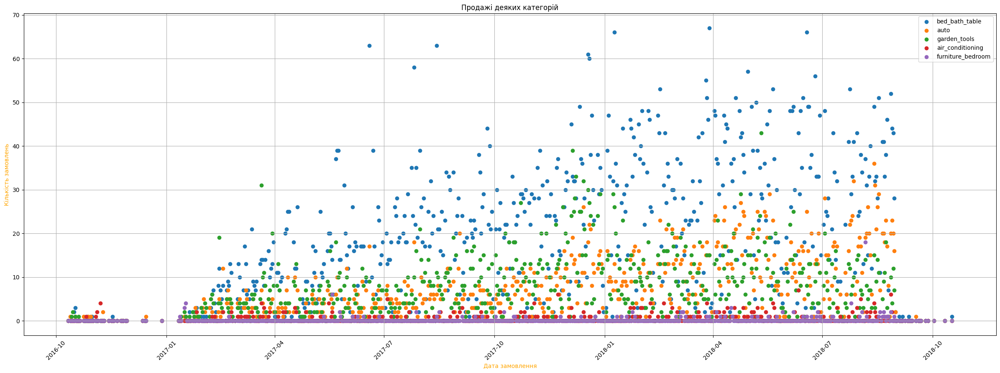

In [71]:
plt.figure(figsize=(30, 10))
for category in categories:
  plt.scatter(data.index, data[category].values, label=category)

plt.title(f"Продажі деяких категорій")
plt.xlabel("Дата замовлення", color="orange")
plt.ylabel("Кількість замовлень", color="orange")
plt.xticks(rotation=45)
plt.legend()
plt.grid()
plt.show()

Для передбачення за допомогою машинного навчання може підійти лінійна регресія з гіперпараметрами, градієнтний бустинг, метод опопрних векторів або випадковий ліс

Також, за графіком зрозуміло, що не вс дані є стаціонарними, деякі категорії потребують диференціювання

## Прогнозування (Класична модель часових рядів ARIMA)

Дана модель потребує статистичності даних (дисперсія та середнє значення не змінюються з часом). Статистичність даних можуть порушити тренд та сезонність товарів. Для вирішення проблеми нестаціонарності даних їх можна продиференціювати.

Також треба визначити порядок моделі ARIMA, тобто параметри (p, d, q), де p - порядок авторегресії (число попередніх значень часового ряду), d - порядок диференціювання (скільки разів треба продиференціювати нестаціонарний ряд для стаціонарності), q - порядок моделі ковзного середнього (число помилок попереднього прогнозування).

Стаціонарність можна визначити за допомогою тесту Дікі-Фуллера, а параметри (p, d, q) за допомогою автокореляційної функції ACF та часткової автокореляції PACF.


In [ ]:
daily_orders.columns = ["date", "category", "amount"]
daily_orders

In [ ]:
data

In [50]:
data.describe()

product_category_name_english,agro_industry_and_commerce,air_conditioning,art,arts_and_craftmanship,audio,auto,baby,bed_bath_table,books_general_interest,books_imported,...,security_and_services,signaling_and_security,small_appliances,small_appliances_home_oven_and_coffee,sports_leisure,stationery,tablets_printing_image,telephony,toys,watches_gifts
count,644.000000,644.000000,644.000000,644.000000,644.000000,644.000000,644.000000,644.000000,644.000000,644.000000,...,644.000000,644.000000,644.000000,644.000000,644.000000,644.000000,644.000000,644.000000,644.000000,644.000000
mean,0.381988,0.456522,0.321429,0.037267,0.586957,6.650621,4.832298,18.090062,0.850932,0.091615,...,0.003106,0.309006,1.055901,0.116460,13.560559,3.981366,0.135093,7.147516,6.498447,9.414596
std,1.397638,0.954471,0.769222,0.226906,1.020879,7.057461,4.929028,16.117800,1.323134,0.351833,...,0.055684,0.888415,1.425161,0.398804,11.902706,4.976738,0.444855,7.014868,6.638288,10.301090
min,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,...,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
25%,0.000000,0.000000,0.000000,0.000000,0.000000,1.000000,0.750000,2.000000,0.000000,0.000000,...,0.000000,0.000000,0.000000,0.000000,2.000000,0.000000,0.000000,1.000000,1.000000,1.000000
50%,0.000000,0.000000,0.000000,0.000000,0.000000,4.500000,3.000000,15.500000,0.000000,0.000000,...,0.000000,0.000000,1.000000,0.000000,11.000000,2.000000,0.000000,6.000000,5.000000,6.000000
75%,0.000000,1.000000,0.000000,0.000000,1.000000,10.250000,8.000000,30.000000,1.000000,0.000000,...,0.000000,0.000000,2.000000,0.000000,22.000000,6.000000,0.000000,12.000000,10.000000,15.000000
max,24.000000,7.000000,6.000000,3.000000,6.000000,36.000000,24.000000,67.000000,7.000000,4.000000,...,1.000000,8.000000,9.000000,3.000000,51.000000,29.000000,3.000000,36.000000,38.000000,56.000000


In [38]:
print(len(daily_orders["category"].unique()))

71


In [29]:
from sklearn.model_selection import train_test_split
from sklearn.metrics import mean_absolute_error
from statsmodels.tsa.arima.model import ARIMA
from statsmodels.graphics.tsaplots import plot_acf, plot_pacf


In [78]:
X_train = data[:int(len(data) * 0.8)]
X_test = data[int(len(data) * 0.8):]
print(data.shape)
print(X_train.shape)
print(X_test.shape)


(644, 71)
(515, 71)
(129, 71)


In [57]:
print(categories)

['bed_bath_table', 'auto', 'garden_tools', 'air_conditioning', 'furniture_bedroom']


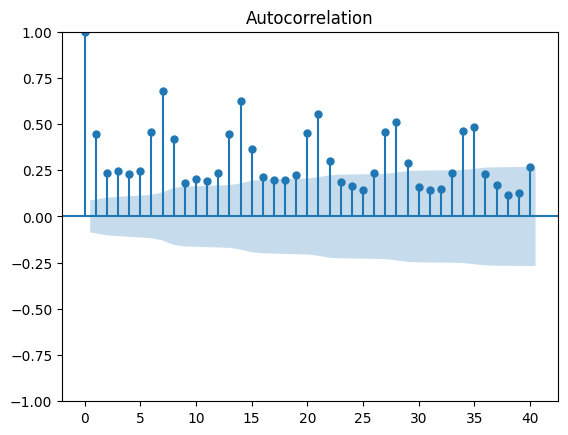

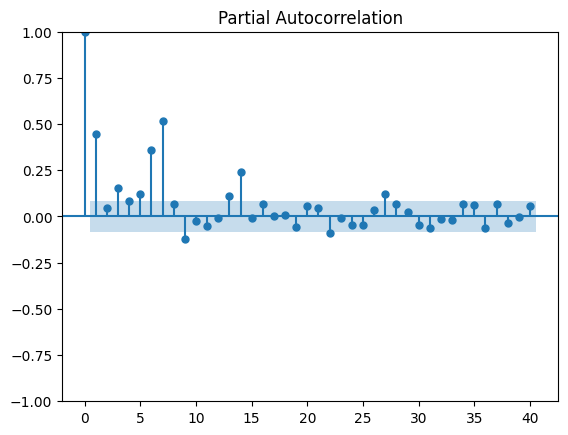

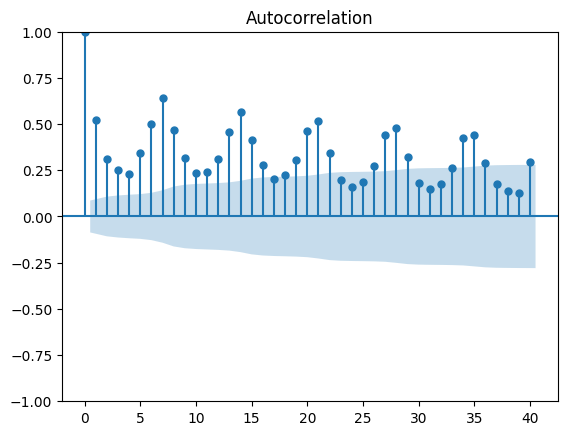

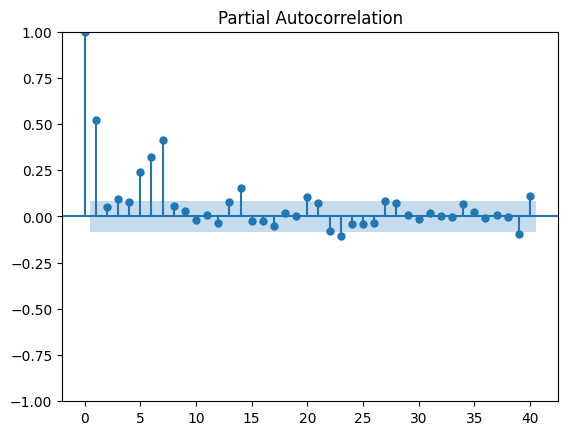

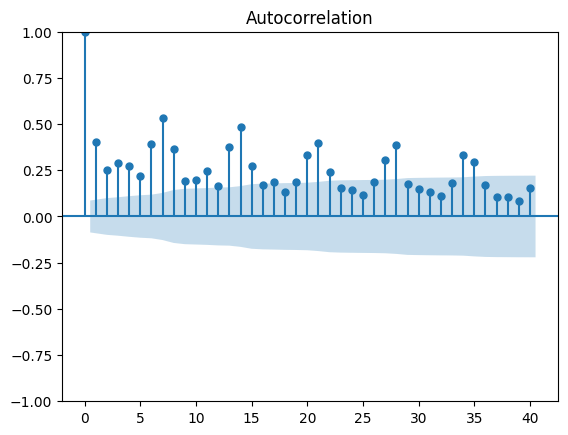

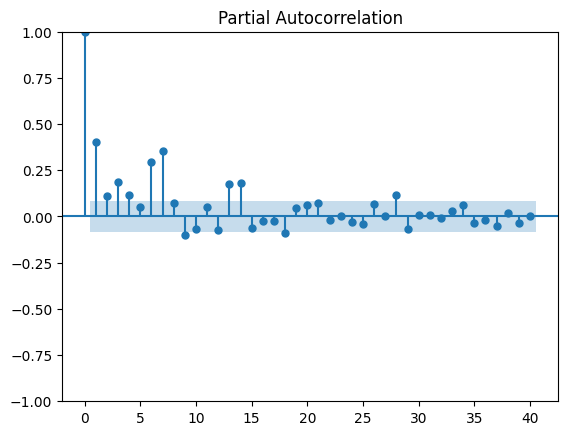

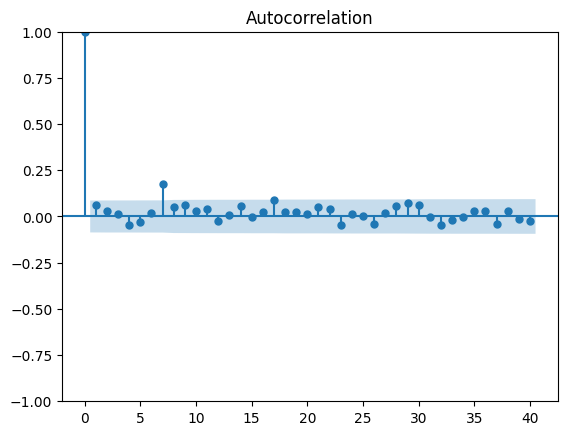

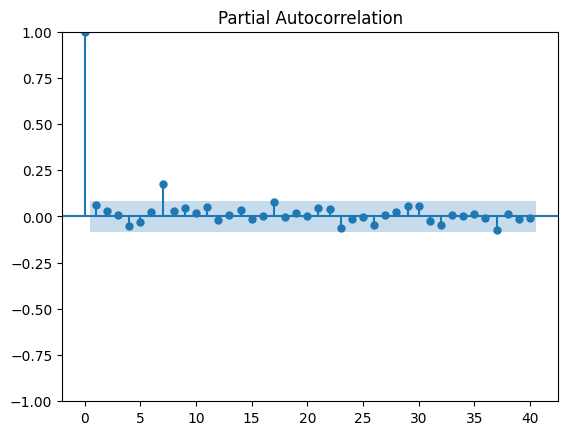

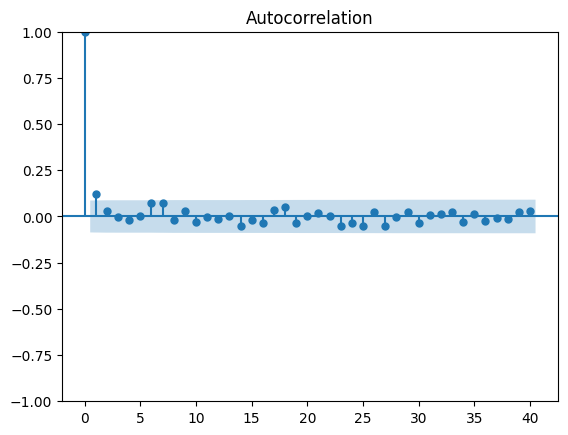

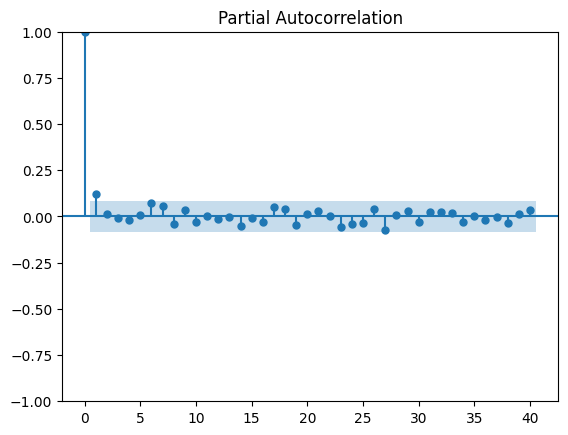

In [79]:
for category in categories:
  plot_acf(X_train[category], lags=40, label=category)
  plot_pacf(X_train[category], lags=40, label=category)

plt.show()

In [80]:
from statsmodels.tsa.stattools import adfuller


# Перевірка на стаціонарність (< 0.05)
for category in categories:
  res = adfuller(X_train[category])
  print(f"{category}:")
  print(f"ADF Statistics: {res[0]}\np-value: {res[1]}\n")


# Деякі значення треба продиференціювати, адже вони є більшими за рівень значущості

bed_bath_table:
ADF Statistics: -1.9093705674697852
p-value: 0.32766582201655237

auto:
ADF Statistics: -1.0662116315158692
p-value: 0.7283565735771577

garden_tools:
ADF Statistics: -1.8774066004217416
p-value: 0.34276325182927203

air_conditioning:
ADF Statistics: -7.1764602567740505
p-value: 2.7192292552551966e-10

furniture_bedroom:
ADF Statistics: -20.02161817165961
p-value: 0.0



In [81]:
data_diff = X_train.diff().dropna()
data_diff

product_category_name_english,agro_industry_and_commerce,air_conditioning,art,arts_and_craftmanship,audio,auto,baby,bed_bath_table,books_general_interest,books_imported,...,security_and_services,signaling_and_security,small_appliances,small_appliances_home_oven_and_coffee,sports_leisure,stationery,tablets_printing_image,telephony,toys,watches_gifts
order_delivered_customer_date,,,,,,,,,,,,,,,,,,,,,
2016-10-13,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0
2016-10-14,0.0,0.0,0.0,0.0,0.0,-1.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,2.0,0.0
2016-10-15,0.0,0.0,0.0,0.0,0.0,0.0,3.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,2.0,0.0,0.0,0.0,-2.0,0.0
2016-10-16,0.0,0.0,0.0,0.0,0.0,0.0,-3.0,2.0,0.0,0.0,...,0.0,0.0,0.0,0.0,-2.0,0.0,0.0,-1.0,0.0,0.0
2016-10-17,0.0,0.0,0.0,0.0,0.0,1.0,0.0,1.0,0.0,0.0,...,0.0,0.0,0.0,0.0,3.0,0.0,0.0,0.0,1.0,1.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2018-05-10,0.0,1.0,0.0,-1.0,0.0,-11.0,-6.0,12.0,1.0,-1.0,...,0.0,2.0,2.0,2.0,7.0,2.0,0.0,-3.0,2.0,-9.0
2018-05-11,1.0,0.0,1.0,0.0,0.0,-1.0,-4.0,-6.0,-2.0,0.0,...,0.0,-2.0,3.0,-1.0,-7.0,-5.0,0.0,2.0,-3.0,9.0
2018-05-12,-1.0,-1.0,1.0,0.0,-1.0,-6.0,-9.0,-1.0,-2.0,0.0,...,0.0,0.0,-5.0,-1.0,-21.0,-1.0,0.0,-12.0,-8.0,-28.0


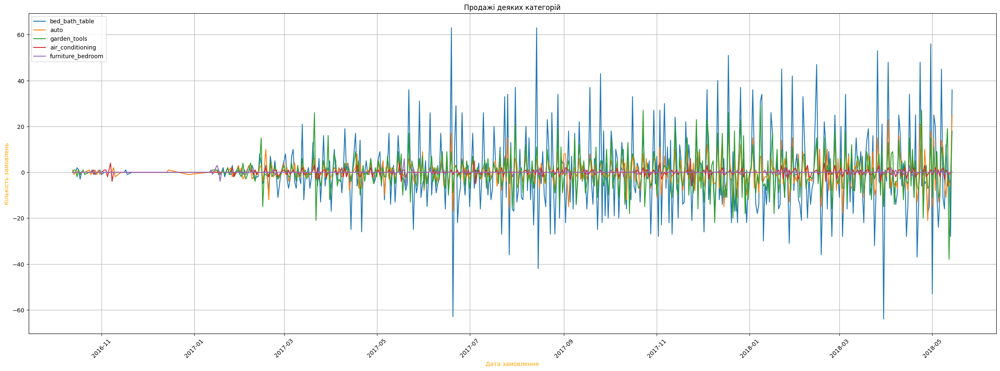

In [82]:
plt.figure(figsize=(30, 10))
for category in categories:
  plt.plot(data_diff.index, data_diff[category].values, label=category)

plt.title(f"Продажі деяких категорій")
plt.xlabel("Дата замовлення", color="orange")
plt.ylabel("Кількість замовлень", color="orange")
plt.xticks(rotation=45)
plt.legend()
plt.grid()
plt.show()

Таким чином, дані виглядають більш стаціонарно

Проте, для моделей треба спробувати дві версії даних

## Прогнозуємо на диференційованих даних

In [ ]:
arima_results = {}

for category in X_train.columns:
  arima_model = ARIMA(X_train[category], order=(2, 1, 0))
  arima_fit = arima_model.fit()
  arima_results[category] = arima_fit

print(arima_results)

In [ ]:

for k, v in arima_results.items():
  residuals = v.resid[1:]
  fig, axs = plt.subplots(1, 2)
  # plt.xticks(rotation=45)
  residuals.plot(title=f"Residuals :{k}: ", ax=axs[0])
  residuals.plot(title="Density", kind="kde", ax=axs[1])
  plt.show()


In [2]:
forecasts = {}

for k, v in arima_results.items():
  forecast_test = v.forecast(len(X_test))
  forecasts[k] = forecast_test


In [110]:
for_df = pd.DataFrame(forecasts)
for_df

,agro_industry_and_commerce,air_conditioning,art,arts_and_craftmanship,audio,auto,baby,bed_bath_table,books_general_interest,books_imported,...,security_and_services,signaling_and_security,small_appliances,small_appliances_home_oven_and_coffee,sports_leisure,stationery,tablets_printing_image,telephony,toys,watches_gifts
515,0.357431,6.924106e-17,1.729026,1.880192e-19,0.797105,17.463836,7.678187,30.532291,1.357740,0.295646,...,0.0,-5.530633e-17,-1.434128e-17,-6.503556e-17,25.733863,4.967582,-3.475700e-67,13.709736,8.793152,30.371696
516,0.450511,2.531384e-17,1.229354,6.293038e-20,0.903157,13.480019,6.612285,20.931917,1.249608,0.417925,...,0.0,-4.721889e-17,-6.367486e-18,-6.005711e-17,20.742682,3.701081,-3.569210e-68,9.545369,7.170183,23.610518
517,0.596204,3.159299e-17,1.640547,8.369911e-20,1.210722,16.761530,7.764024,26.639806,1.860129,0.595110,...,0.0,-3.294972e-17,-7.685959e-18,-4.805455e-17,25.919359,5.298415,1.644680e-67,12.981882,10.037746,32.308894
518,0.472818,4.130676e-17,1.545414,1.114313e-19,0.992998,16.704353,7.534469,27.468540,1.562219,0.424597,...,0.0,-4.546316e-17,-8.683922e-18,-5.770650e-17,25.284663,4.982235,-9.324731e-68,13.112642,9.171199,30.529122
519,0.505507,3.318599e-17,1.467929,8.608258e-20,1.028998,15.871444,7.375437,25.255525,1.520341,0.478460,...,0.0,-4.210860e-17,-7.842999e-18,-5.600768e-17,24.209911,4.595572,9.883850e-69,11.977616,8.640026,28.652890
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
639,0.509584,3.557796e-17,1.522418,9.412919e-20,1.047032,16.190562,7.467158,26.036900,1.593090,0.481188,...,0.0,-4.161481e-17,-8.087423e-18,-5.506321e-17,24.719654,4.825679,3.638551e-69,12.405333,9.038523,29.768018
640,0.509584,3.557796e-17,1.522418,9.412919e-20,1.047032,16.190562,7.467158,26.036900,1.593090,0.481188,...,0.0,-4.161481e-17,-8.087423e-18,-5.506321e-17,24.719654,4.825679,3.638551e-69,12.405333,9.038523,29.768018
641,0.509584,3.557796e-17,1.522418,9.412919e-20,1.047032,16.190562,7.467158,26.036900,1.593090,0.481188,...,0.0,-4.161481e-17,-8.087423e-18,-5.506321e-17,24.719654,4.825679,3.638551e-69,12.405333,9.038523,29.768018
642,0.509584,3.557796e-17,1.522418,9.412919e-20,1.047032,16.190562,7.467158,26.036900,1.593090,0.481188,...,0.0,-4.161481e-17,-8.087423e-18,-5.506321e-17,24.719654,4.825679,3.638551e-69,12.405333,9.038523,29.768018


In [118]:
for k, v in forecasts.items():
  arima_mae = mean_absolute_error(X_test[k], v)
  print(f"MAE for {k}: {arima_mae}")

MAE for agro_industry_and_commerce: 0.7117169089783296
MAE for air_conditioning: 0.5116279069767442
MAE for art: 1.2848494647338917
MAE for arts_and_craftmanship: 0.15503875968992248
MAE for audio: 0.938705887596238
MAE for auto: 9.407033866567536
MAE for baby: 5.710647996906259
MAE for bed_bath_table: 16.789792951666982
MAE for books_general_interest: 1.2869478977564441
MAE for books_imported: 0.530888029838814
MAE for books_technical: 1.0089622635563744
MAE for cds_dvds_musicals: 3.711380543245765e-20
MAE for christmas_supplies: 0.5547036354948444
MAE for cine_photo: 0.5946221486957889
MAE for computers: 1.4125121187010257
MAE for computers_accessories: 11.85138945044613
MAE for consoles_games: 3.44741368545748
MAE for construction_tools_construction: 3.3756977543259725
MAE for construction_tools_lights: 1.6046511627906976
MAE for construction_tools_safety: 1.7064493394337825
MAE for cool_stuff: 6.863977718742814
MAE for costruction_tools_garden: 0.7190360389770284
MAE for costructio

Бачимо, що є дуже низькі помилки, що є гарним показником, а є і дуже великі помилки, що свідчить про велику неточність прогнозу

## Прогнозуємо на вихідних даних

In [ ]:
arima_results = {}

for category in X_train.columns:
  arima_model = ARIMA(X_train[category], order=(2, 0, 0))
  arima_fit = arima_model.fit()
  arima_results[category] = arima_fit


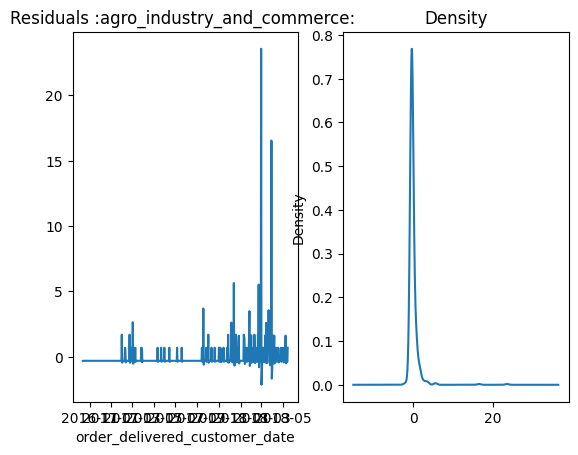

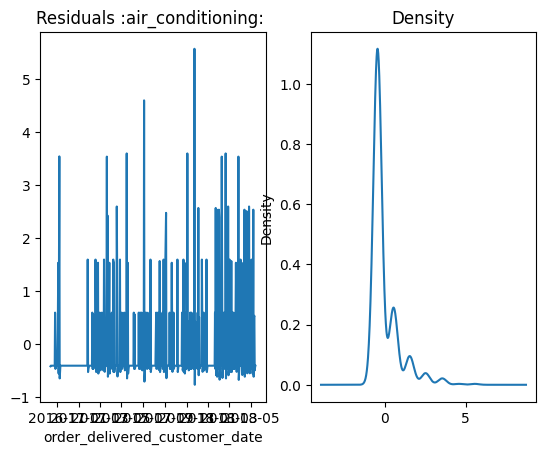

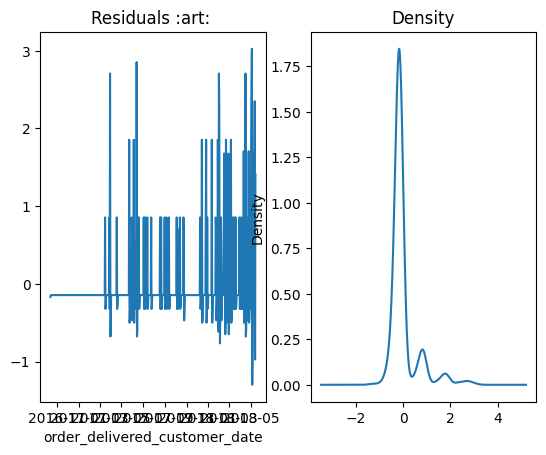

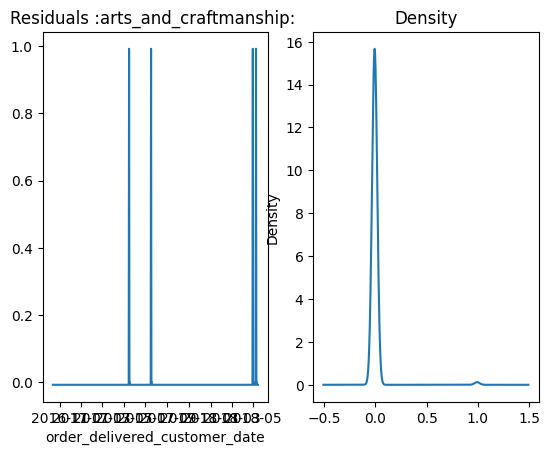

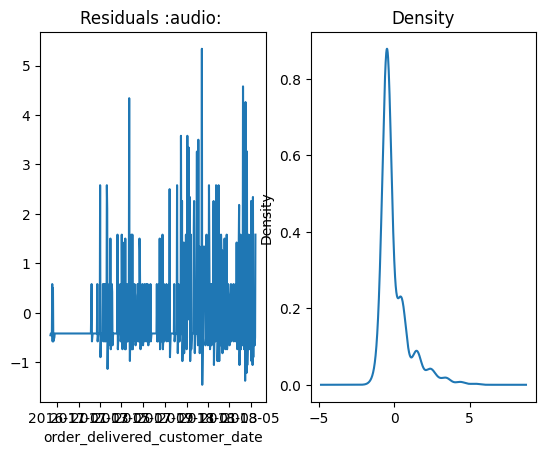

...

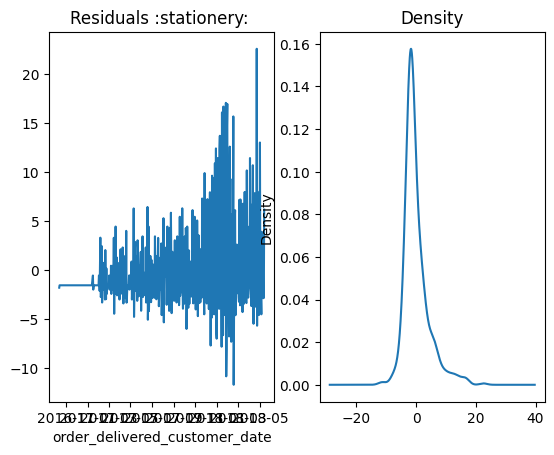

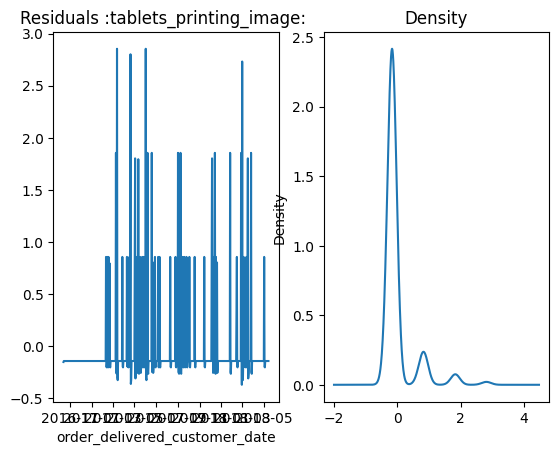

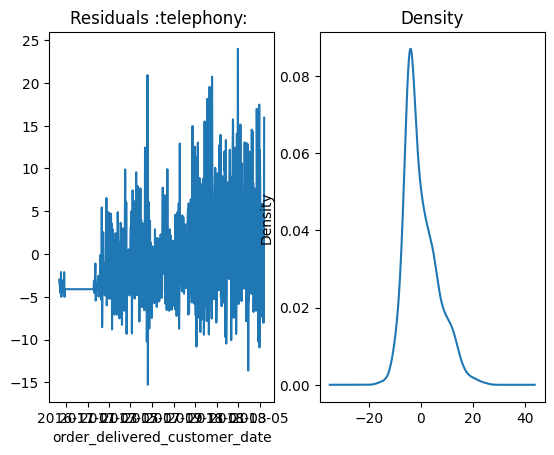

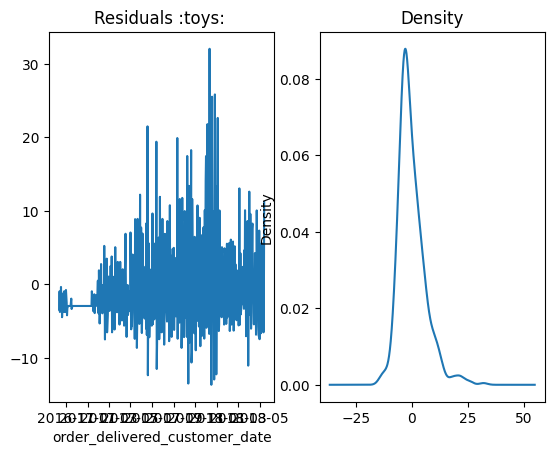

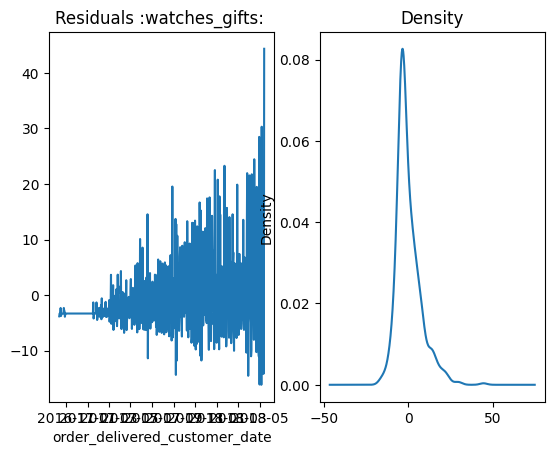

In [120]:

for k, v in arima_results.items():
  residuals = v.resid[1:]
  fig, axs = plt.subplots(1, 2)
  # plt.xticks(rotation=45)
  residuals.plot(title=f"Residuals :{k}: ", ax=axs[0])
  residuals.plot(title="Density", kind="kde", ax=axs[1])
  plt.show()


In [ ]:
forecasts = {}

for k, v in arima_results.items():
  forecast_test = v.forecast(len(X_test))
  forecasts[k] = forecast_test

In [122]:
for_df = pd.DataFrame(forecasts)
for_df

,agro_industry_and_commerce,air_conditioning,art,arts_and_craftmanship,audio,auto,baby,bed_bath_table,books_general_interest,books_imported,...,security_and_services,signaling_and_security,small_appliances,small_appliances_home_oven_and_coffee,sports_leisure,stationery,tablets_printing_image,telephony,toys,watches_gifts
515,0.387611,0.403698,0.500597,0.007888,0.739410,15.366607,6.748459,24.476779,1.205821,0.038470,...,0.003911,0.189163,0.782341,0.046507,24.774146,5.097737,0.146085,13.051052,9.282821,25.281066
516,0.391011,0.427898,0.529420,0.007825,0.696632,11.462434,5.830857,21.132069,0.901729,0.063801,...,0.003896,0.202560,0.904914,0.053178,20.324622,4.893418,0.153819,9.405638,8.999368,21.139096
517,0.361274,0.440545,0.313029,0.007763,0.589800,9.077695,5.114735,19.191270,0.814458,0.062022,...,0.003881,0.216040,0.979131,0.057979,17.372995,4.414712,0.163173,7.964330,8.038736,16.141955
518,0.359228,0.441974,0.278805,0.007764,0.569336,7.701445,4.743549,18.212623,0.792683,0.062096,...,0.003881,0.217882,0.999378,0.059219,15.709428,4.176836,0.164142,7.418726,7.601952,13.353860
519,0.357619,0.442411,0.240749,0.007765,0.557591,6.901858,4.532347,17.707918,0.787074,0.062092,...,0.003881,0.218906,1.007768,0.059794,14.745625,4.008096,0.164766,7.213846,7.280551,11.442582
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
639,0.357279,0.442496,0.214881,0.007765,0.551767,5.795168,4.266599,17.174298,0.785146,0.062093,...,0.003881,0.219210,1.012074,0.060095,13.432141,3.706234,0.164913,7.090976,6.727391,7.916422
640,0.357279,0.442496,0.214881,0.007765,0.551767,5.795168,4.266599,17.174298,0.785146,0.062093,...,0.003881,0.219210,1.012074,0.060095,13.432141,3.706234,0.164913,7.090976,6.727391,7.916422
641,0.357279,0.442496,0.214881,0.007765,0.551767,5.795168,4.266599,17.174298,0.785146,0.062093,...,0.003881,0.219210,1.012074,0.060095,13.432141,3.706234,0.164913,7.090976,6.727391,7.916422
642,0.357279,0.442496,0.214881,0.007765,0.551767,5.795168,4.266599,17.174298,0.785146,0.062093,...,0.003881,0.219210,1.012074,0.060095,13.432141,3.706234,0.164913,7.090976,6.727391,7.916422


In [123]:
for k, v in forecasts.items():
  arima_mae = mean_absolute_error(X_test[k], v)
  print(f"MAE for {k}: {arima_mae}")

MAE for agro_industry_and_commerce: 0.6444810929319854
MAE for air_conditioning: 0.741627296181252
MAE for art: 0.7957440303319572
MAE for arts_and_craftmanship: 0.16087865072525384
MAE for audio: 0.8241087832292118
MAE for auto: 8.126015257664676
MAE for baby: 5.842987068271123
MAE for bed_bath_table: 16.46660343898434
MAE for books_general_interest: 1.0814140636491345
MAE for books_imported: 0.25100943837729994
MAE for books_technical: 0.9376449996497821
MAE for cds_dvds_musicals: 0.02708230918407488
MAE for christmas_supplies: 0.38369231454017233
MAE for cine_photo: 0.3806738296564465
MAE for computers: 0.5712081770193237
MAE for computers_accessories: 10.447459654052743
MAE for consoles_games: 1.8010813656581615
MAE for construction_tools_construction: 3.741287337254999
MAE for construction_tools_lights: 1.598141122529149
MAE for construction_tools_safety: 0.6744244621753377
MAE for cool_stuff: 4.229580627660891
MAE for costruction_tools_garden: 0.660633101834985
MAE for costructio

Можна звірити і побачити, що загалом похибки стали меншими, що є гарним показником

Можливо, є сенс вибрати деякі категорії та окремо продиференціювати їхні значення

## Прогноз на останні 21 день

В цьому блоці створимо функцію для можливості розрахувати прогноз на майбутній період

Для цього датасету використаємо останні 21 день в якості тесту

In [63]:
from sklearn.metrics import mean_squared_error


print(data.shape)

(644, 71)


In [61]:
X_train = data[:len(data) - 21]
X_test = data[len(data) - 21:]

print(X_train.shape)
print(X_test.shape)

(623, 71)
(21, 71)


In [110]:
def make_forecast(forecast_period):
  X_train = data[:len(data) - forecast_period]
  X_test = data[len(data) - forecast_period:]

  results = {}
  forecasts = {}

  for category in data.columns:
    model = ARIMA(X_train[category], order=(2, 0, 0))  # Параметри p та q можна пробувати змінювати
    model_fit = model.fit()

    # Прогноз
    forecast = model_fit.forecast(steps=forecast_period)

    # Похибка (MAE, MSE)
    mae = mean_absolute_error(X_test[category], forecast)
    mse = mean_squared_error(X_test[category], forecast)

    results[category] = f"mae: {mae}; mse: {mse}"
    forecasts[category] = forecast

  return results, forecasts

Прогнозуємо

In [ ]:
result, forecast = make_forecast(21)

In [112]:
for k, v in result.items():
  print(f"{k}:\n{v}\n")

agro_industry_and_commerce:
mae: 0.39823060988050296; mse: 0.15868005029166854

air_conditioning:
mae: 0.4713258871426648; mse: 0.22216756094111748

art:
mae: 0.3468013199687307; mse: 0.12308432724682851

arts_and_craftmanship:
mae: 0.07822378198762374; mse: 0.01441390503851948

audio:
mae: 0.6732049295893517; mse: 0.48820706372370004

auto:
mae: 7.236927966910143; mse: 53.1702265271332

baby:
mae: 5.509372478457901; mse: 31.58780603119314

bed_bath_table:
mae: 18.831418316579068; mse: 355.32259937365916

books_general_interest:
mae: 0.906700846901573; mse: 0.8315609909068057

books_imported:
mae: 0.09425421926627953; mse: 0.008885557267399228

books_technical:
mae: 0.441030167517825; mse: 0.19685324520031258

cds_dvds_musicals:
mae: 0.02211844296694753; mse: 0.0004901050311391174

christmas_supplies:
mae: 0.24073182182171857; mse: 0.05802865314753851

cine_photo:
mae: 0.13830826766717078; mse: 0.0255709849023281

computers:
mae: 0.35613395382523827; mse: 0.12814707139164033

computers

Оцінка MAE підходить краще для прогнозування за допомогою моделі ARIMA

In [ ]:
for k, v in forecast.items():
  print(f"{k}:\n{v}\n")

## Візуалізація

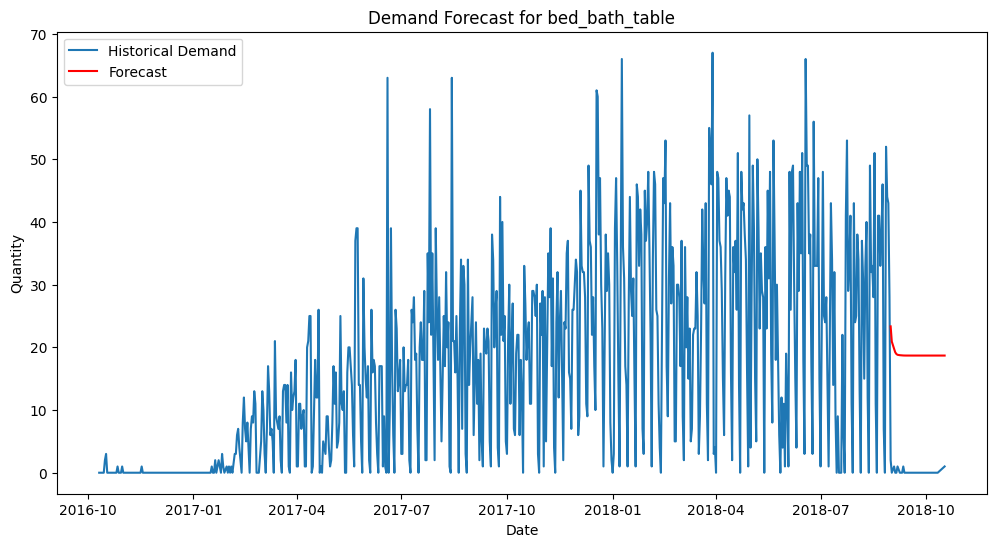

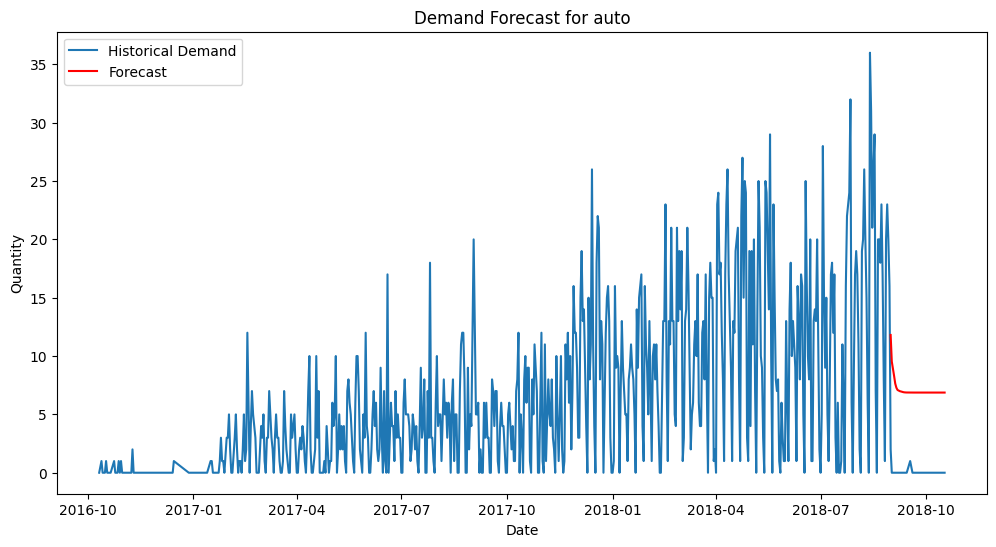

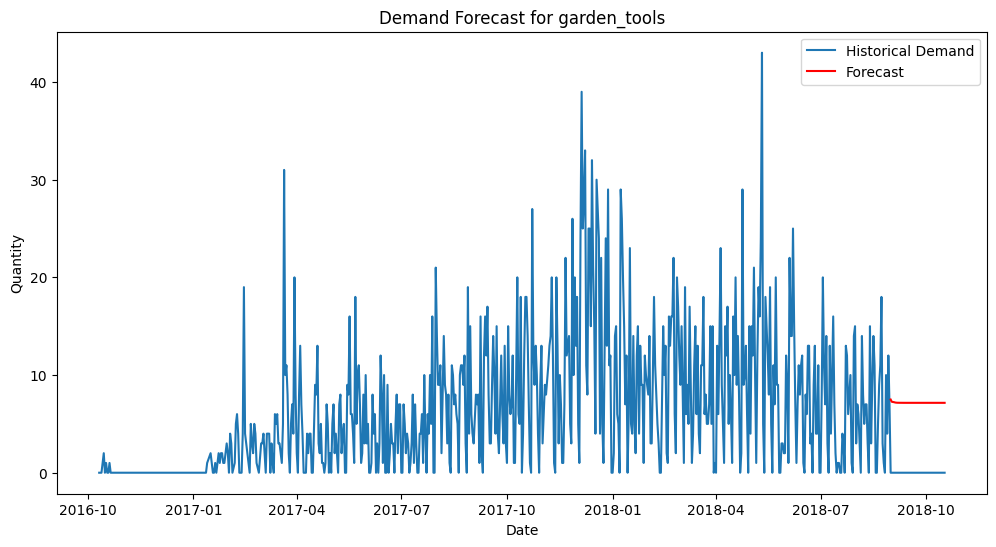

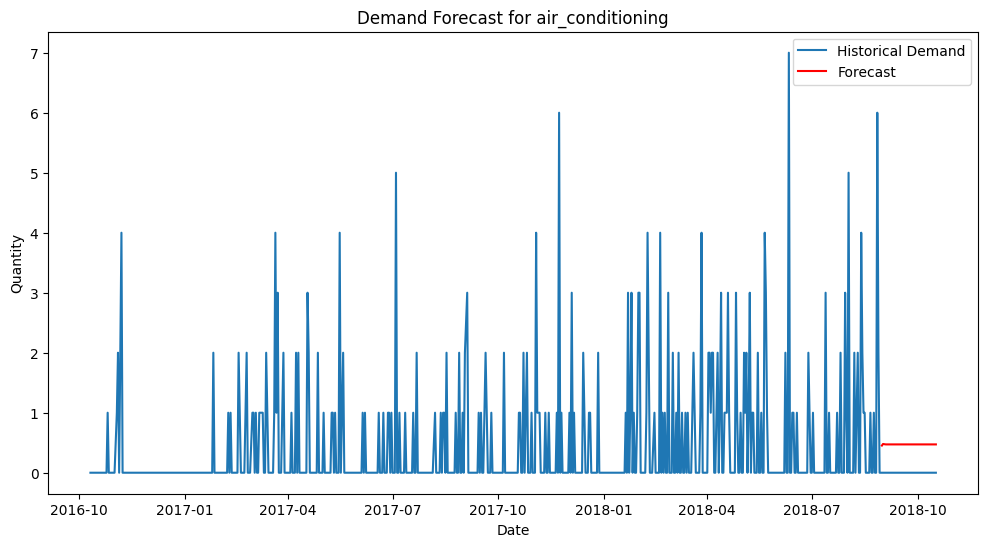

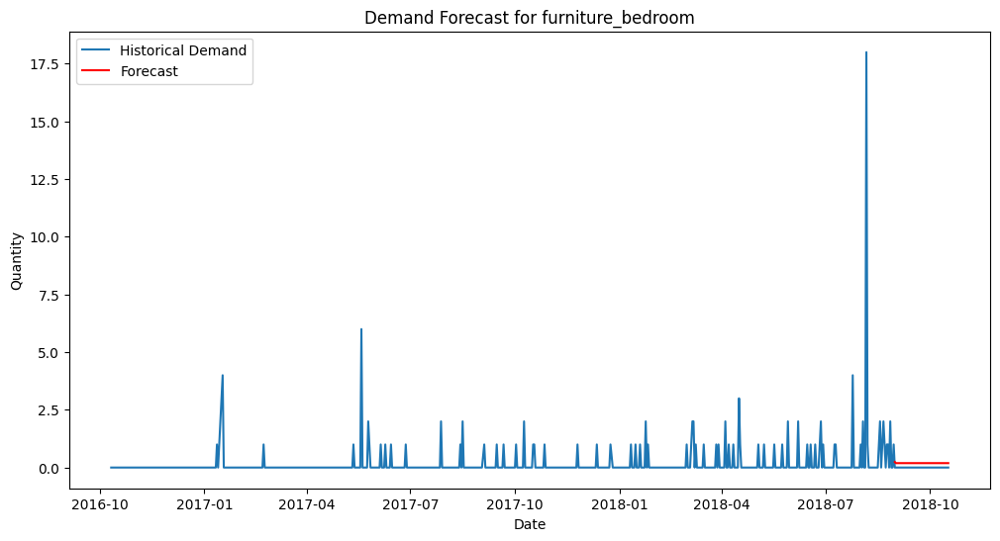

In [113]:

for category in categories:
  plt.figure(figsize=(12, 6))
  plt.plot(data.index, data[category], label="Historical Demand")
  plt.plot(X_test.index, forecast[category], label="Forecast", color="red")
  plt.title(f"Demand Forecast for {category}")
  plt.xlabel("Date")
  plt.ylabel("Quantity")
  plt.legend()
  plt.show()


Бачимо, що модель ARIMA прогнозує досить непогано: похибка є, але не на багато значень, а в більшості (згідно оцінкам MAE) похибка є мінімальною

Покращити прогноз можна багатьма способами:

1) Підбирання параметрів p, d, q (хоча, для більшості категорій модель працює непогано, тож сильного покращення для всієї вибірки можна не очікувати)

2) Диференціювання або логарифмування окремих значень категорій (цей варіант більше підійде, для усунення великих кореляцій)

3) Більш детальний та глибший аналіз кожної з категорій: сезонність, тенденція (хоча за налізом данних великої різниці між сезонами не було)

## Прогноз на 14 днів від останньої дати і тиждень (21)

Для цього треба трохи переписати функцію

За X_train взяти всю вибірку

In [121]:
def make_forecast(forecast_period):

  forecasts = {}

  for category in data.columns:
    model = ARIMA(data[category], order=(2, 0, 0))  # Параметри p та q можна пробувати змінювати
    model_fit = model.fit()

    # Прогноз
    forecast = model_fit.forecast(steps=forecast_period)

    forecasts[category] = forecast

  return forecasts

In [ ]:
forecast = make_forecast(21)

In [123]:
data.index.max()

datetime.date(2018, 10, 17)

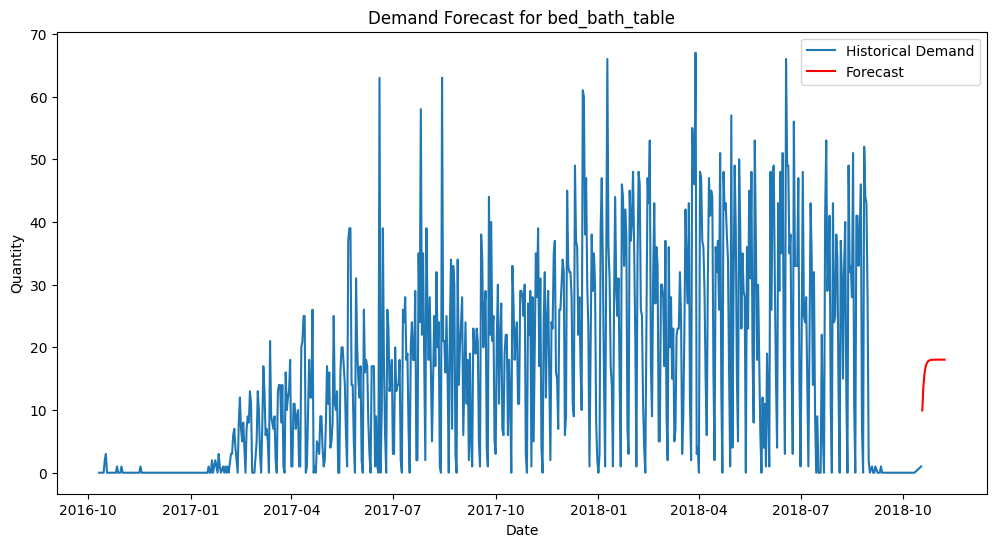

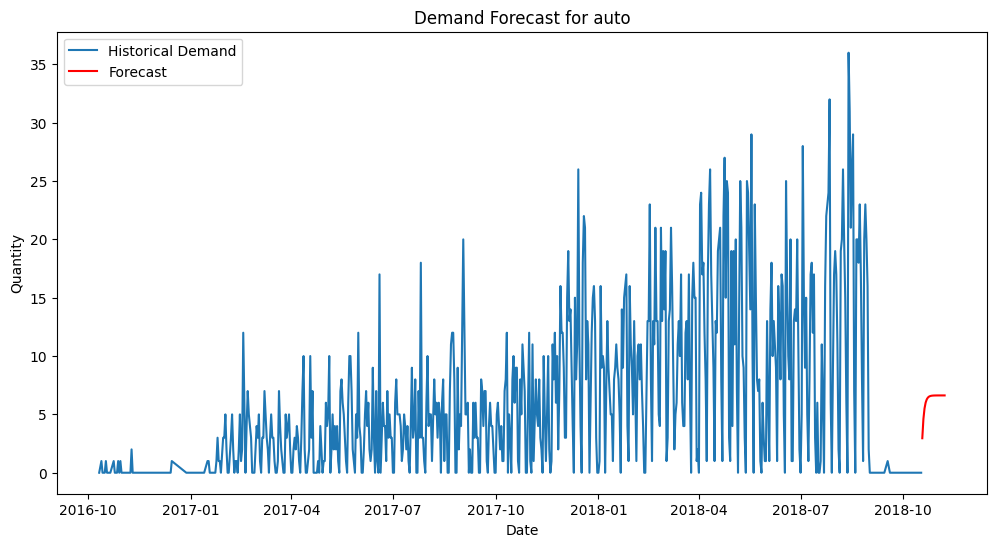

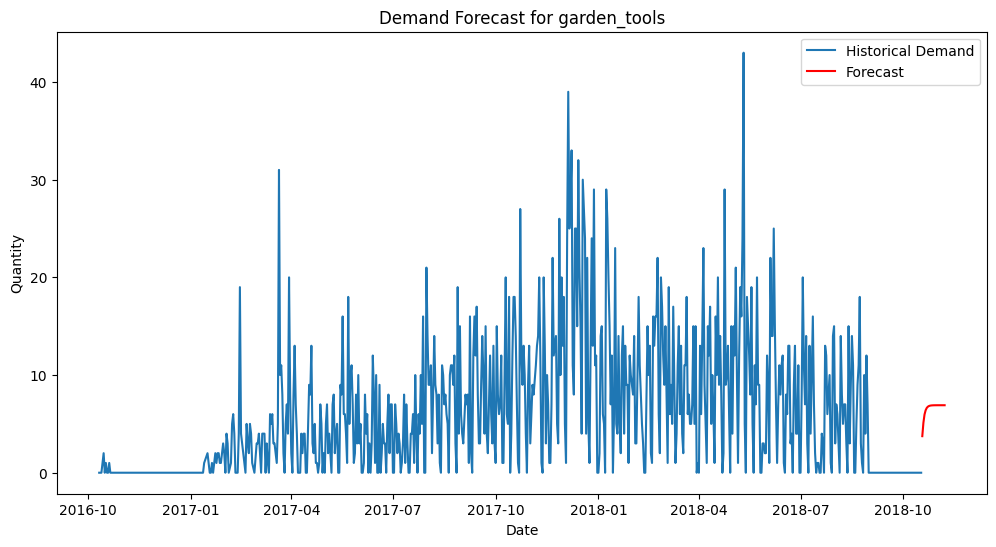

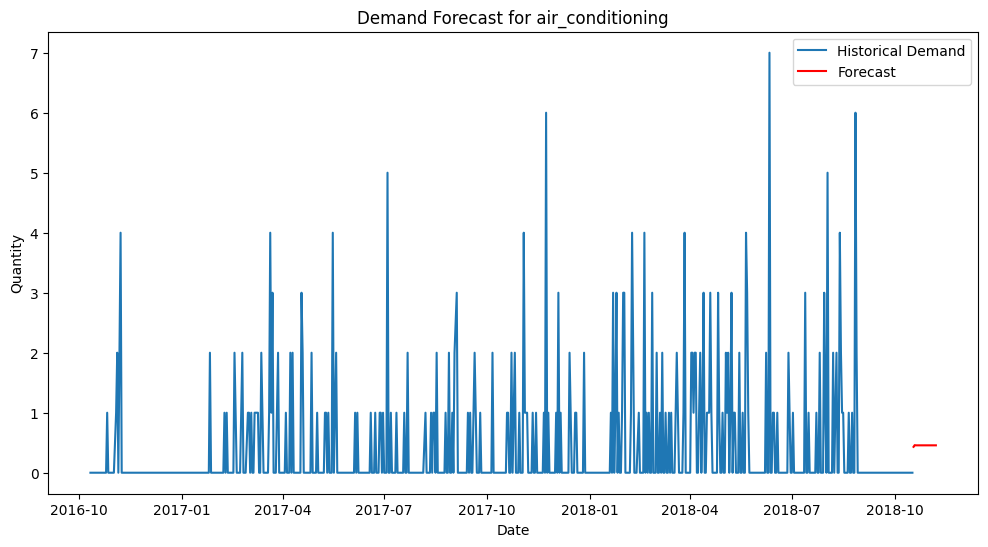

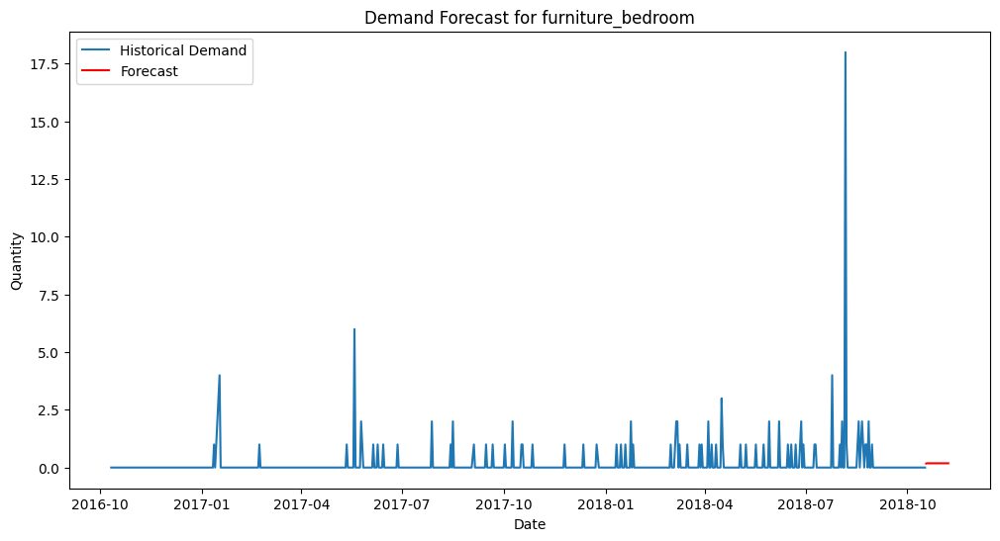

In [128]:

for category in categories:
  plt.figure(figsize=(12, 6))
  plt.plot(data.index, data[category], label="Historical Demand")

  future_period = pd.date_range(data.index.max() + pd.Timedelta(days=1), periods=21, freq="D")

  plt.plot(future_period, forecast[category], label="Forecast", color="red")
  plt.title(f"Demand Forecast for {category}")
  plt.xlabel("Date")
  plt.ylabel("Quantity")
  plt.legend()
  plt.show()


## Візуалізація для кожної категорії

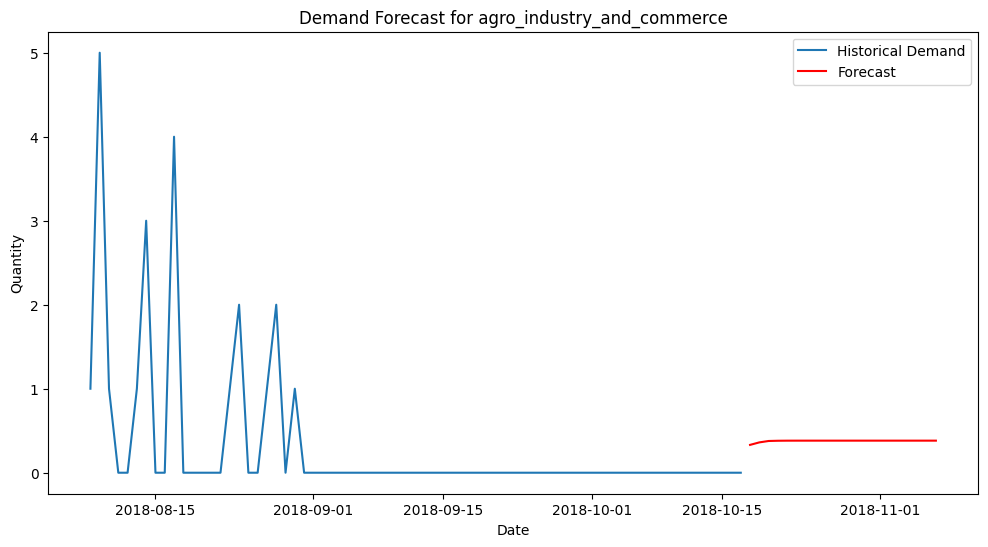

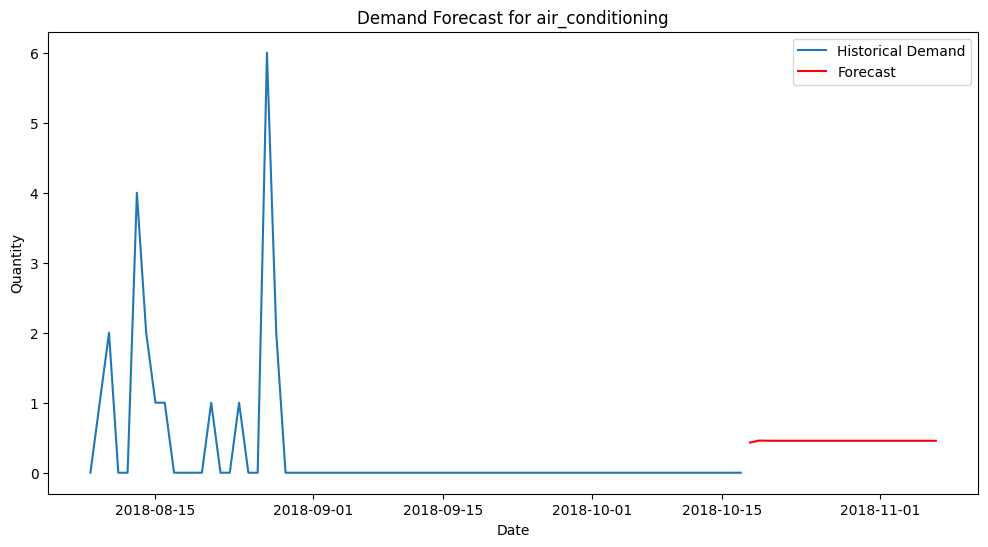

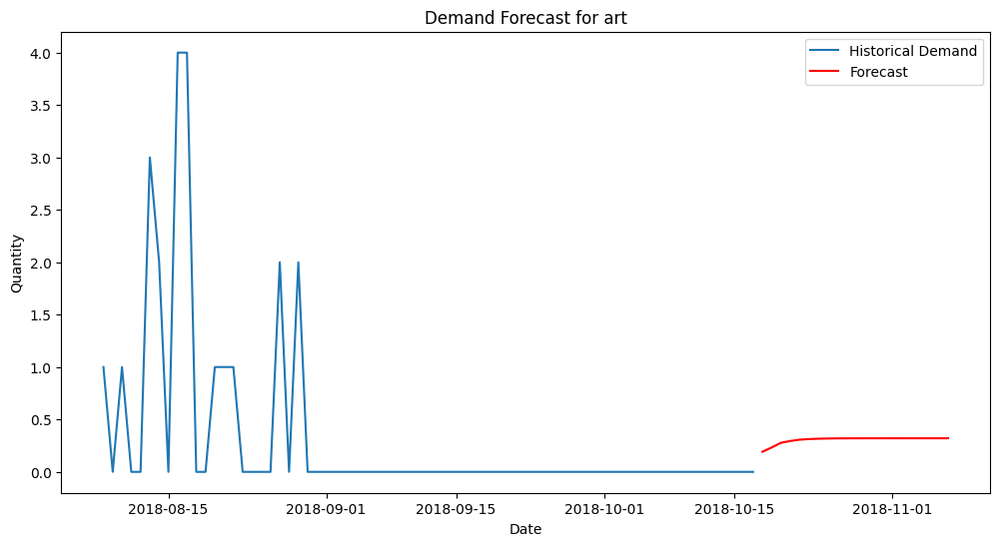

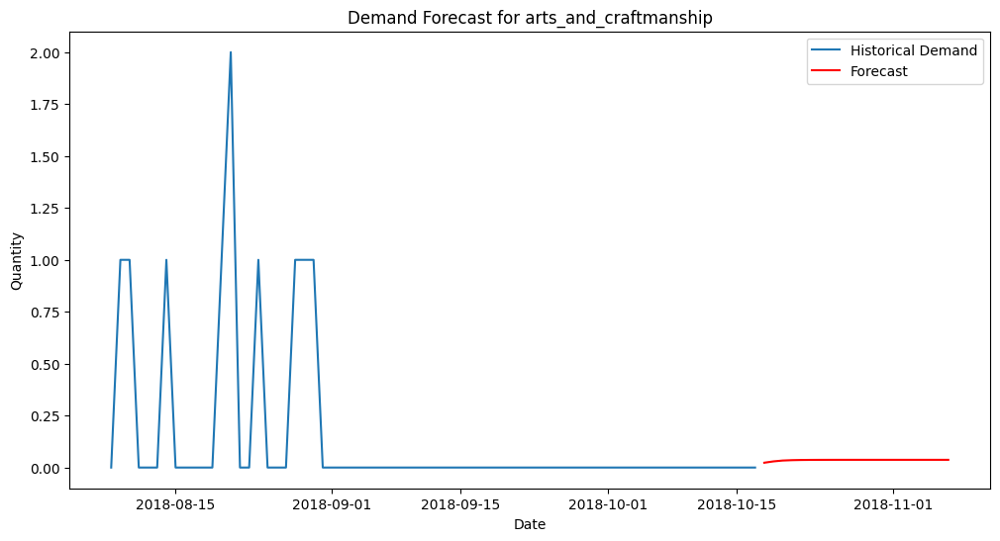

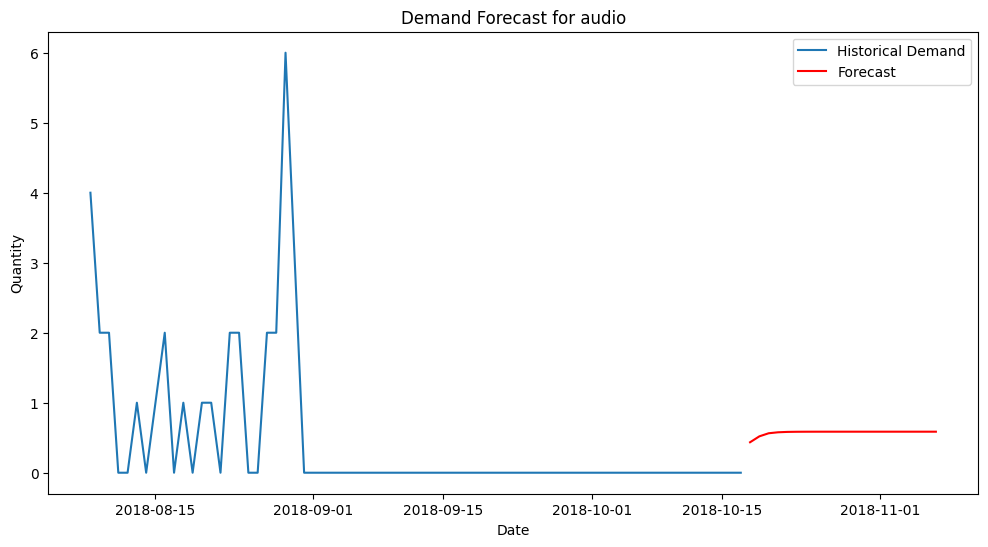

...

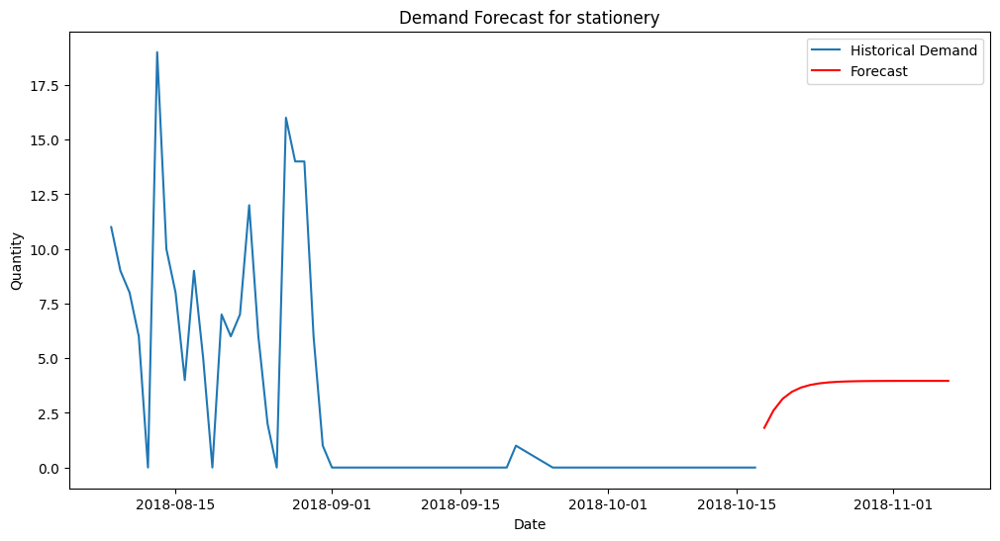

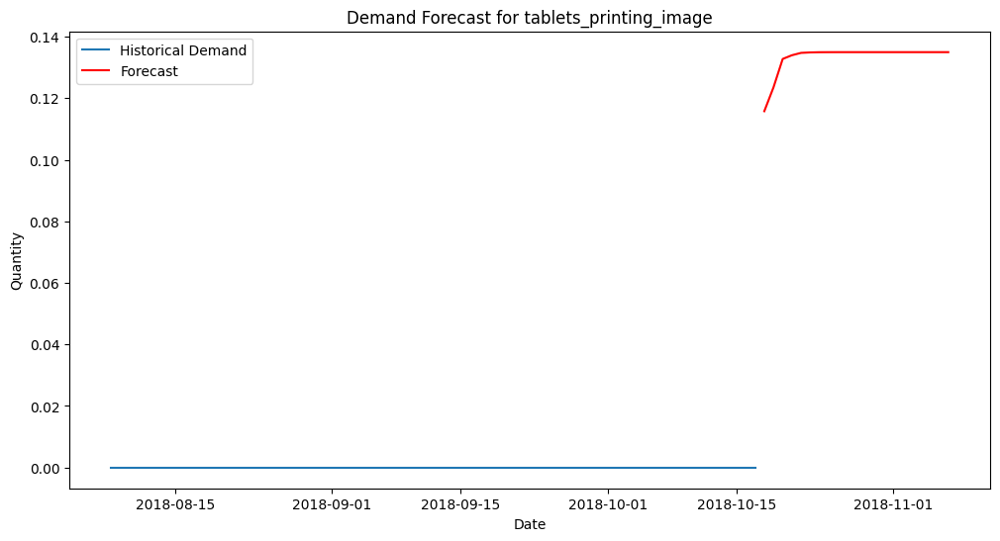

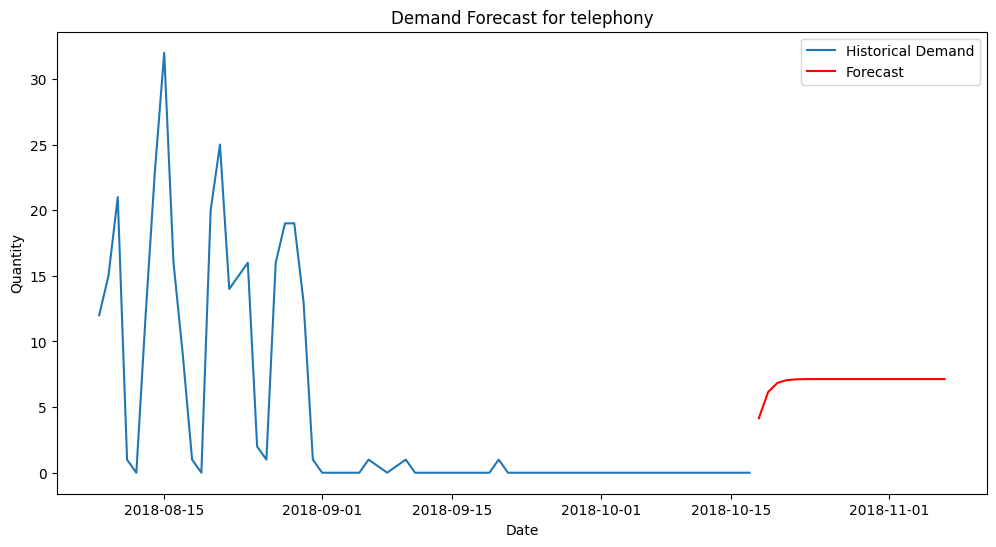

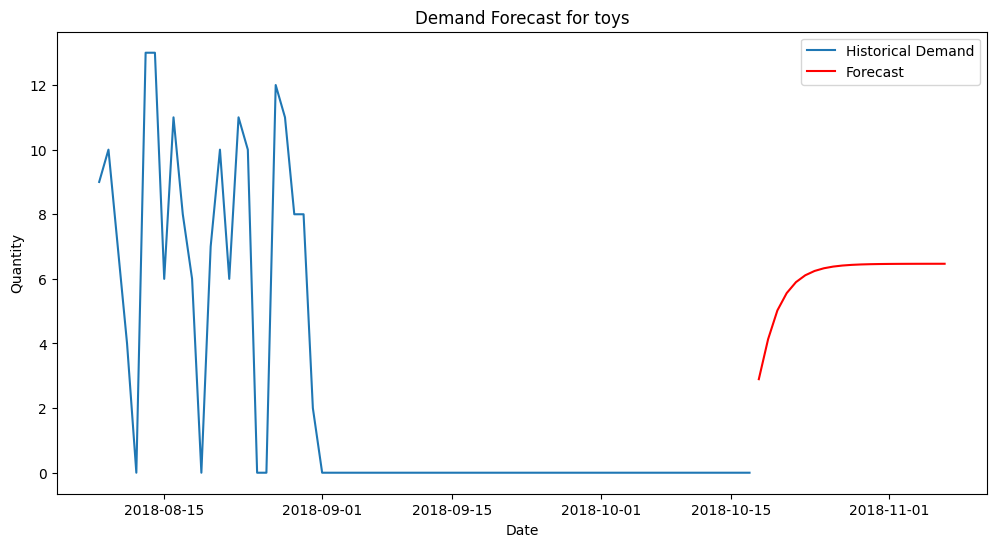

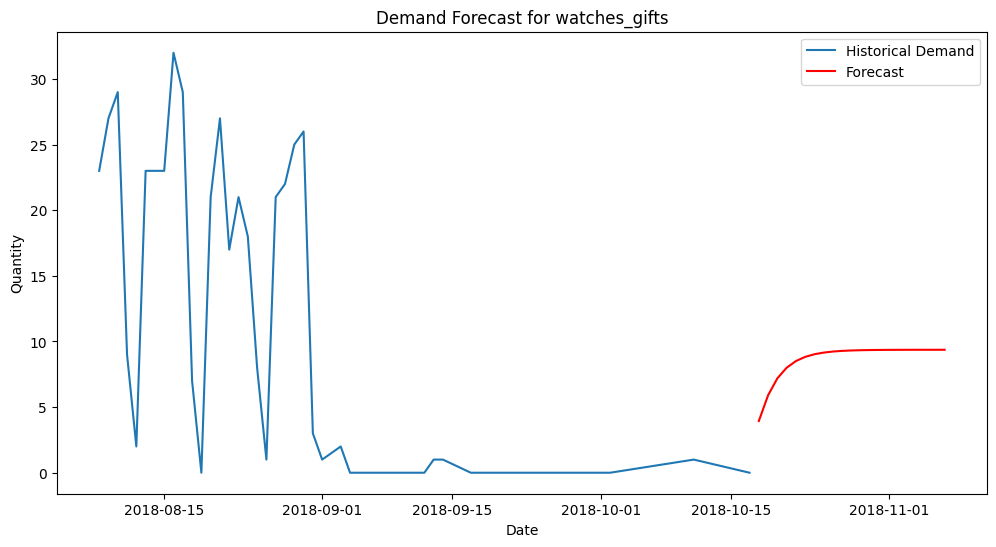

In [129]:

for category in data.columns:
  plt.figure(figsize=(12, 6))
  plt.plot(data.index[600:], data[category][600:], label="Historical Demand")

  future_period = pd.date_range(data.index.max() + pd.Timedelta(days=1), periods=21, freq="D")

  plt.plot(future_period, forecast[category], label="Forecast", color="red")
  plt.title(f"Demand Forecast for {category}")
  plt.xlabel("Date")
  plt.ylabel("Quantity")
  plt.legend()
  plt.show()


## Прогнозування моделями машинного навчання

Виходячи з аналізу даних можна обрати досить багато моделей класичного машинного навчання а також нейронні мережі.

В нашому випадку найкращими моделями будуть Random Forest / GBM (Gradient Boosting Machine): (XGBoost / LightGBM / CatBoost).

* **Random Forest** -- ансамблевий метод машинного навчання для класифікації, регресії та інших завдань, який працює за допомогою побудови численних дерев рішень (decision trees) під час тренування моделі й продукує моду для класів (класифікацій) або усереднений прогноз (регресія) побудованих дерев. Недоліком є схильність до перенавчання.

**Дерево рішень** - це алгоритм машинного навчання, який використовує деревоподібну структуру для розбиття набору даних на менші підмножини. Кожен вузол у дереві представляє один з атрибутів/ознак даних, за якими можна розділити набір даних на дві або більше підмножини.

* **GBM** -- ансамблевий метод машинного навчання для багатьох задач машинного навчання. Він використовує градієнтний спуск для оптимізації функції втрат. Може бути гарним інструментом для прогнозування цін і попиту, кредитного скорингу та оцінки ризиків.


Найефективніші оцінки для них: **MSE**, **RMSE**

Для можливості вибору або покращення результату розробимо дві моделі: Random Forest та Gradient Boosting Machine.

Для передбачення попиту і кількості продаж товару для машинного навчання до основної таблиці можна додати більше фіч, такі як день тижня, сезон, місяць, рік, геолокацію покупця, оцінка з order_review, тощо.

Варто відмітити, що додавання великої кількості нелінійних фіч може призвести до перенавчання.

Спочатку побачимо, як моделі прогнозують всередині вибірки на історичних продажах, а потім побудуємо прогноз на 21 день вперед (можливо із додаванням нових фіч)

## Random Forest

In [32]:
from sklearn.ensemble import RandomForestRegressor

In [ ]:
data

In [46]:
data_t = data.T
data_t

order_delivered_customer_date,2016-10-11,2016-10-13,2016-10-14,2016-10-15,2016-10-16,2016-10-17,2016-10-18,2016-10-19,2016-10-20,2016-10-21,...,2018-09-14,2018-09-17,2018-09-19,2018-09-20,2018-09-21,2018-09-25,2018-09-27,2018-10-02,2018-10-11,2018-10-17
product_category_name_english,,,,,,,,,,,,,,,,,,,,,
agro_industry_and_commerce,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
air_conditioning,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
art,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
arts_and_craftmanship,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
audio,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,1.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
stationery,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0
tablets_printing_image,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
telephony,0.0,1.0,1.0,1.0,0.0,0.0,2.0,0.0,1.0,0.0,...,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0


Спробуємо передбачити кількість продажів на останні 7 днів дани, щоб оцінити, як поводяться моделі. Далі обрати найкращу, і оцінити, чи треба додавати нові ознаки.

In [56]:
X = data_t[data_t.columns[:-7]]  # Колонки до (строго) 2018-09-20
y = data_t[data_t.columns[-7:-6]]  # Колонка за 2018-09-20

print(f"X: {X.shape}, y: {y.shape}")

X: (71, 637), y: (71, 1)


Ми транспортували основну таблицю з даними (кількість продажів кожної категорії зв певний день) так, щоб індексами стали категорії, а кількість продажів - ознаками для передбачення цільових значень на наступний день.

Навчання буде проходити ітеративно: передбачимо значення для кожної категорії на тиждень вперед

In [ ]:
rf_res = {}
rf_err = {}

for i in range(7):
  X = data_t[data_t.columns[:-8 + i]]
  y = data_t[data_t.columns[-8 + i:-7 + i]]

  X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=42)

  rf_model = RandomForestRegressor()
  rf_model.fit(X_train, y_train)
  rf_pred = rf_model.predict(X_test)

  rf_mse = mean_squared_error(y_test, rf_pred)

  rf_res[f"{data_t.columns[-8 + i:-7 + i][0]}"] = rf_pred
  rf_err[f"mse_{i}"] = rf_mse

rf_df = pd.DataFrame(rf_res)


In [ ]:
print(rf_err)

In [103]:
rf_df

,2018-09-19,mse_0,2018-09-20,mse_1,2018-09-21,mse_2,2018-09-25,mse_3,2018-09-27,mse_4,2018-10-02,mse_5,2018-10-11,mse_6
0,0.00,0.0048,0.00,0.000807,0.00,0.000867,0.04,0.00124,0.00,0.000127,0.00,0.000167,0.00,0.001127
1,0.00,0.0048,0.00,0.000807,0.00,0.000867,0.00,0.00124,0.00,0.000127,0.00,0.000167,0.00,0.001127
2,0.12,0.0048,0.11,0.000807,0.11,0.000867,0.08,0.00124,0.02,0.000127,0.05,0.000167,0.13,0.001127
3,0.00,0.0048,0.00,0.000807,0.00,0.000867,0.00,0.00124,0.00,0.000127,0.00,0.000167,0.00,0.001127
4,0.00,0.0048,0.00,0.000807,0.00,0.000867,0.00,0.00124,0.00,0.000127,0.00,0.000167,0.00,0.001127
5,0.00,0.0048,0.00,0.000807,0.00,0.000867,0.00,0.00124,0.03,0.000127,0.00,0.000167,0.00,0.001127
6,0.00,0.0048,0.00,0.000807,0.00,0.000867,0.09,0.00124,0.00,0.000127,0.00,0.000167,0.00,0.001127
7,0.00,0.0048,0.00,0.000807,0.00,0.000867,0.00,0.00124,0.00,0.000127,0.00,0.000167,0.00,0.001127
8,0.00,0.0048,0.00,0.000807,0.00,0.000867,0.00,0.00124,0.00,0.000127,0.00,0.000167,0.00,0.001127
9,0.00,0.0048,0.00,0.000807,0.00,0.000867,0.00,0.00124,0.00,0.000127,0.00,0.000167,0.00,0.001127


## GBR (Gradient Boosting Regressor)

In [89]:
from sklearn.ensemble import GradientBoostingRegressor

In [ ]:
gbr_res = {}
gbr_err = {}

for i in range(7):
  X = data_t[data_t.columns[:-8 + i]]
  y = data_t[data_t.columns[-8 + i:-7 + i]]

  X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=42)

  gbr_model = GradientBoostingRegressor()
  gbr_model.fit(X_train, y_train)
  gbr_pred = gbr_model.predict(X_test)

  gbr_mse = mean_squared_error(y_test, gbr_pred)

  gbr_res[f"{data_t.columns[-8 + i:-7 + i][0]}"] = gbr_pred
  gbr_err[f"mse_{i}"] = gbr_mse

gbr_df = pd.DataFrame(gbr_res)

In [ ]:
print(gbr_err)

In [105]:
gbr_df

,2018-09-19,mse_0,2018-09-20,mse_1,2018-09-21,mse_2,2018-09-25,mse_3,2018-09-27,mse_4,2018-10-02,mse_5,2018-10-11,mse_6
0,0.000001,0.066663,4.743107e-07,2.249706e-13,9.486214e-07,8.998825e-13,4.743107e-07,0.004904,4.743107e-07,2.249706e-13,4.743107e-07,0.000068,4.743107e-07,2.249706e-13
1,0.000001,0.066663,4.743107e-07,2.249706e-13,9.486214e-07,8.998825e-13,4.743107e-07,0.004904,4.743107e-07,2.249706e-13,4.743107e-07,0.000068,4.743107e-07,2.249706e-13
2,0.000001,0.066663,4.743107e-07,2.249706e-13,9.486214e-07,8.998825e-13,4.743107e-07,0.004904,4.743107e-07,2.249706e-13,3.185789e-02,0.000068,4.743107e-07,2.249706e-13
3,0.000001,0.066663,4.743107e-07,2.249706e-13,9.486214e-07,8.998825e-13,4.743107e-07,0.004904,4.743107e-07,2.249706e-13,4.743107e-07,0.000068,4.743107e-07,2.249706e-13
4,0.000001,0.066663,4.743107e-07,2.249706e-13,9.486214e-07,8.998825e-13,4.743107e-07,0.004904,4.743107e-07,2.249706e-13,4.743107e-07,0.000068,4.743107e-07,2.249706e-13
5,0.000001,0.066663,4.743107e-07,2.249706e-13,9.486214e-07,8.998825e-13,4.743107e-07,0.004904,4.743107e-07,2.249706e-13,4.743107e-07,0.000068,4.743107e-07,2.249706e-13
6,0.000001,0.066663,4.743107e-07,2.249706e-13,9.486214e-07,8.998825e-13,2.712230e-01,0.004904,4.743107e-07,2.249706e-13,4.743107e-07,0.000068,4.743107e-07,2.249706e-13
7,0.000001,0.066663,4.743107e-07,2.249706e-13,9.486214e-07,8.998825e-13,4.743107e-07,0.004904,4.743107e-07,2.249706e-13,4.743107e-07,0.000068,4.743107e-07,2.249706e-13
8,0.000001,0.066663,4.743107e-07,2.249706e-13,9.486214e-07,8.998825e-13,4.743107e-07,0.004904,4.743107e-07,2.249706e-13,4.743107e-07,0.000068,4.743107e-07,2.249706e-13
9,0.000001,0.066663,4.743107e-07,2.249706e-13,9.486214e-07,8.998825e-13,4.743107e-07,0.004904,4.743107e-07,2.249706e-13,4.743107e-07,0.000068,4.743107e-07,2.249706e-13


Можна побачити, що градієнтний бустинг з історичними даними справляється досить дивно

## Візуалізація передбачення Random Forest

In [141]:
rf_df = rf_df.set_index(data_t.index[-15:])

In [179]:
rf_df

product_category_name_english,musical_instruments,office_furniture,party_supplies,perfumery,pet_shop,security_and_services,signaling_and_security,small_appliances,small_appliances_home_oven_and_coffee,sports_leisure,stationery,tablets_printing_image,telephony,toys,watches_gifts
2018-09-19,0.00,0.0,0.16,0.0,0.0,0.00,0.00,0.0,0.0,0.0,0.0,0.0,0.0,0.27,0.0
2018-09-20,0.00,0.0,0.14,0.0,0.0,0.00,0.00,0.0,0.0,0.0,0.0,0.0,0.0,0.00,0.0
2018-09-21,0.00,0.0,0.04,0.0,0.0,0.00,0.00,0.0,0.0,0.0,0.0,0.0,0.0,0.00,0.0
2018-09-25,0.04,0.0,0.09,0.0,0.0,0.00,0.07,0.0,0.0,0.0,0.0,0.0,0.0,0.05,0.0
2018-09-27,0.00,0.0,0.03,0.0,0.0,0.05,0.00,0.0,0.0,0.0,0.0,0.0,0.0,0.02,0.0
2018-10-02,0.00,0.0,0.10,0.0,0.0,0.00,0.00,0.0,0.0,0.0,0.0,0.0,0.0,0.01,0.0
2018-10-11,0.00,0.0,0.09,0.0,0.0,0.00,0.00,0.0,0.0,0.0,0.0,0.0,0.0,0.02,0.0


In [ ]:
data_t

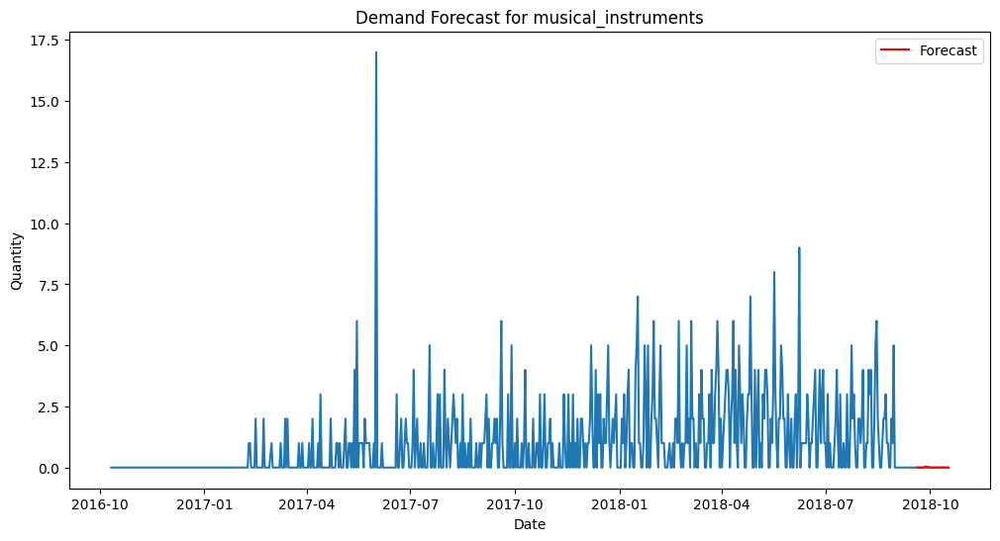

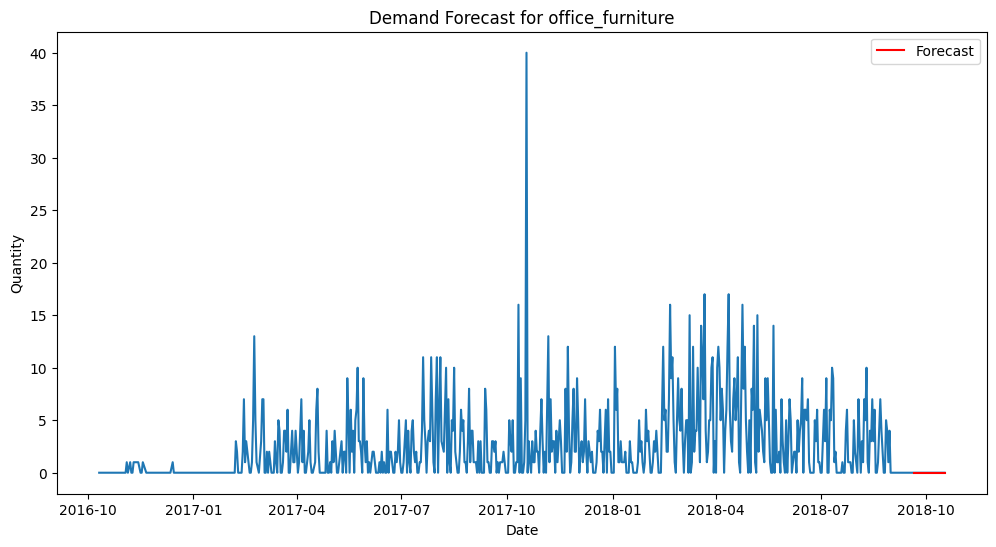

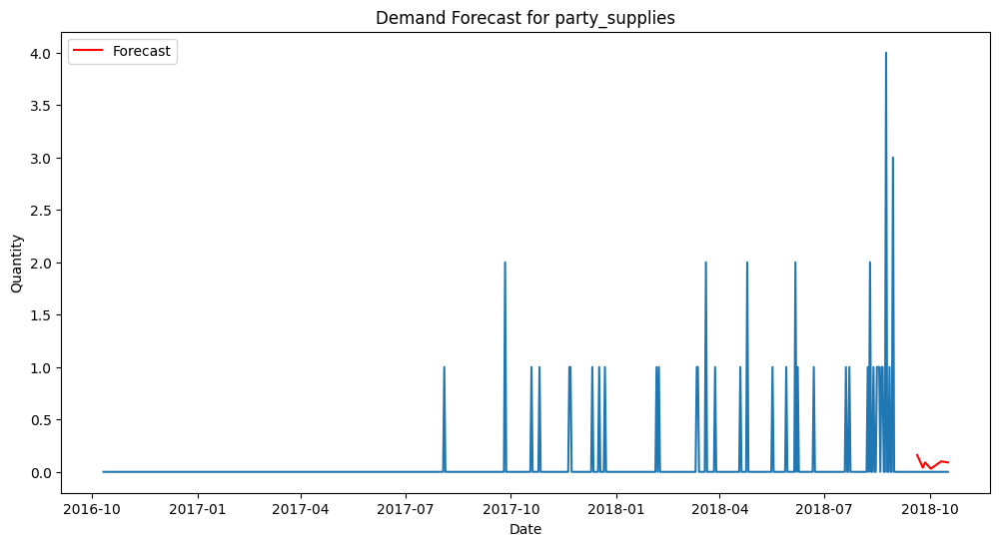

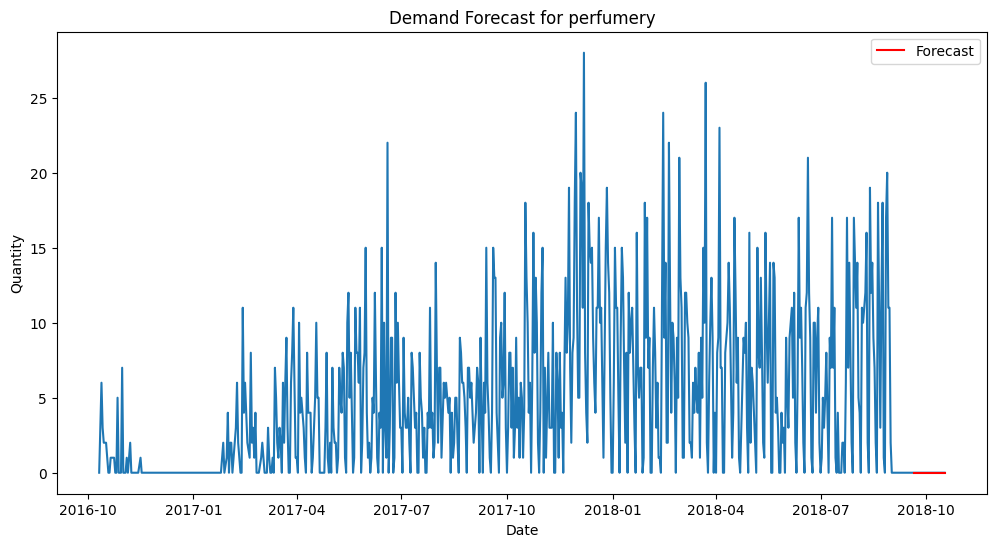

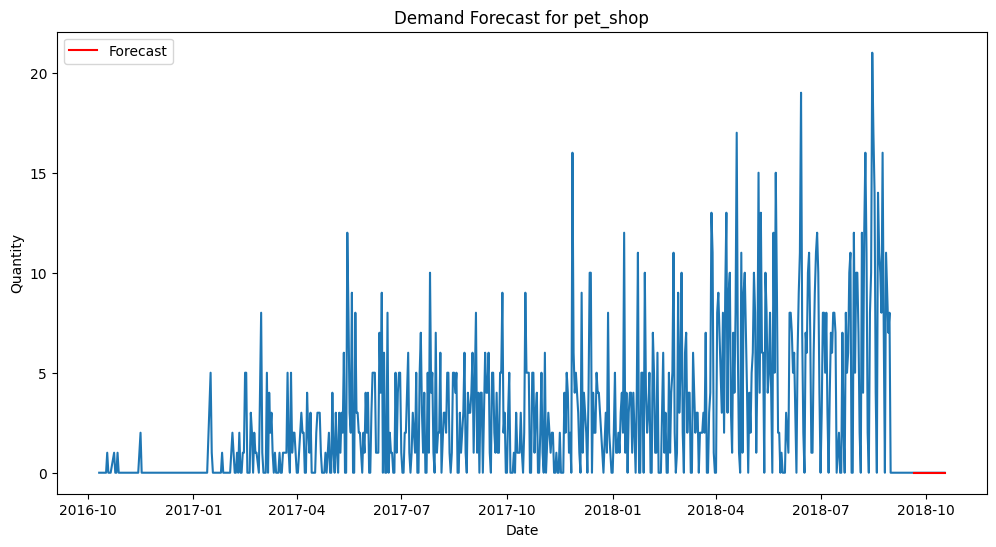

...

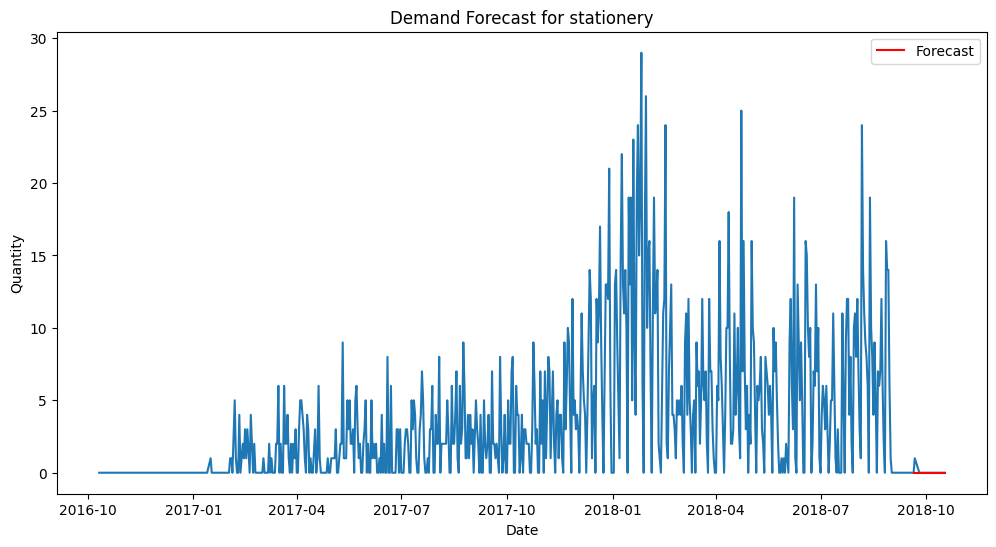

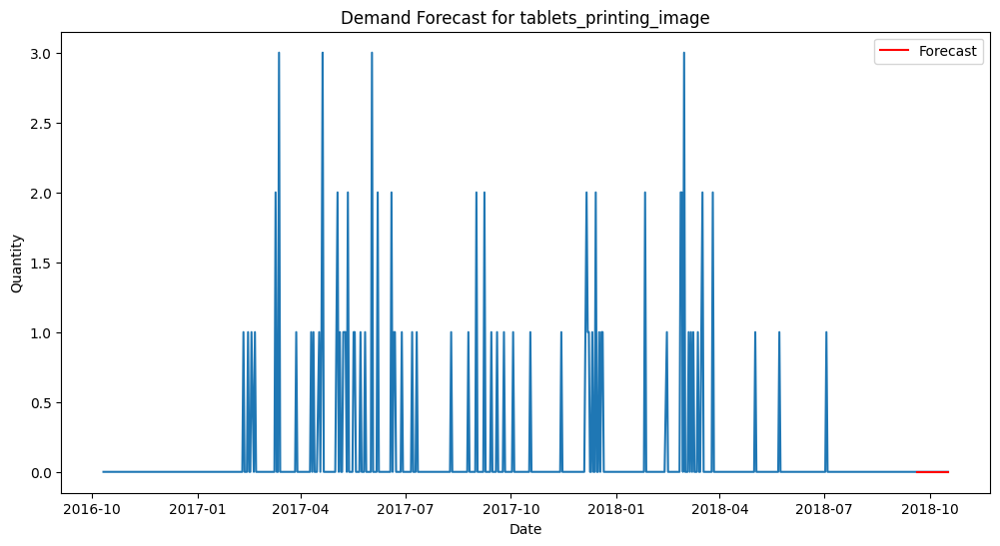

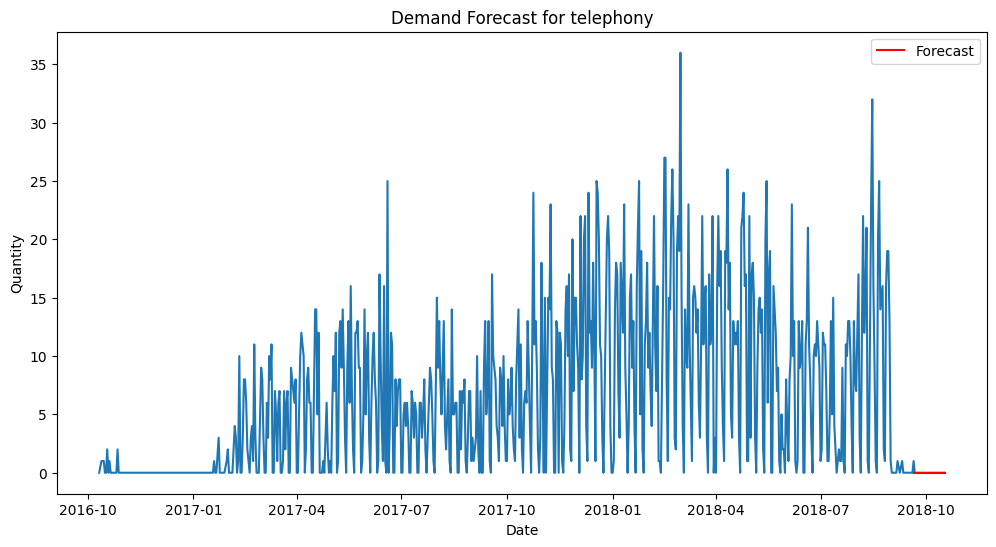

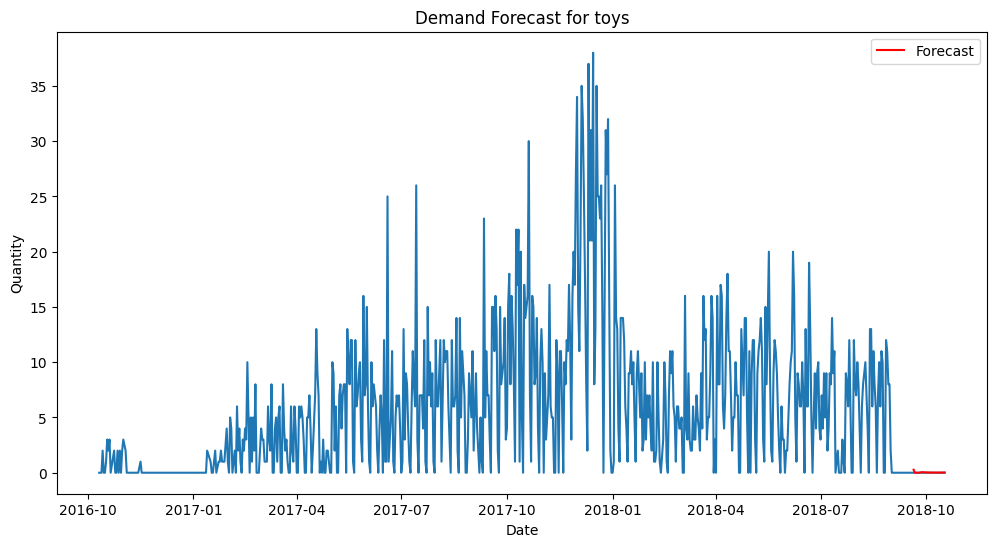

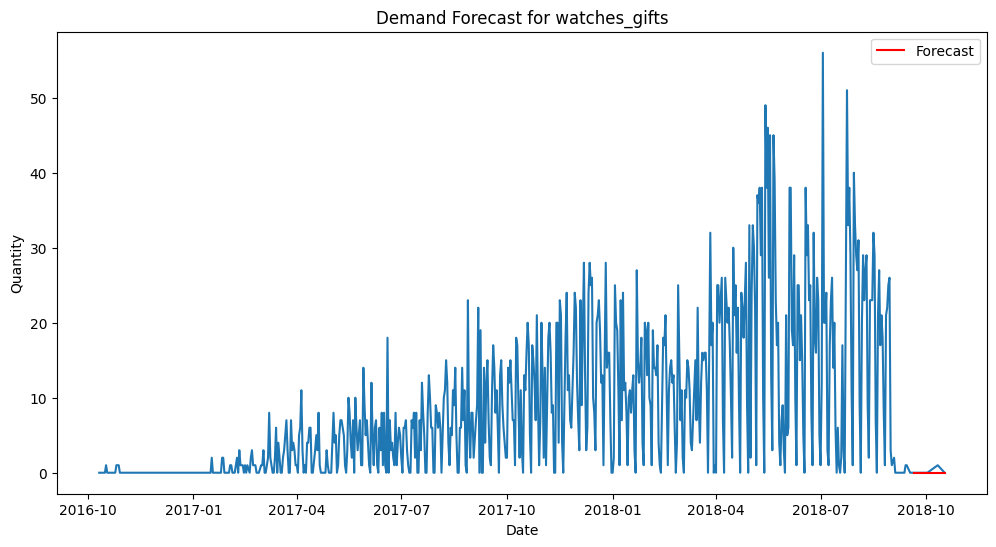

In [185]:
for category in rf_df.columns:
  plt.figure(figsize=(12, 6))
  plt.plot(data.index, data[category])
  plt.plot(data[-7:].index, rf_df[category], label="Forecast", color="red")
  plt.title(f"Demand Forecast for {category}")
  plt.xlabel("Date")
  plt.ylabel("Quantity")
  plt.legend()
  plt.show()


Модель Random Forest спрогнозувала дані близькі до того, що є у вибірці

## Візуалізація передбачення GBR

In [190]:
gbr_df = gbr_df.set_index(data_t.index[-15:]).T

In [191]:
gbr_df

product_category_name_english,musical_instruments,office_furniture,party_supplies,perfumery,pet_shop,security_and_services,signaling_and_security,small_appliances,small_appliances_home_oven_and_coffee,sports_leisure,stationery,tablets_printing_image,telephony,toys,watches_gifts
2018-09-19,1.422932e-06,1.422932e-06,1.422932e-06,1.422932e-06,1.422932e-06,1.422932e-06,1.422932e-06,1.422932e-06,1.422932e-06,1.422932e-06,1.422932e-06,1.422932e-06,1.422932e-06,9.999749e-01,1.422932e-06
2018-09-20,4.743107e-07,4.743107e-07,4.743107e-07,4.743107e-07,4.743107e-07,4.743107e-07,4.743107e-07,4.743107e-07,4.743107e-07,4.743107e-07,4.743107e-07,4.743107e-07,4.743107e-07,4.743107e-07,4.743107e-07
2018-09-21,9.486214e-07,9.486214e-07,9.486214e-07,9.486214e-07,9.486214e-07,9.486214e-07,9.486214e-07,9.486214e-07,9.486214e-07,9.486214e-07,9.486214e-07,9.486214e-07,9.486214e-07,9.486214e-07,9.486214e-07
2018-09-25,4.743107e-07,4.743107e-07,4.743107e-07,4.743107e-07,4.743107e-07,4.743107e-07,2.326027e-02,4.743107e-07,4.743107e-07,4.743107e-07,4.743107e-07,4.743107e-07,4.743107e-07,4.743107e-07,4.743107e-07
2018-09-27,4.743107e-07,4.743107e-07,4.743107e-07,4.743107e-07,4.743107e-07,4.743107e-07,4.743107e-07,4.743107e-07,4.743107e-07,4.743107e-07,4.743107e-07,4.743107e-07,4.743107e-07,4.743107e-07,4.743107e-07
2018-10-02,4.743107e-07,4.743107e-07,1.613332e-05,4.743107e-07,4.743107e-07,4.743107e-07,4.743107e-07,4.743107e-07,4.743107e-07,4.743107e-07,4.743107e-07,4.743107e-07,4.743107e-07,4.743107e-07,4.743107e-07
2018-10-11,4.743107e-07,4.743107e-07,4.743107e-07,4.743107e-07,4.743107e-07,4.743107e-07,4.743107e-07,4.743107e-07,4.743107e-07,4.743107e-07,4.743107e-07,4.743107e-07,4.743107e-07,4.743107e-07,4.743107e-07


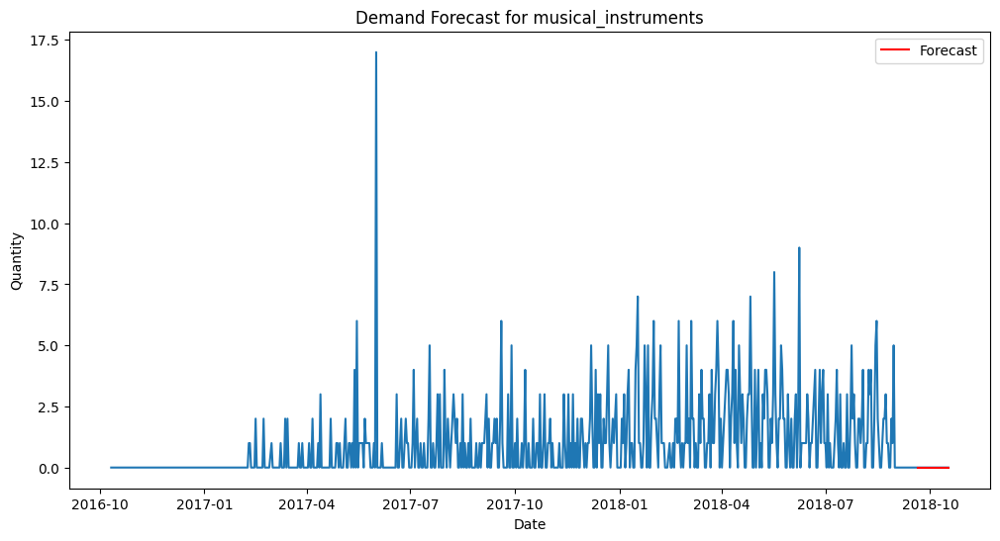

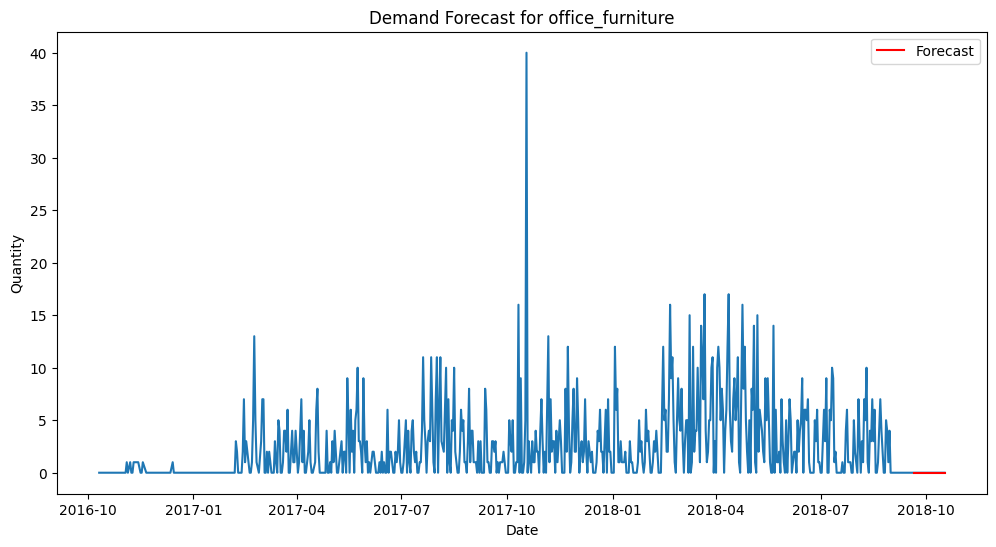

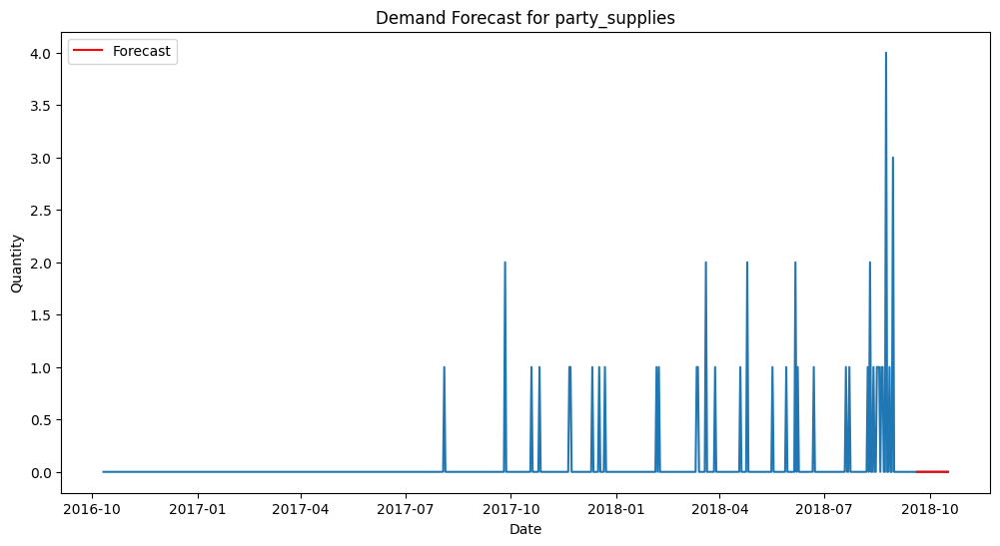

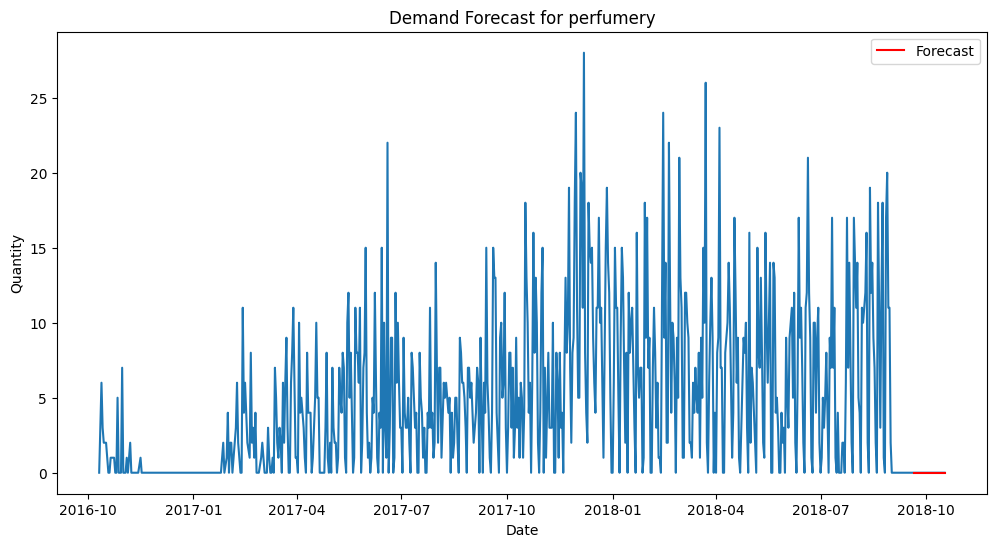

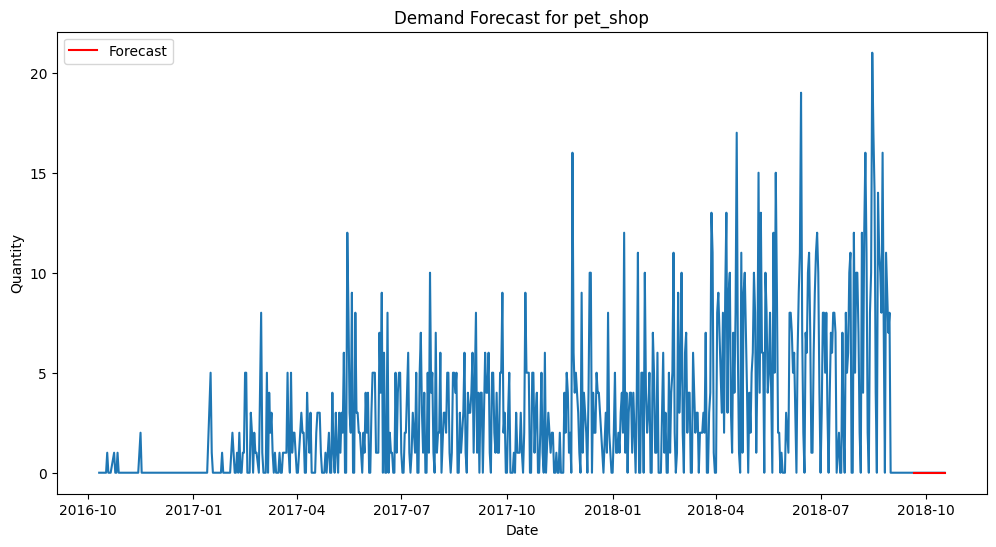

...

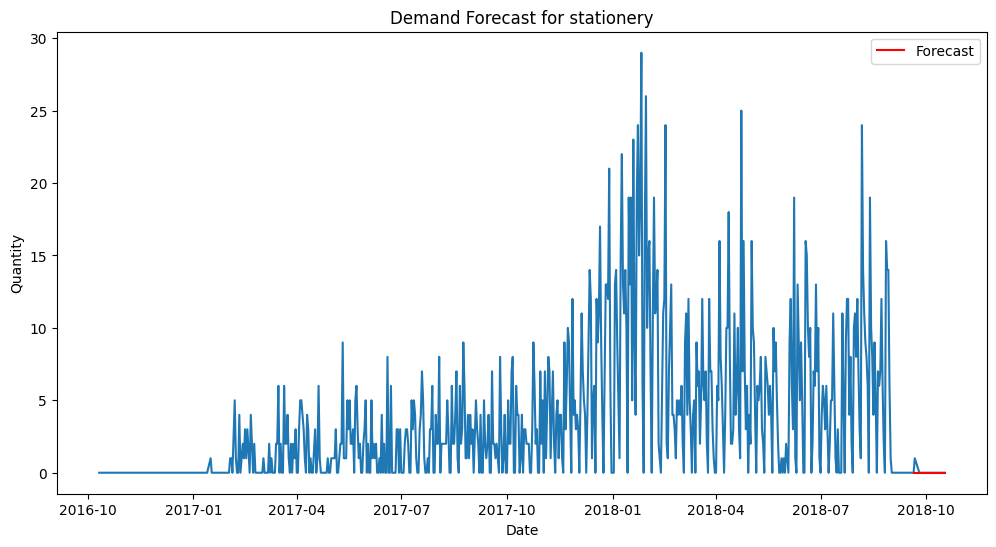

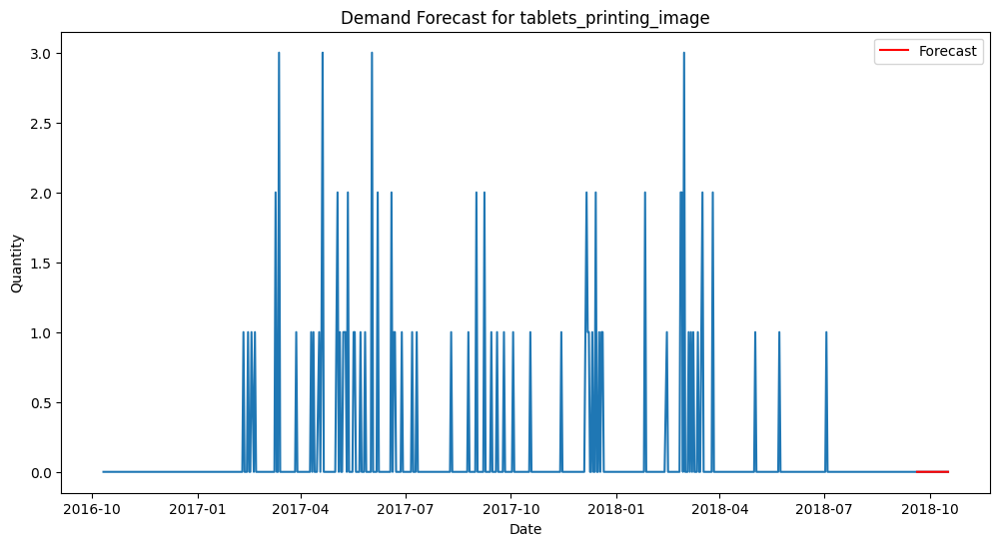

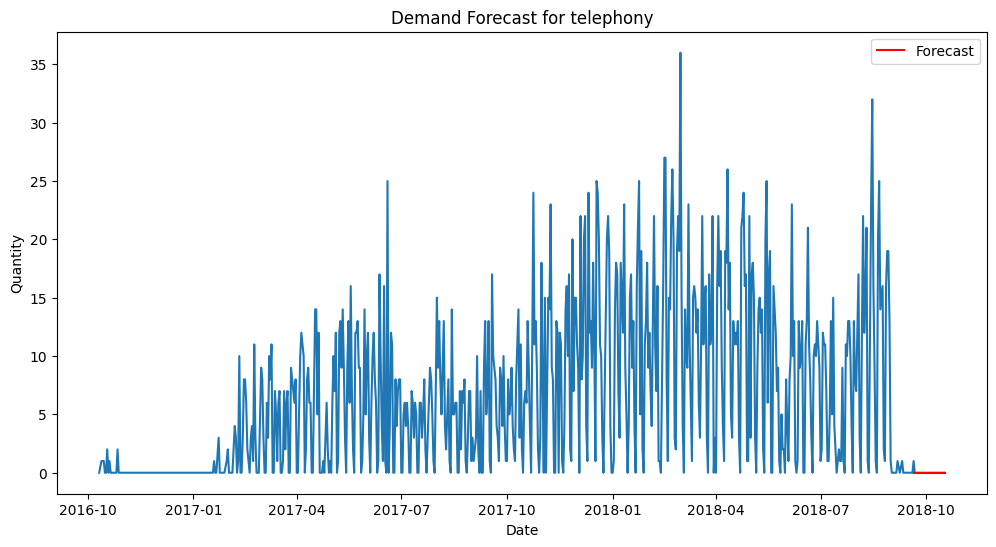

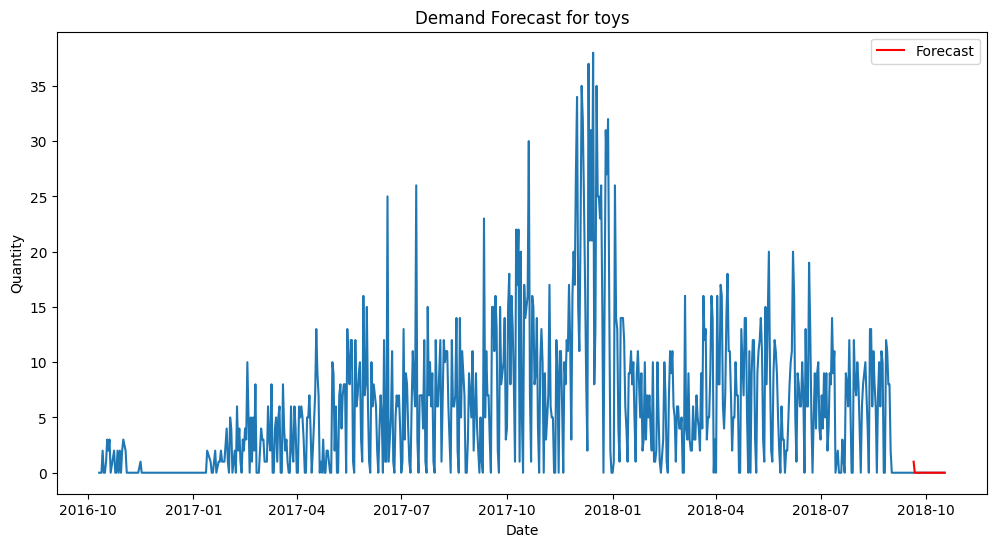

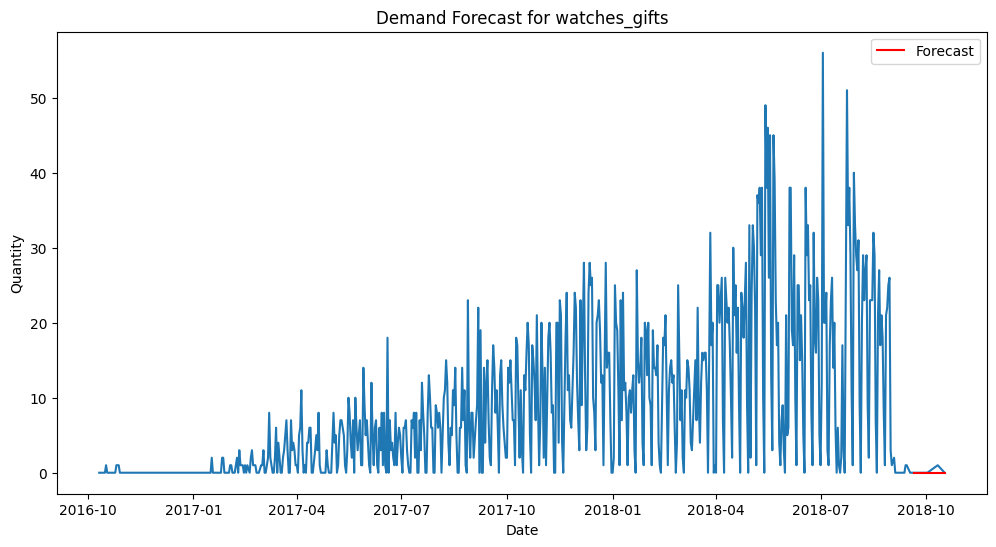

In [192]:
for category in rf_df.columns:
  plt.figure(figsize=(12, 6))
  plt.plot(data.index, data[category])
  plt.plot(data[-7:].index, gbr_df[category], label="Forecast", color="red")
  plt.title(f"Demand Forecast for {category}")
  plt.xlabel("Date")
  plt.ylabel("Quantity")
  plt.legend()
  plt.show()


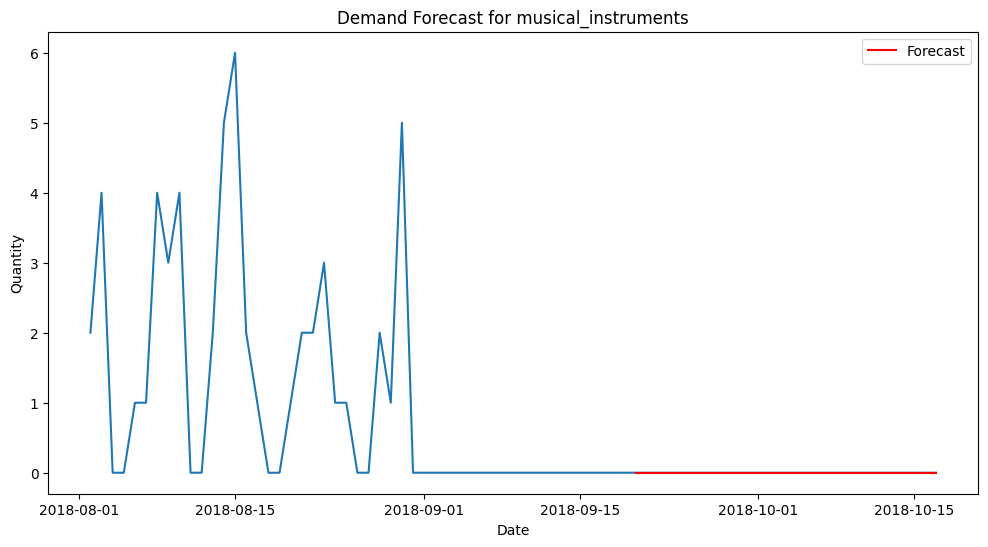

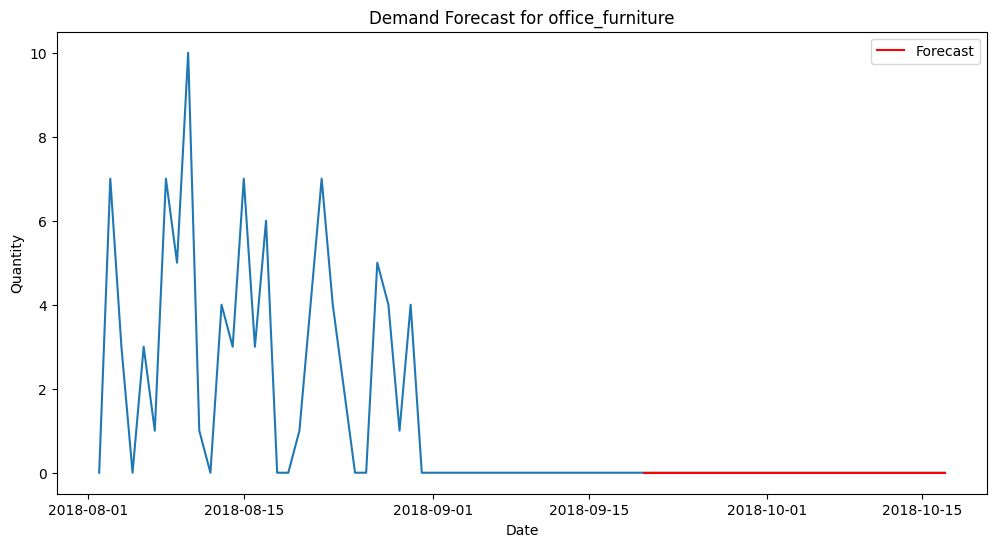

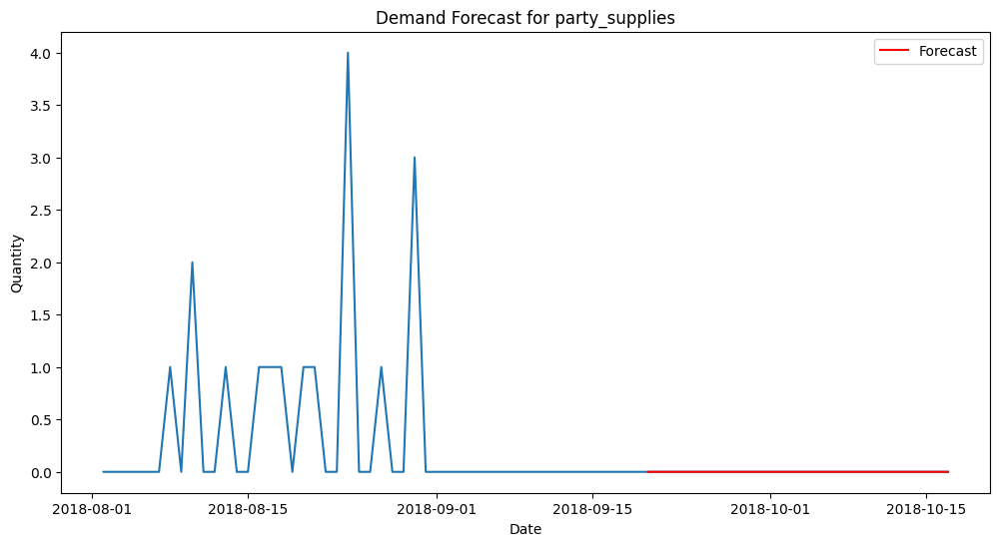

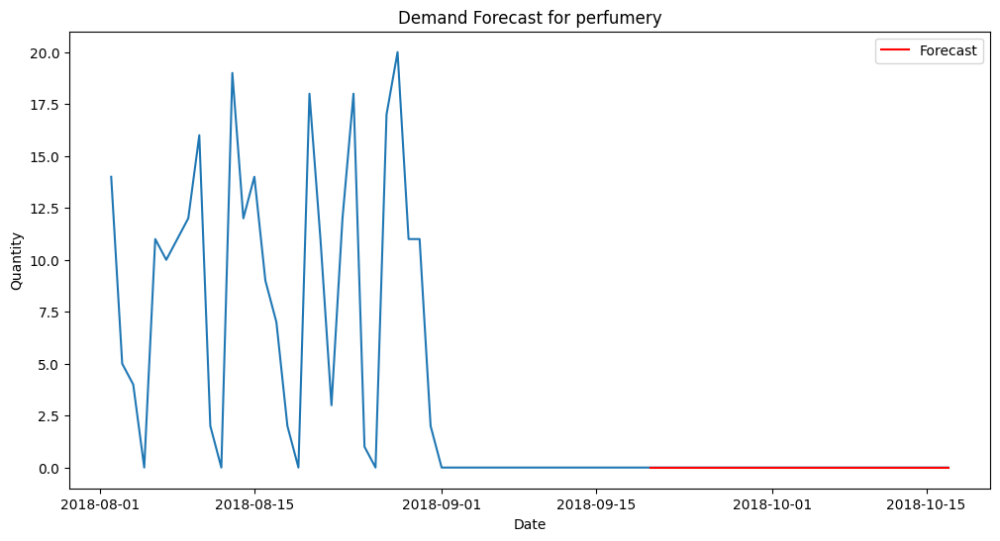

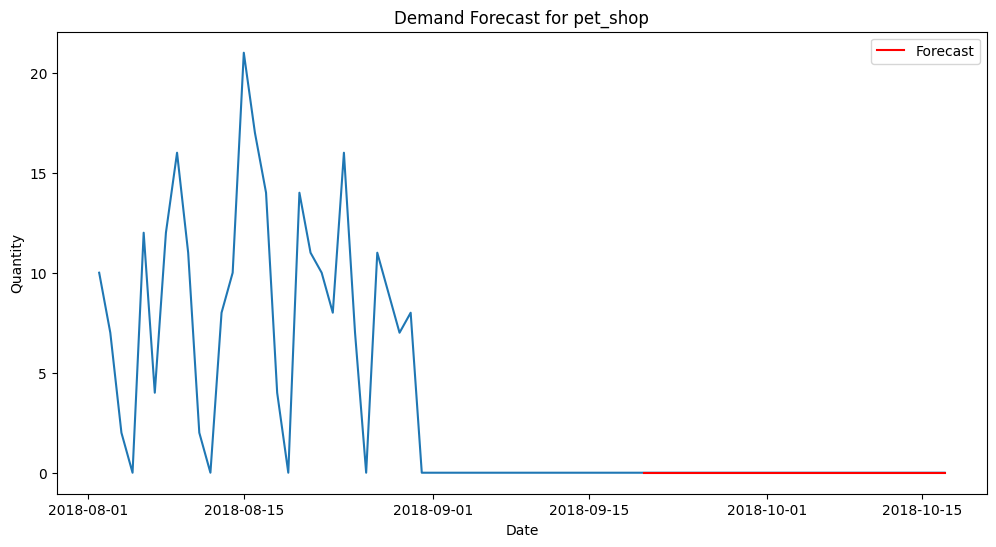

...

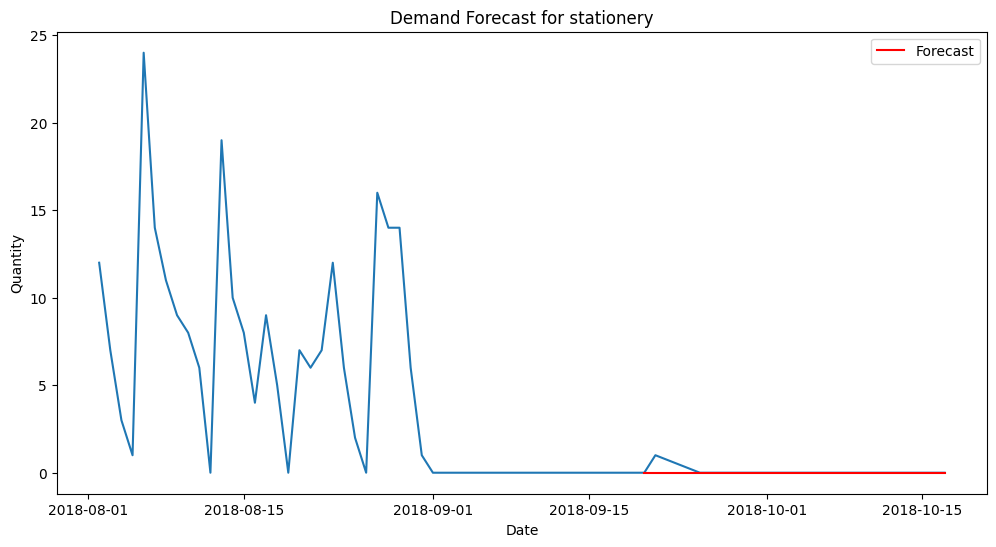

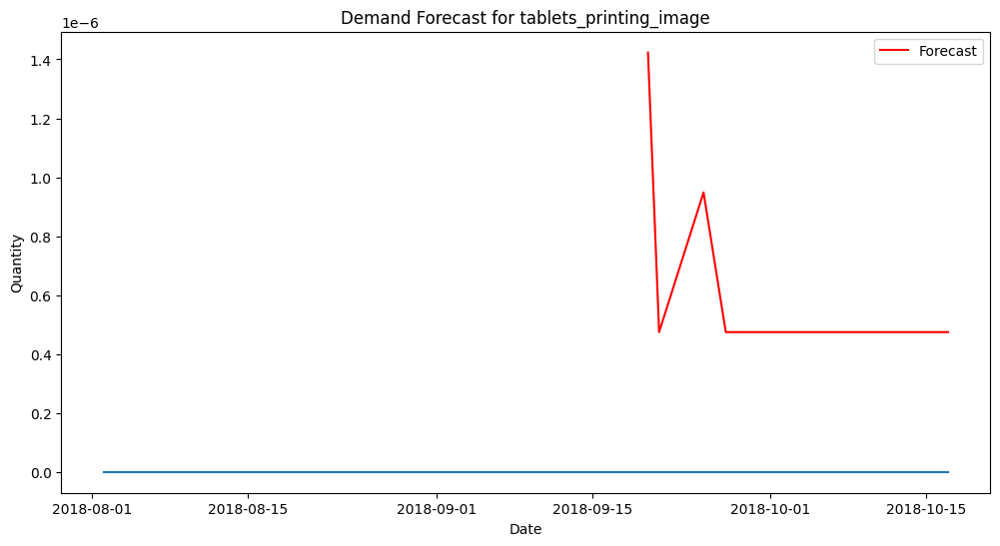

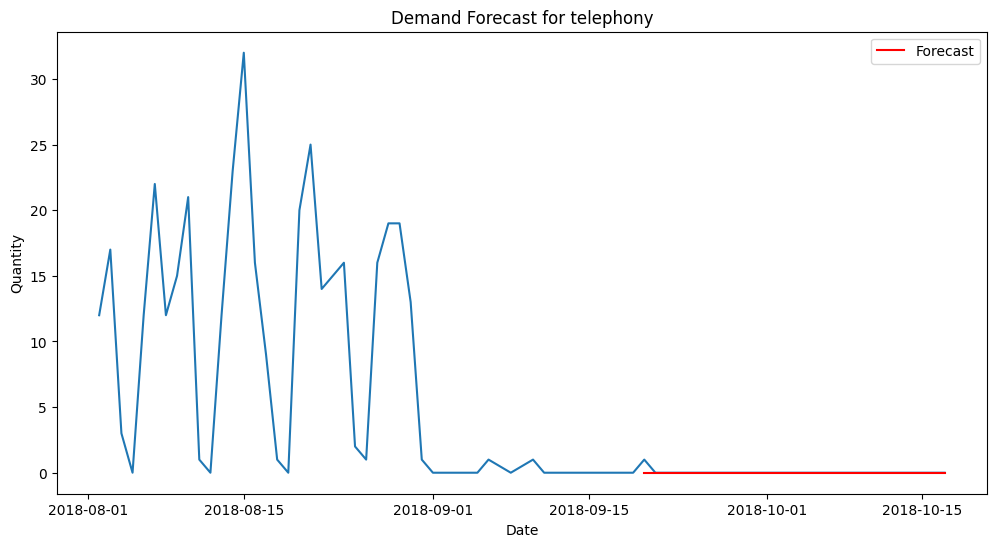

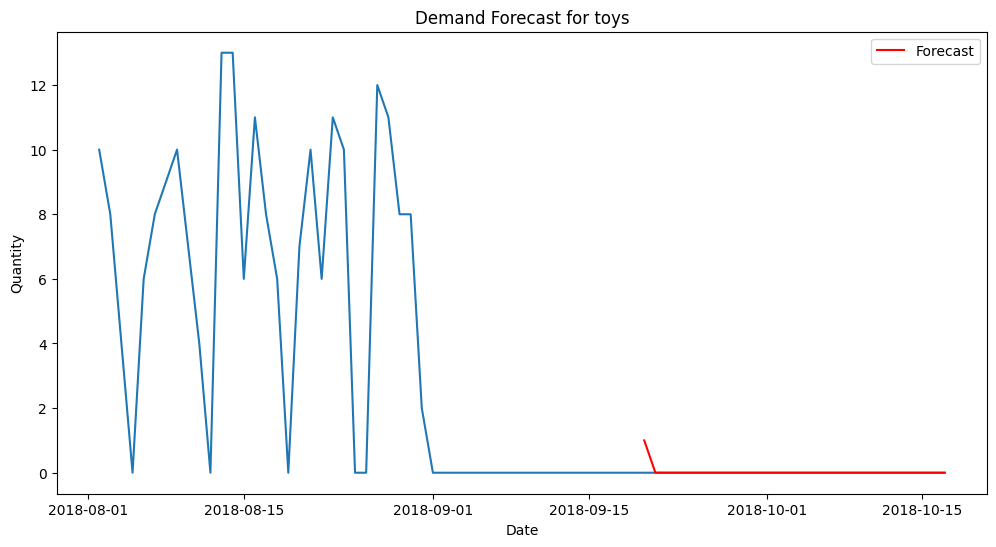

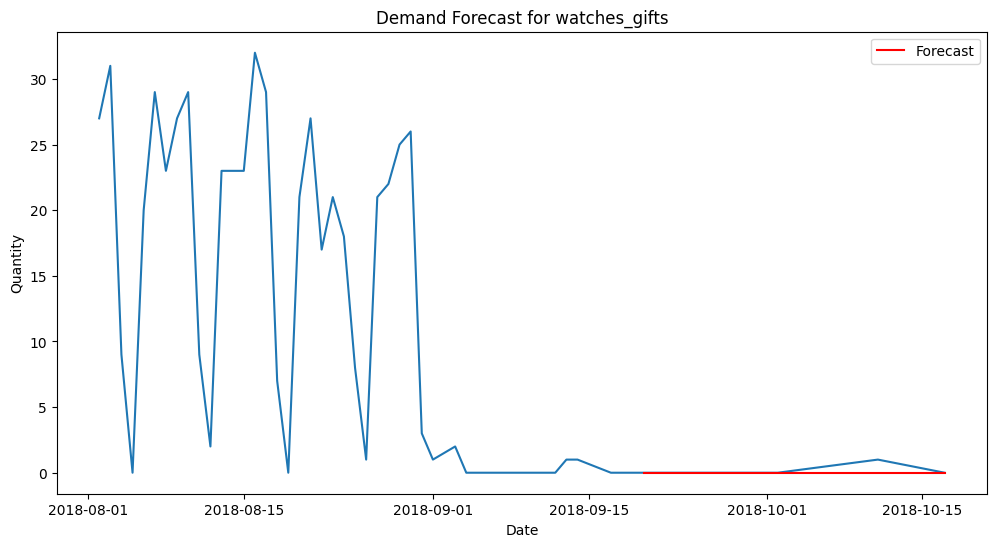

In [195]:
for category in rf_df.columns:
  plt.figure(figsize=(12, 6))
  plt.plot(data[-50:].index, data[-50:][category])
  plt.plot(data[-7:].index, gbr_df[category], label="Forecast", color="red")
  plt.title(f"Demand Forecast for {category}")
  plt.xlabel("Date")
  plt.ylabel("Quantity")
  plt.legend()
  plt.show()

## Висновки

Передбачення будувалися на останній тиждень вибірки, де майже всі значення були нульовими. Моделі справилися досить непогано, хоча значення помилки для GBR залишає кілька питань. За графіком можна помітити, що в 10 місяць кожного року є деякі пониження показників продажей.

## Прогноз на 21 день за допомогою Random Forest

За схожим принципом можна спрогнозувати значення на всій вибірці для 1 наступного дня і повторювати пронозування на основі всієї вибірки + цього нового дня (ще 21 разів).

In [255]:
data_t.shape

(71, 644)

In [252]:
def random_forest(data, day):
  if day <= 0:
    return data

  df = data.copy()

  X = df[df.columns[:-1]]
  y = df[df.columns[-1:]]

  model = RandomForestRegressor()
  model.fit(X, y)
  model_pred = model.predict(X)

  next_day = df.columns[-1:][0] + pd.Timedelta(days=1)

  result = pd.DataFrame({next_day: model_pred}, index=df.index)

  new_df = pd.concat([df, result], axis=1)

  return random_forest(new_df, day - 1)



In [ ]:
df = random_forest(data_t, 21)

In [254]:
df

,2016-10-11,2016-10-13,2016-10-14,2016-10-15,2016-10-16,2016-10-17,2016-10-18,2016-10-19,2016-10-20,2016-10-21,...,2018-10-29,2018-10-30,2018-10-31,2018-11-01,2018-11-02,2018-11-03,2018-11-04,2018-11-05,2018-11-06,2018-11-07
product_category_name_english,,,,,,,,,,,,,,,,,,,,,
agro_industry_and_commerce,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.002698,0.003161,0.003131,0.003193,0.003239,0.003491,0.003668,0.004032,0.004133,0.004377
air_conditioning,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.000655,0.000786,0.001048,0.001174,0.001133,0.001315,0.001319,0.001433,0.001847,0.001697
art,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.000575,0.000587,0.000594,0.000738,0.000765,0.000822,0.000874,0.001227,0.001237,0.001332
arts_and_craftmanship,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.000029,0.000032,0.000034,0.000034,0.000035,0.000042,0.000047,0.000053,0.000053,0.000068
audio,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,1.0,0.0,...,0.000521,0.000519,0.000894,0.000826,0.001019,0.001047,0.001326,0.001336,0.001454,0.001436
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
stationery,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.014738,0.015306,0.015634,0.015368,0.015844,0.015735,0.015680,0.015417,0.015393,0.015166
tablets_printing_image,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.000223,0.000261,0.000280,0.000278,0.000326,0.000335,0.000339,0.000371,0.000378,0.000428
telephony,0.0,1.0,1.0,1.0,0.0,0.0,2.0,0.0,1.0,0.0,...,0.027662,0.027845,0.025995,0.026741,0.026103,0.024913,0.024202,0.024026,0.023239,0.023516


In [256]:
df_t = df.T

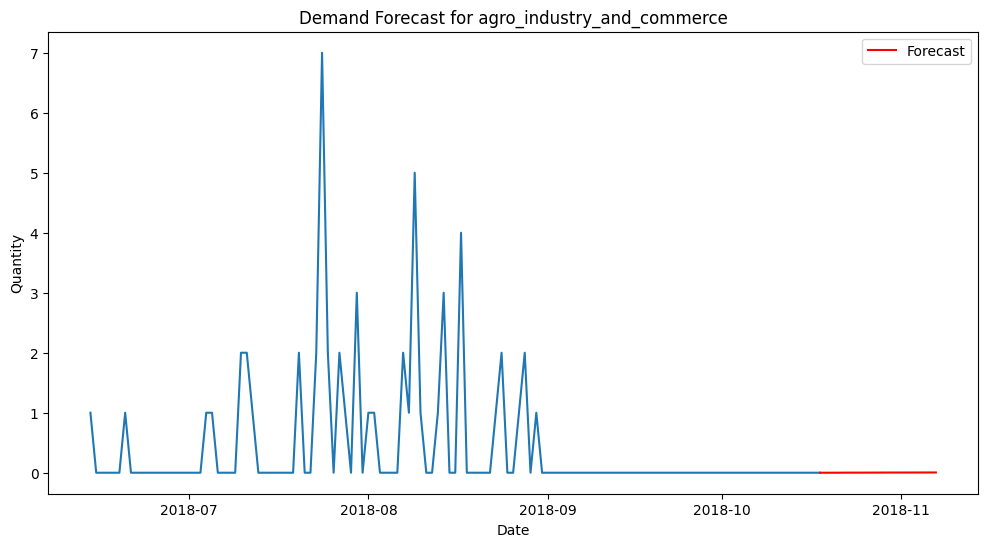

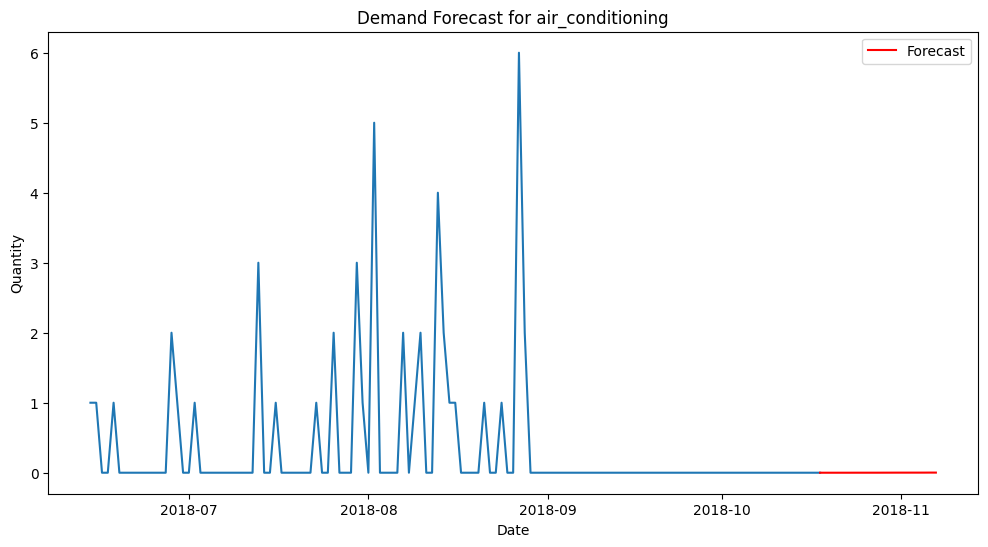

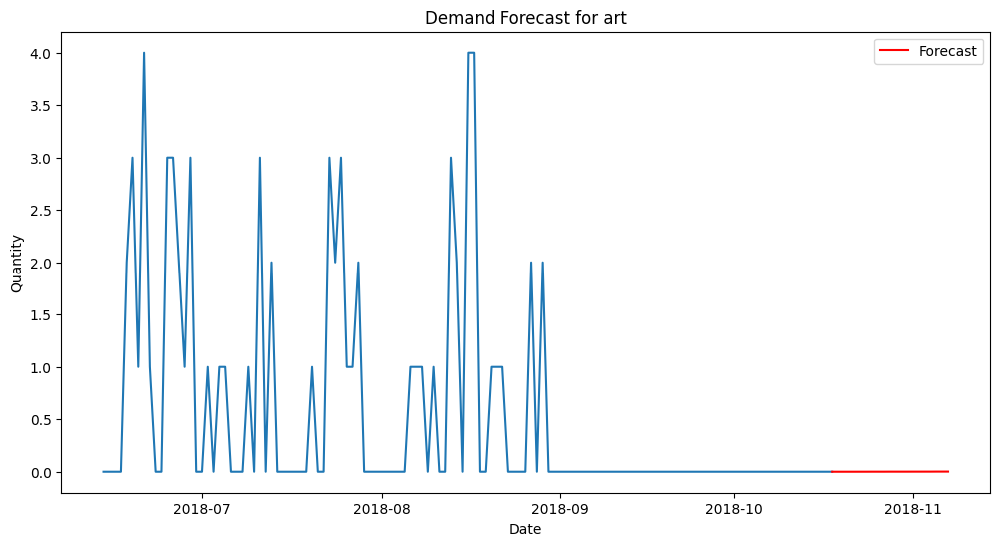

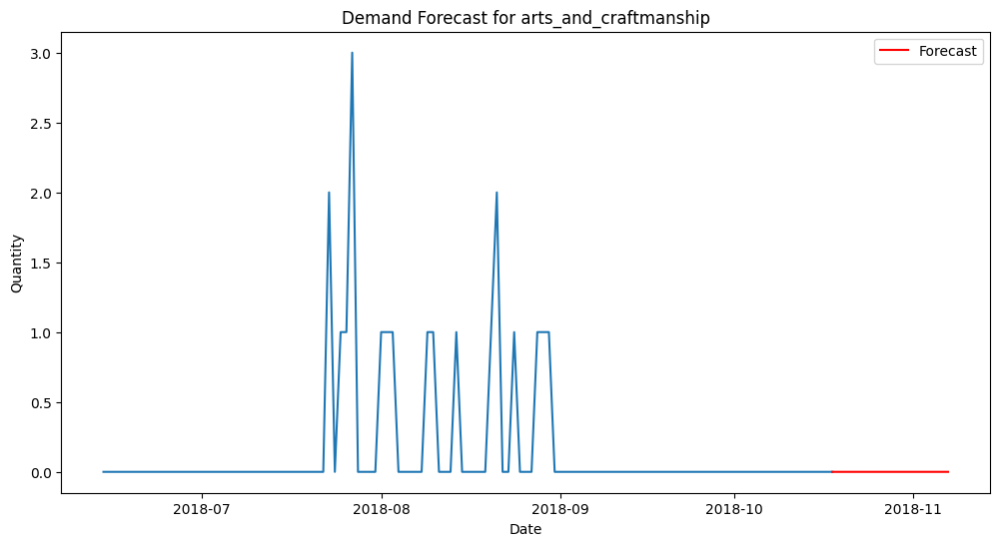

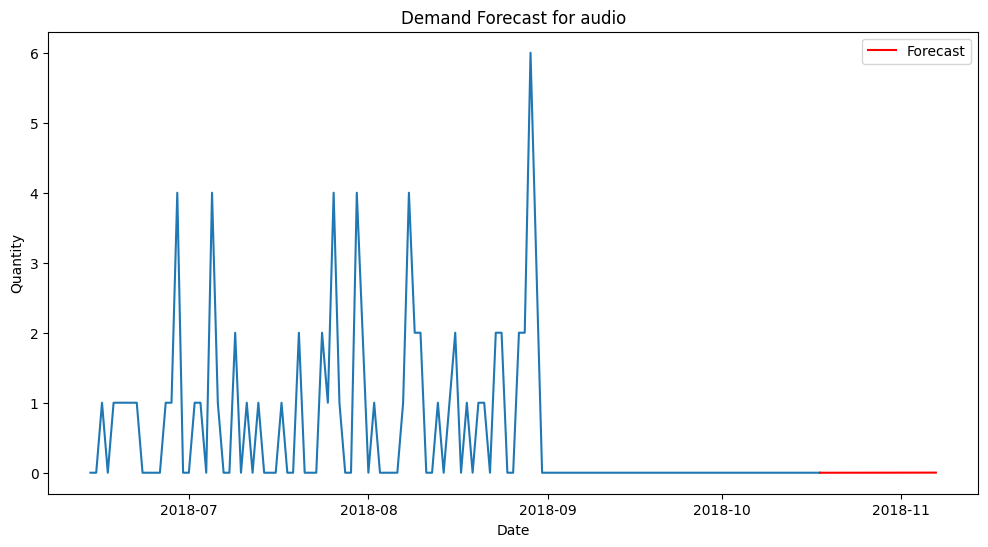

...

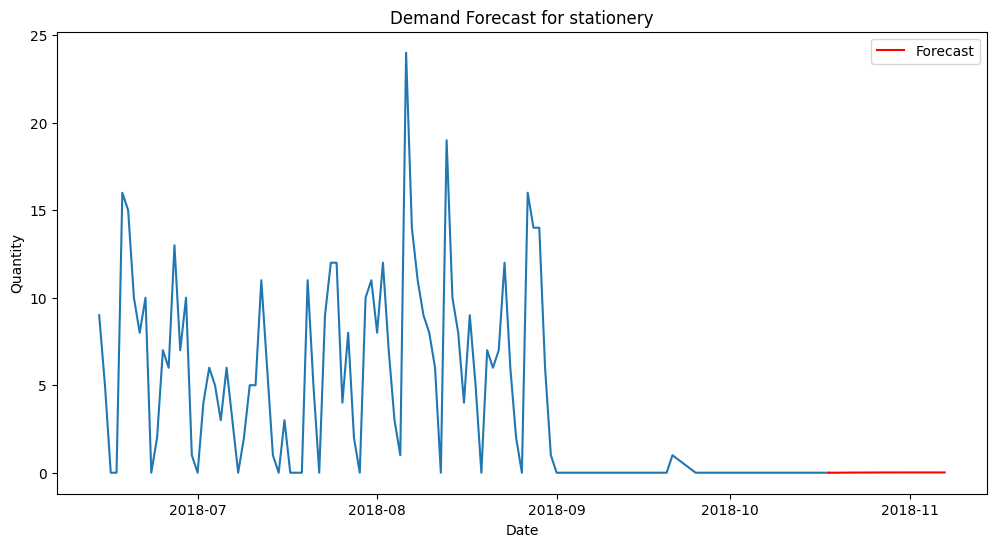

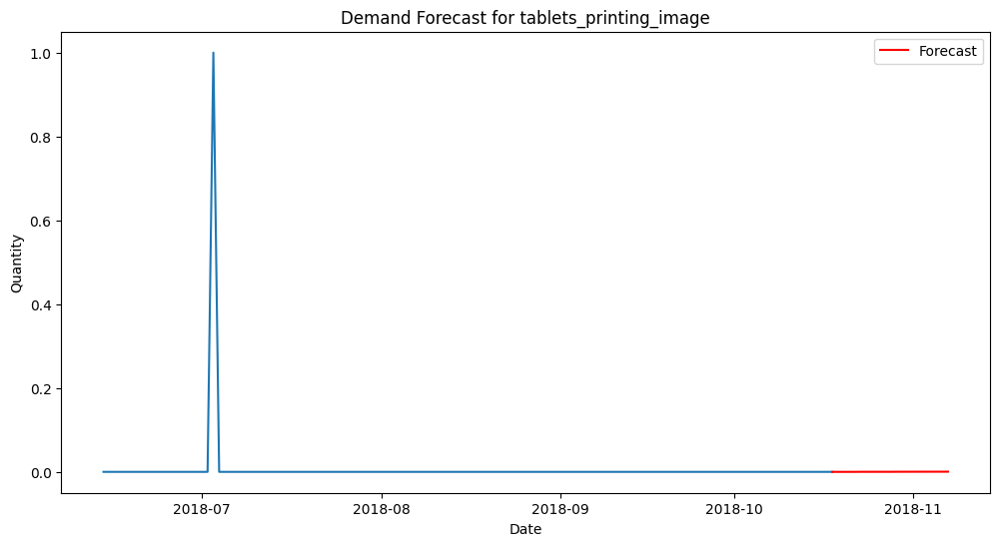

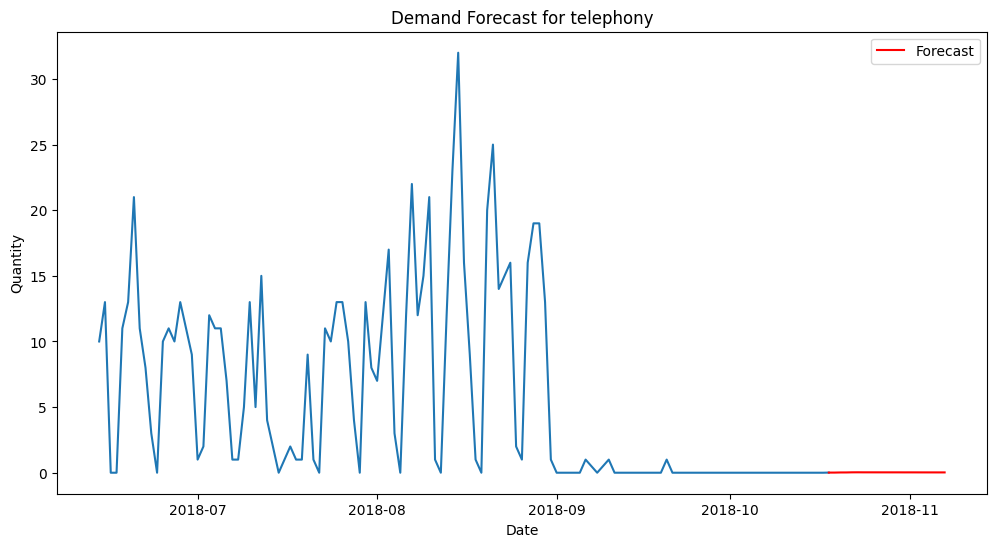

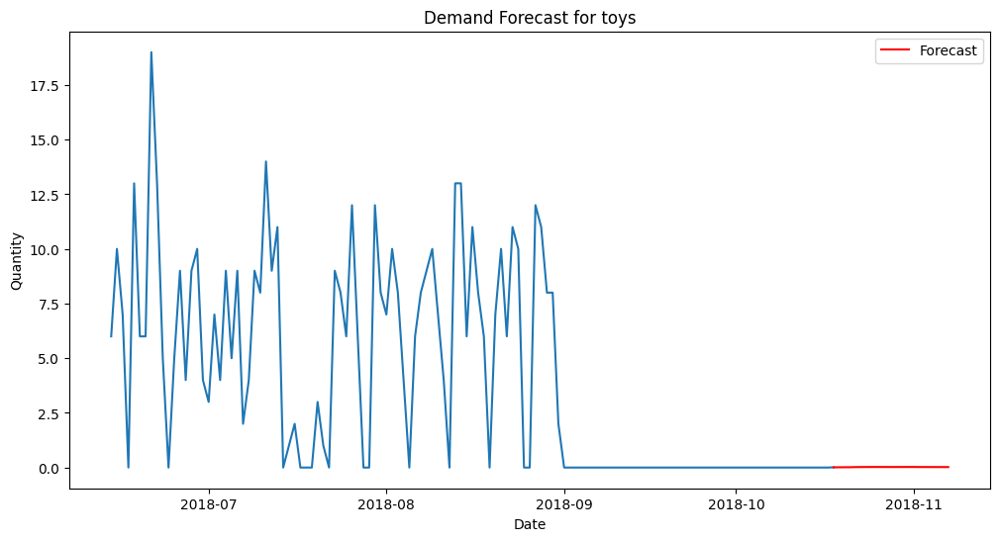

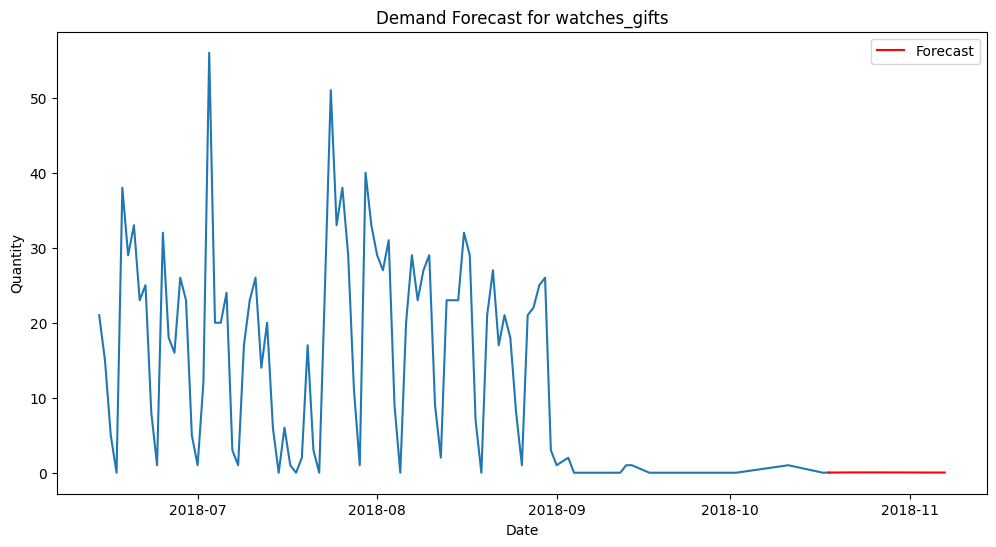

In [262]:
for category in df_t.columns:
  plt.figure(figsize=(12, 6))
  plt.plot(df_t.index[545:645], df_t[545:645][category])
  plt.plot(df_t[644:].index, df_t[644:][category], label="Forecast", color="red")
  plt.title(f"Demand Forecast for {category}")
  plt.xlabel("Date")
  plt.ylabel("Quantity")
  plt.legend()
  plt.show()

Також можна спробувати помножити значення на 10 або 100

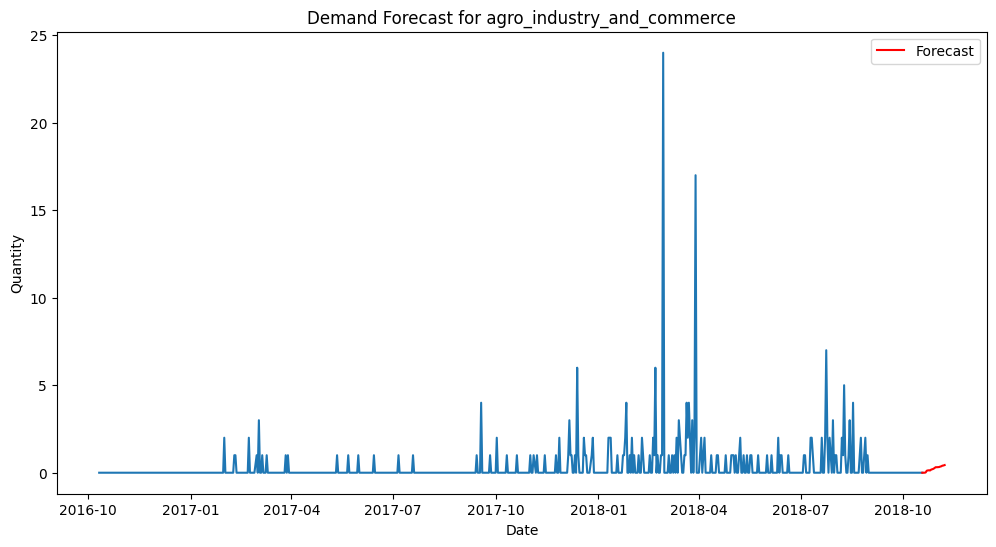

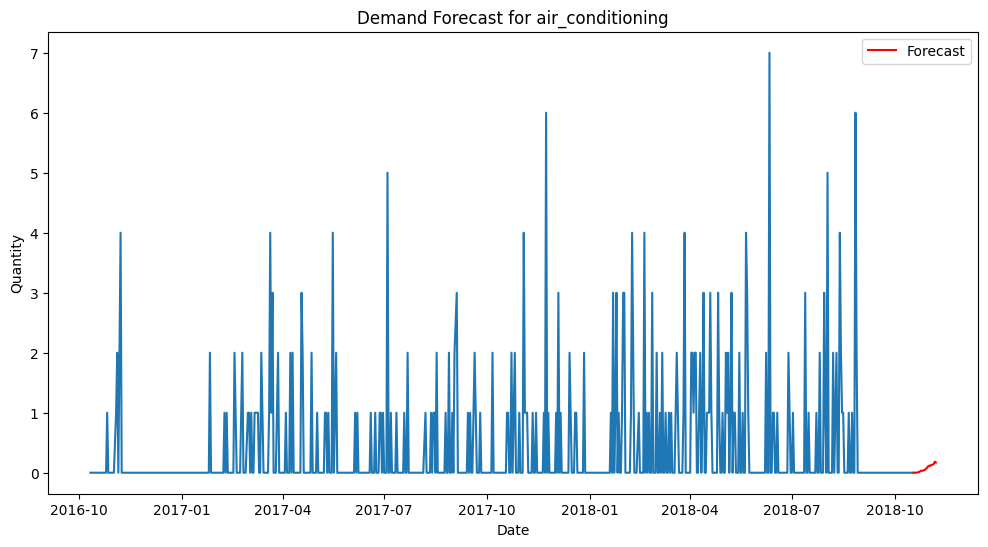

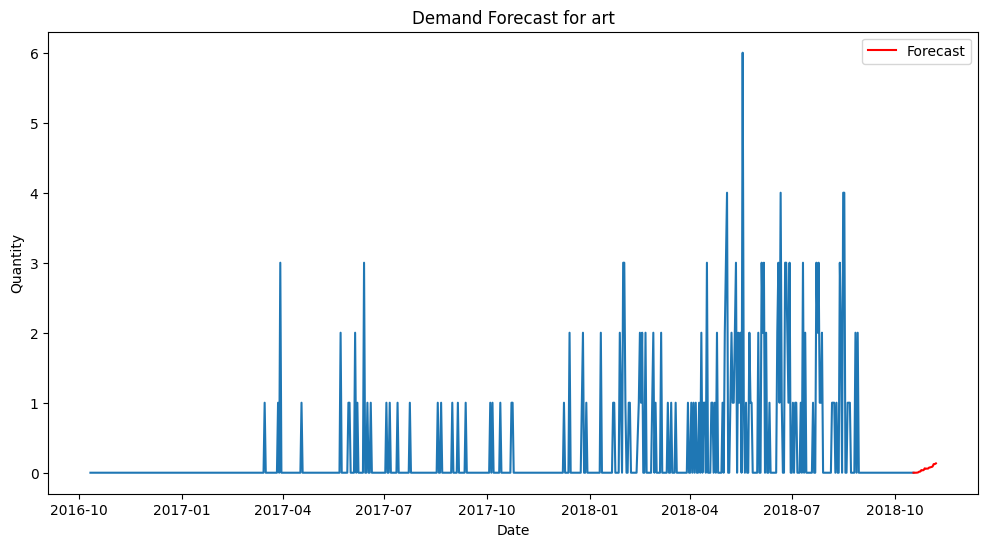

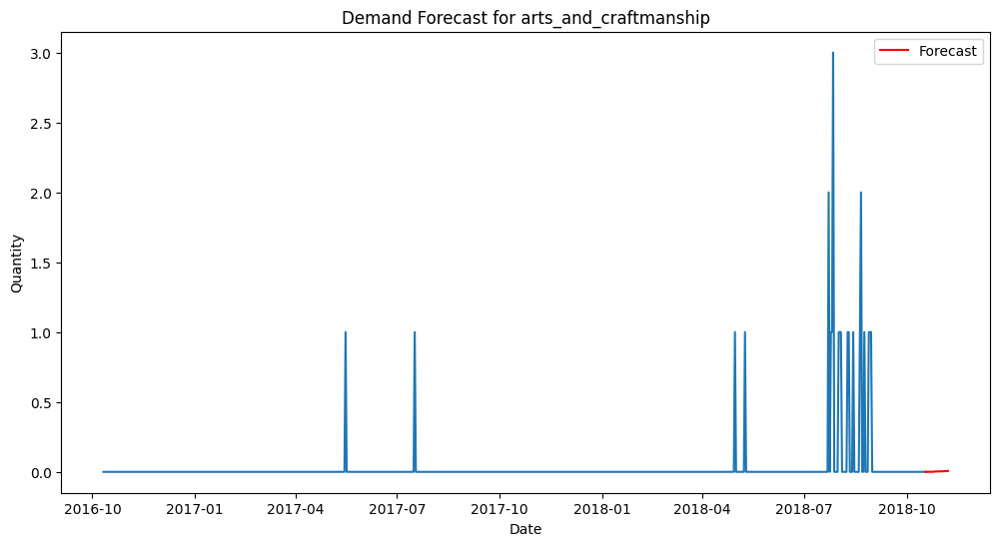

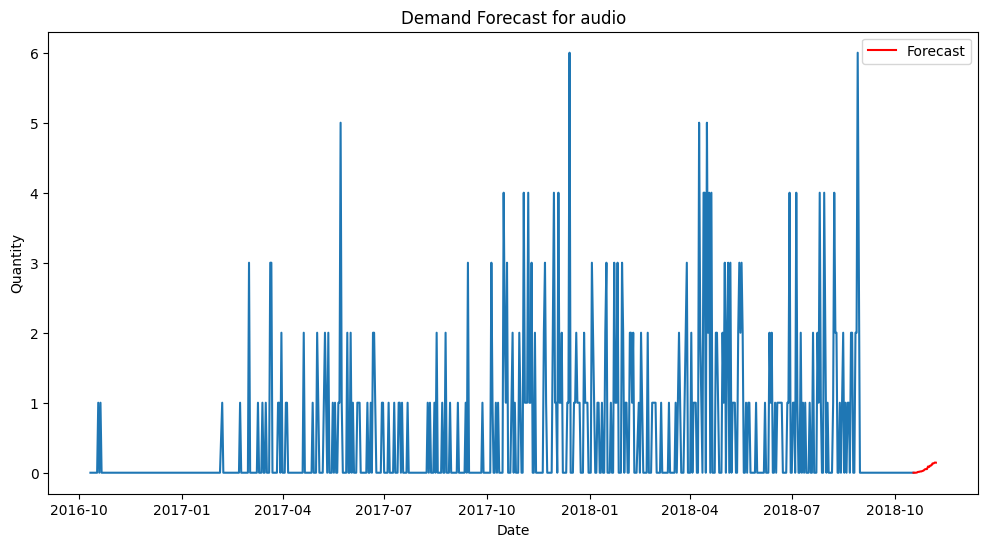

...

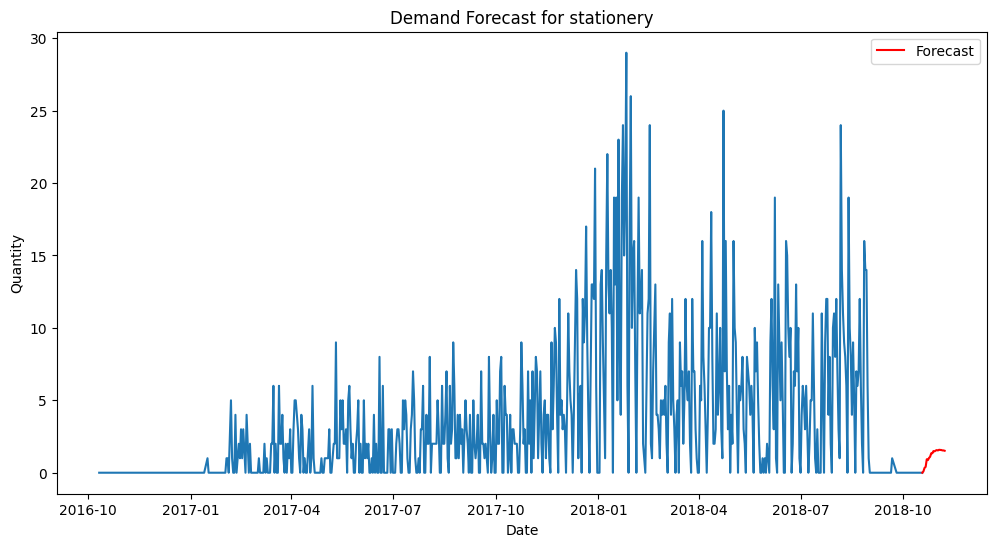

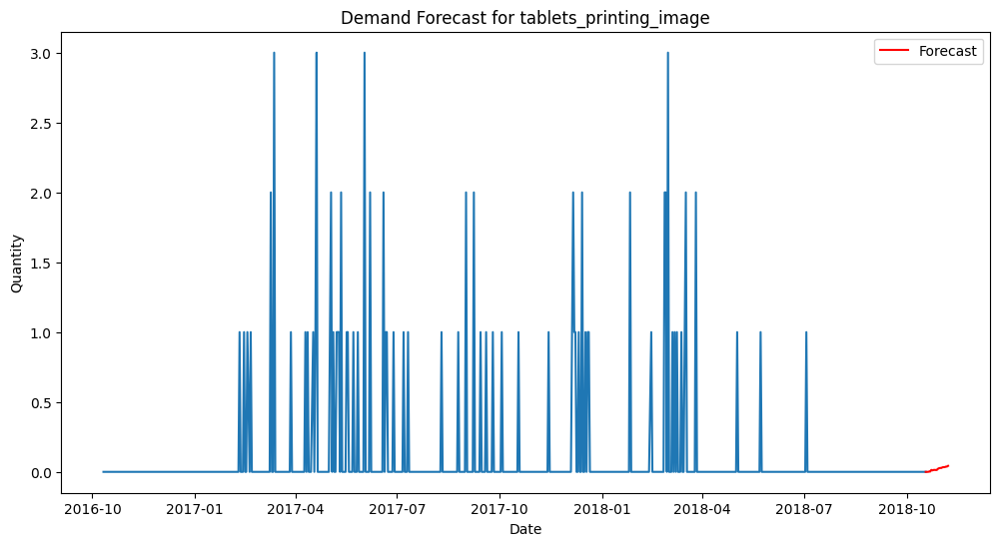

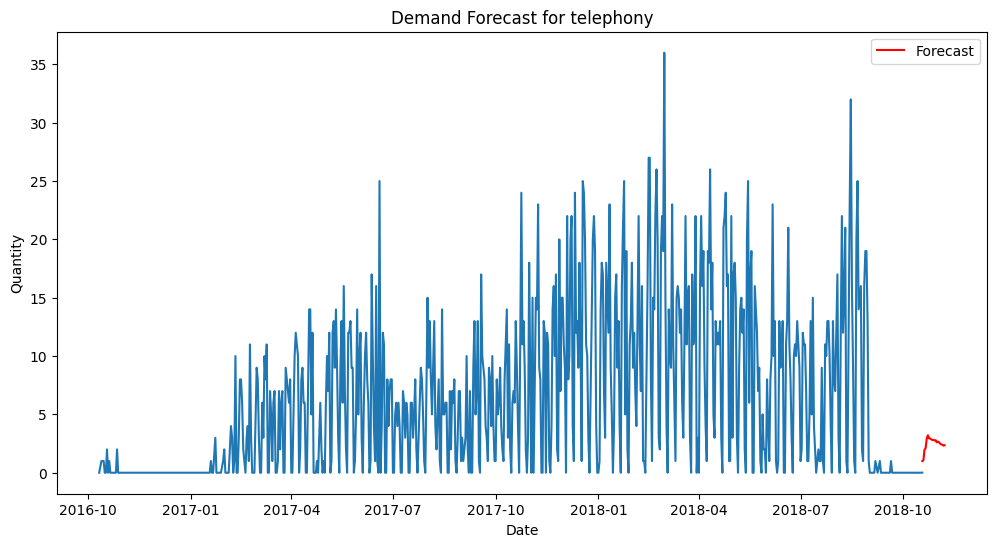

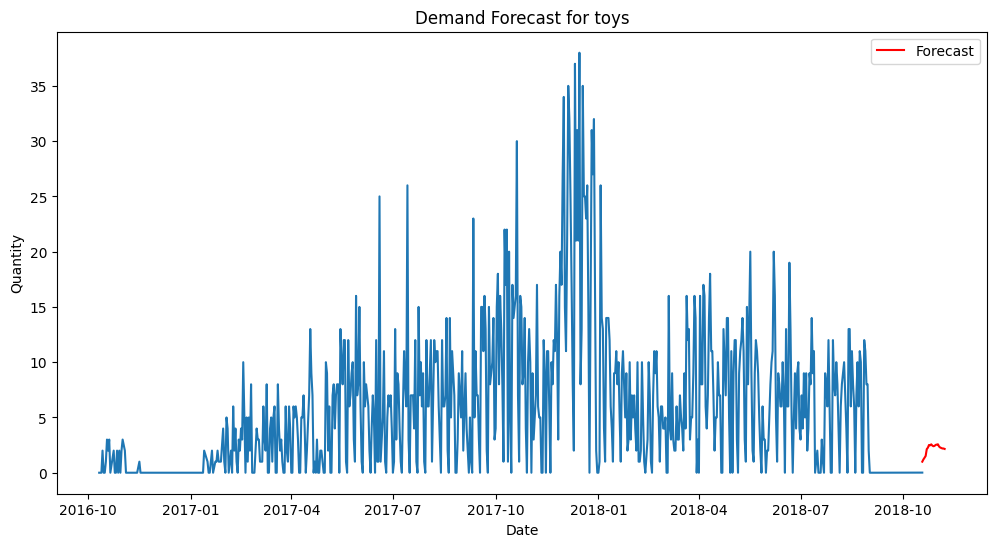

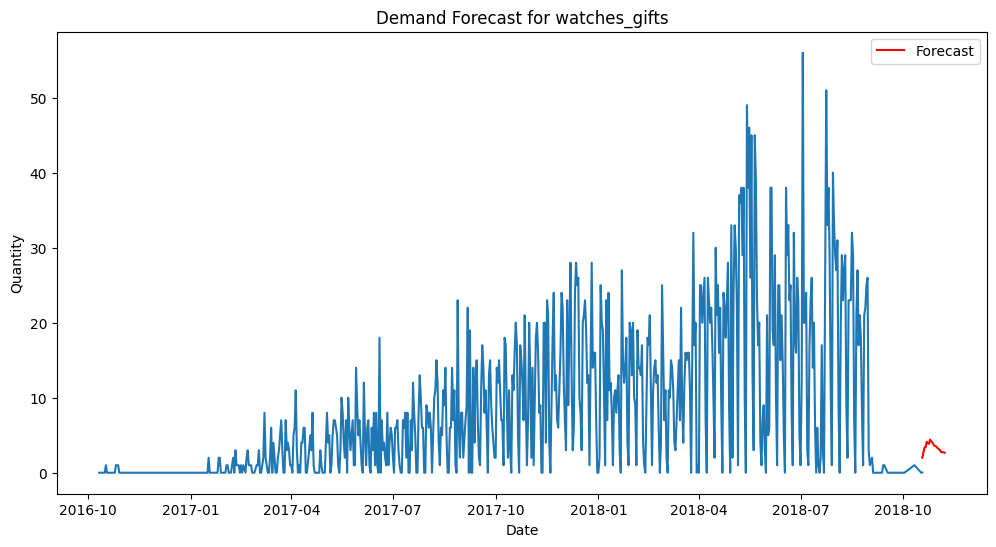

In [264]:
for category in df_t.columns:
  plt.figure(figsize=(12, 6))
  plt.plot(df_t.index[:645], df_t[:645][category])
  plt.plot(df_t[644:].index, 100 * df_t[644:][category], label="Forecast", color="red")
  plt.title(f"Demand Forecast for {category}")
  plt.xlabel("Date")
  plt.ylabel("Quantity")
  plt.legend()
  plt.show()

Таким чином, прогнози виглядають реалістичніше

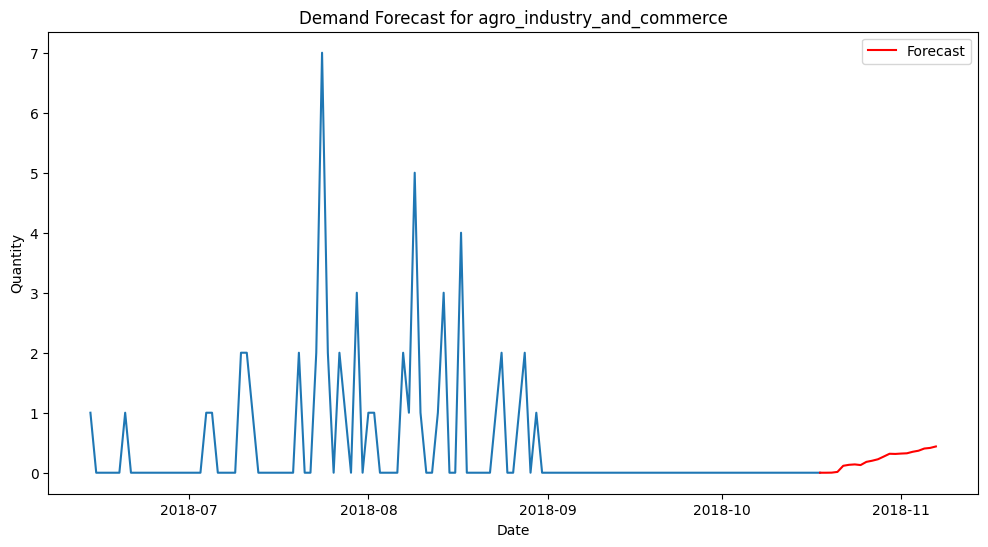

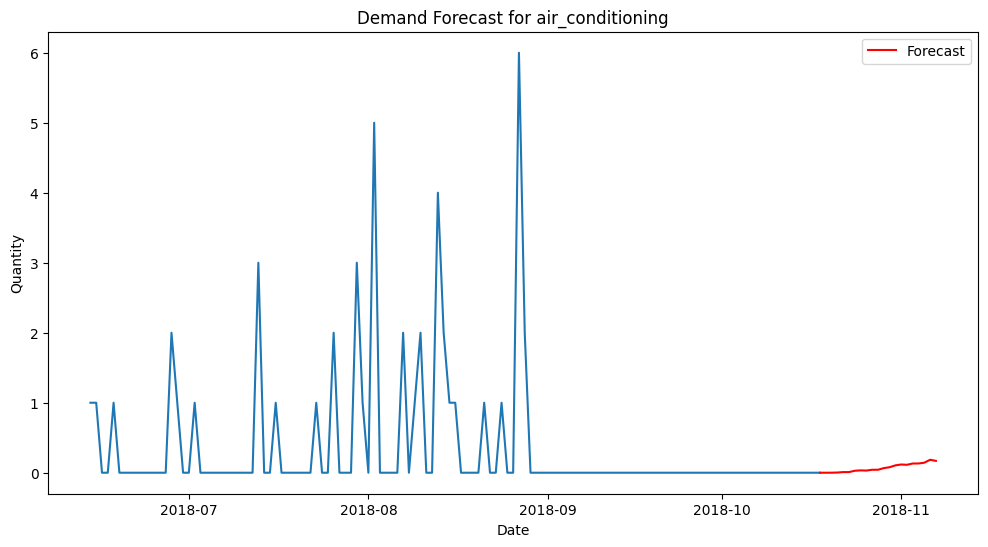

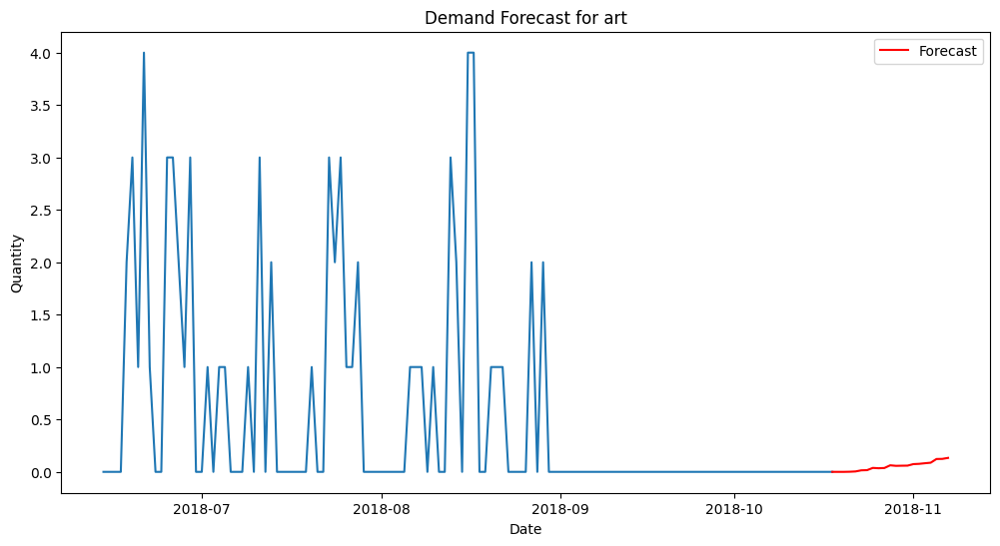

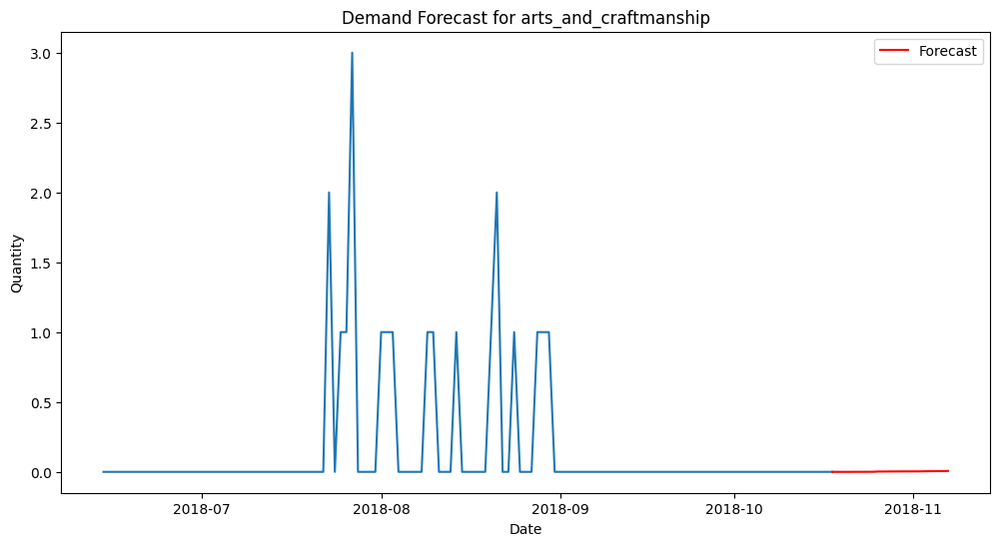

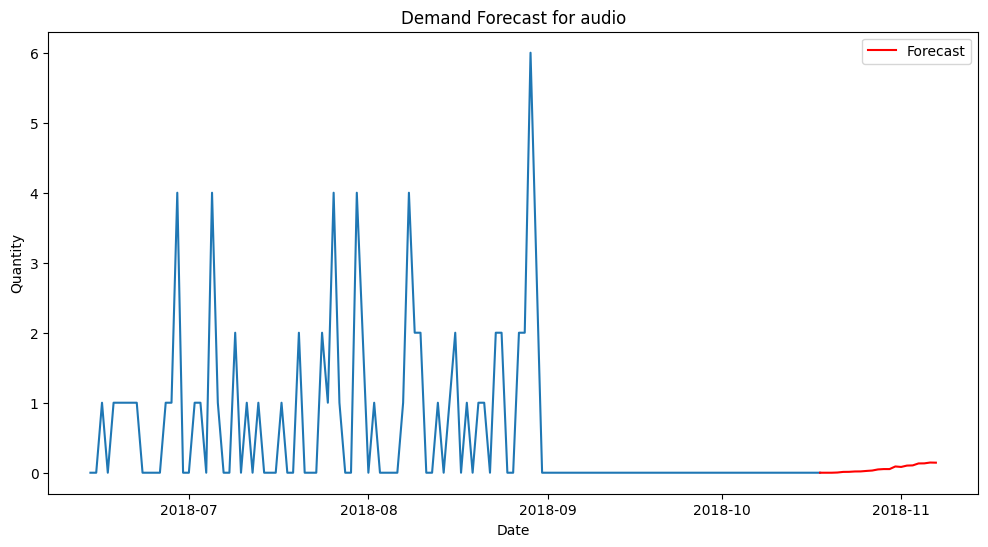

...

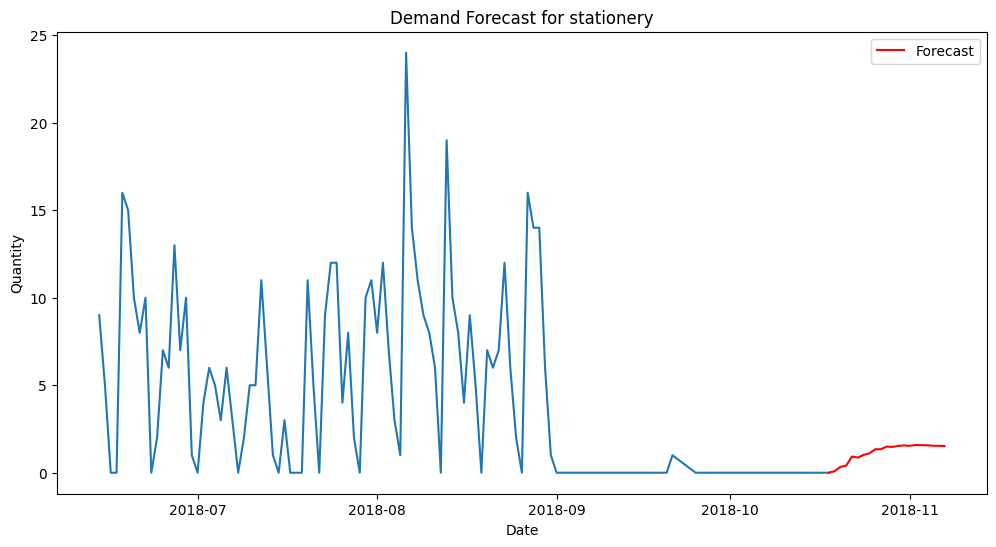

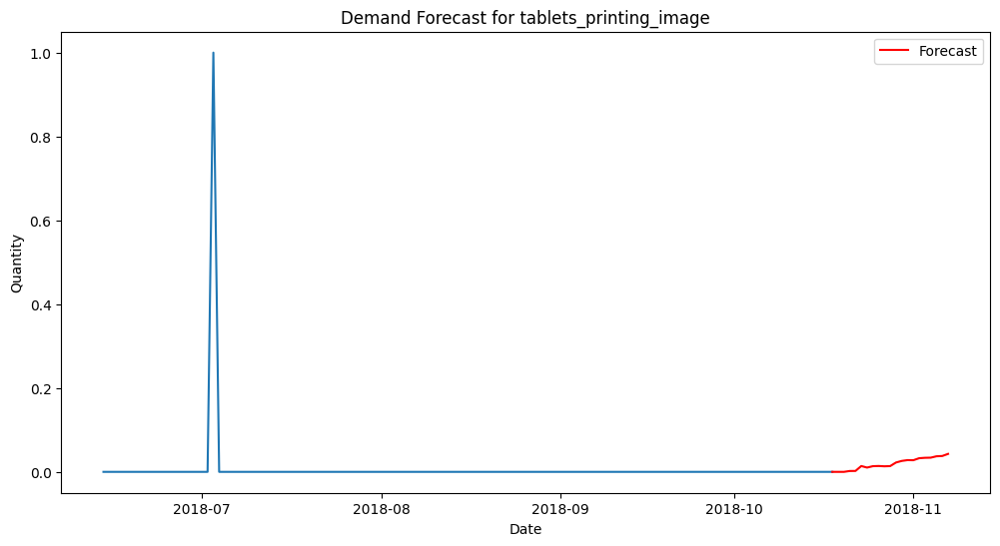

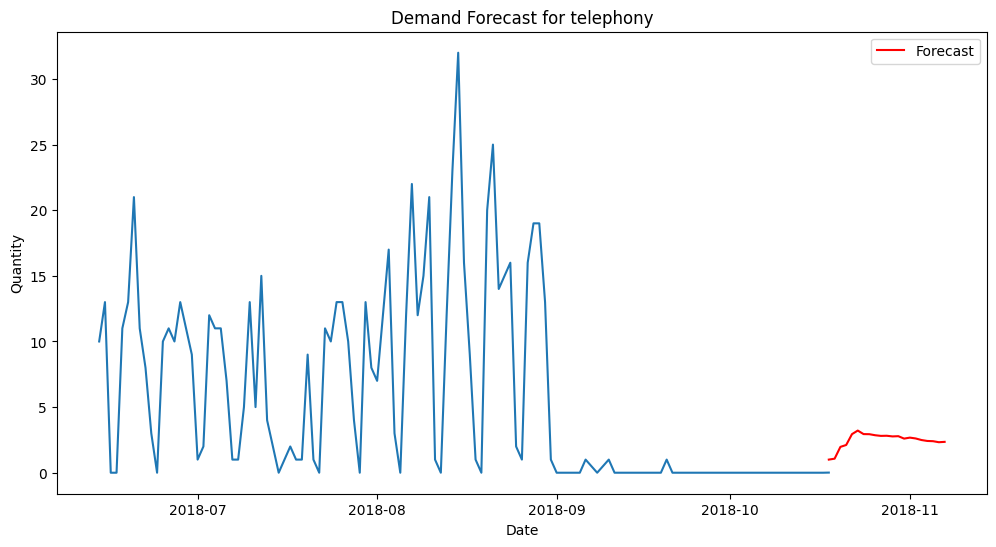

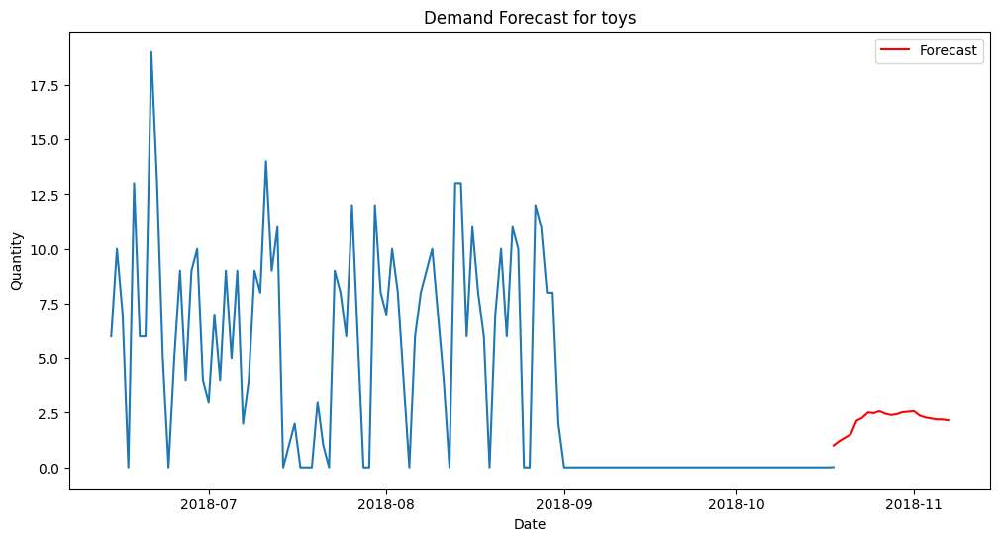

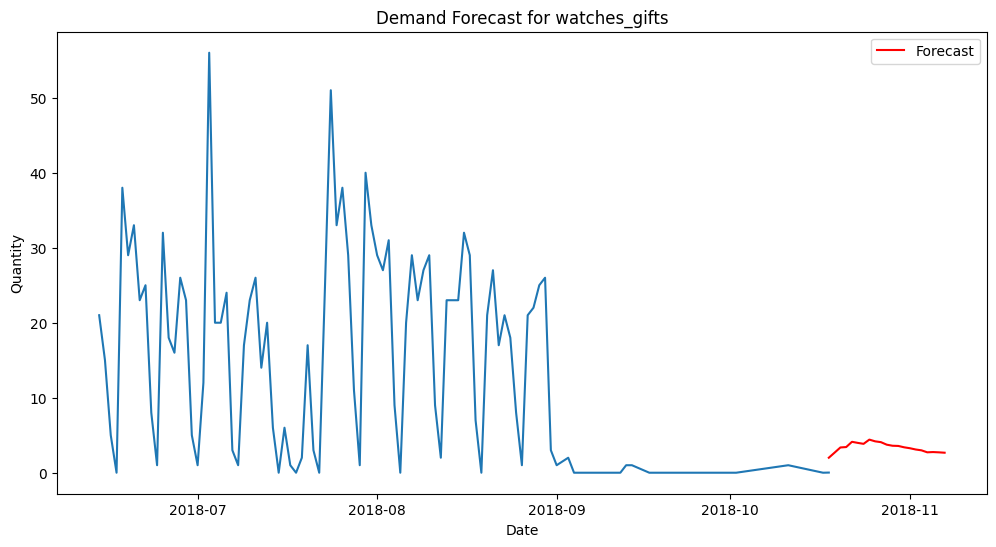

In [265]:
for category in df_t.columns:
  plt.figure(figsize=(12, 6))
  plt.plot(df_t.index[545:645], df_t[545:645][category])
  plt.plot(df_t[644:].index, 100 * df_t[644:][category], label="Forecast", color="red")
  plt.title(f"Demand Forecast for {category}")
  plt.xlabel("Date")
  plt.ylabel("Quantity")
  plt.legend()
  plt.show()

## Прогноз на 21 день за допомогою Gradient Boosting

In [266]:
def gradient_boosting(data, day):
  if day <= 0:
    return data

  df = data.copy()

  X = df[df.columns[:-1]]
  y = df[df.columns[-1:]]

  model = GradientBoostingRegressor()
  model.fit(X, y)
  model_pred = model.predict(X)

  next_day = df.columns[-1:][0] + pd.Timedelta(days=1)

  result = pd.DataFrame({next_day: model_pred}, index=df.index)

  new_df = pd.concat([df, result], axis=1)

  return gradient_boosting(new_df, day - 1)


In [ ]:
df = gradient_boosting(data_t, 21)

In [278]:
df

,2016-10-11,2016-10-13,2016-10-14,2016-10-15,2016-10-16,2016-10-17,2016-10-18,2016-10-19,2016-10-20,2016-10-21,...,2018-10-29,2018-10-30,2018-10-31,2018-11-01,2018-11-02,2018-11-03,2018-11-04,2018-11-05,2018-11-06,2018-11-07
product_category_name_english,,,,,,,,,,,,,,,,,,,,,
agro_industry_and_commerce,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.000004,0.000005,0.000005,0.000006,0.000006,0.000006,0.000007,0.000007,0.000007,0.000008
air_conditioning,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.000004,0.000005,0.000005,0.000006,0.000006,0.000006,0.000007,0.000007,0.000007,0.000008
art,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.000004,0.000005,0.000005,0.000006,0.000006,0.000006,0.000007,0.000007,0.000007,0.000008
arts_and_craftmanship,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.000004,0.000005,0.000005,0.000006,0.000006,0.000006,0.000007,0.000007,0.000007,0.000008
audio,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,1.0,0.0,...,0.000004,0.000005,0.000005,0.000006,0.000006,0.000006,0.000007,0.000007,0.000007,0.000008
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
stationery,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.000004,0.000005,0.000005,0.000006,0.000006,0.000006,0.000007,0.000007,0.000007,0.000008
tablets_printing_image,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.000004,0.000005,0.000005,0.000006,0.000006,0.000006,0.000007,0.000007,0.000007,0.000008
telephony,0.0,1.0,1.0,1.0,0.0,0.0,2.0,0.0,1.0,0.0,...,0.000004,0.000005,0.000005,0.000006,0.000006,0.000006,0.000007,0.000007,0.000007,0.000008


Досить цікаві рзультати. Виглядає не зовсім реалістично, але спробувати можна

In [ ]:
df_t = df.T
df_t

In [281]:
for cat in df_t.columns:
  df_t[cat] = df_t[cat].round(3)

In [ ]:
df_t

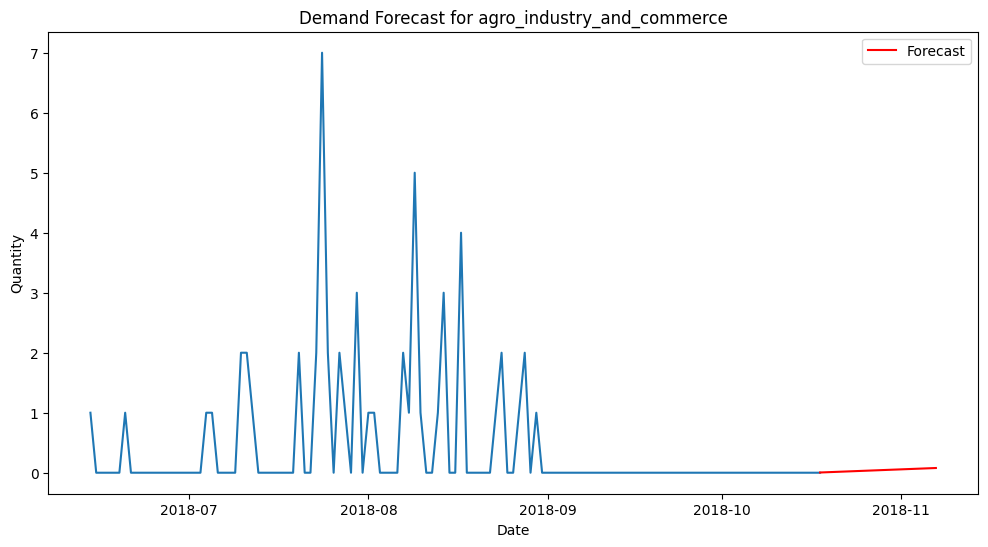

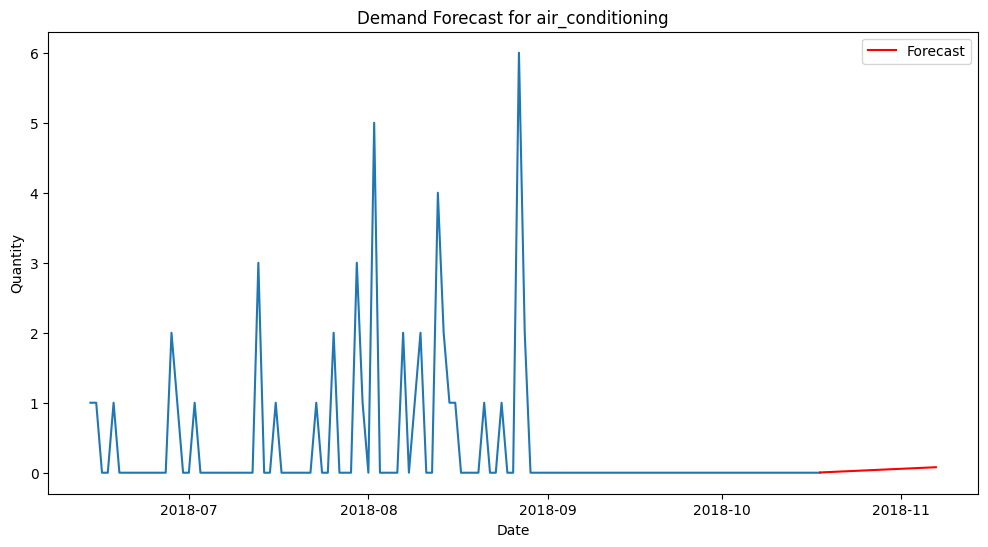

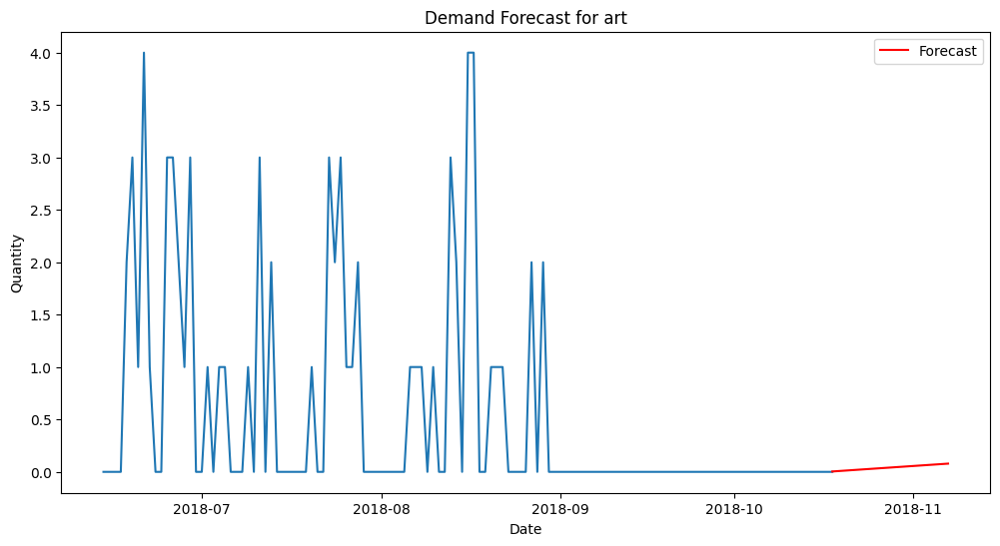

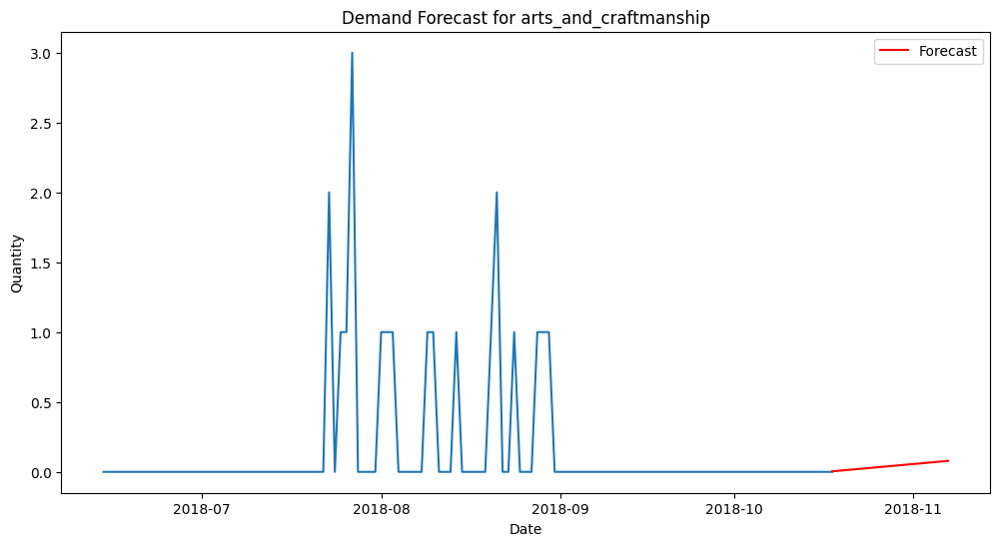

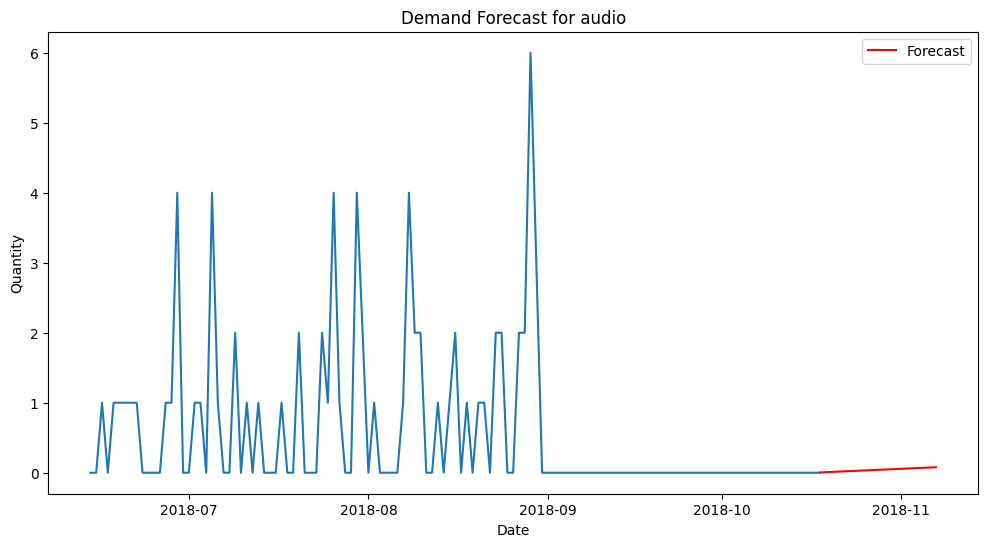

...

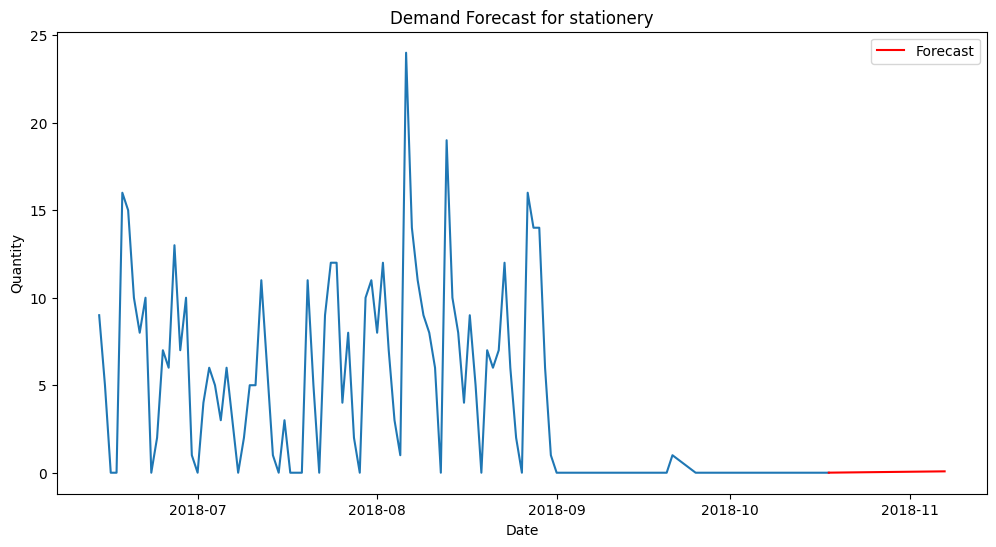

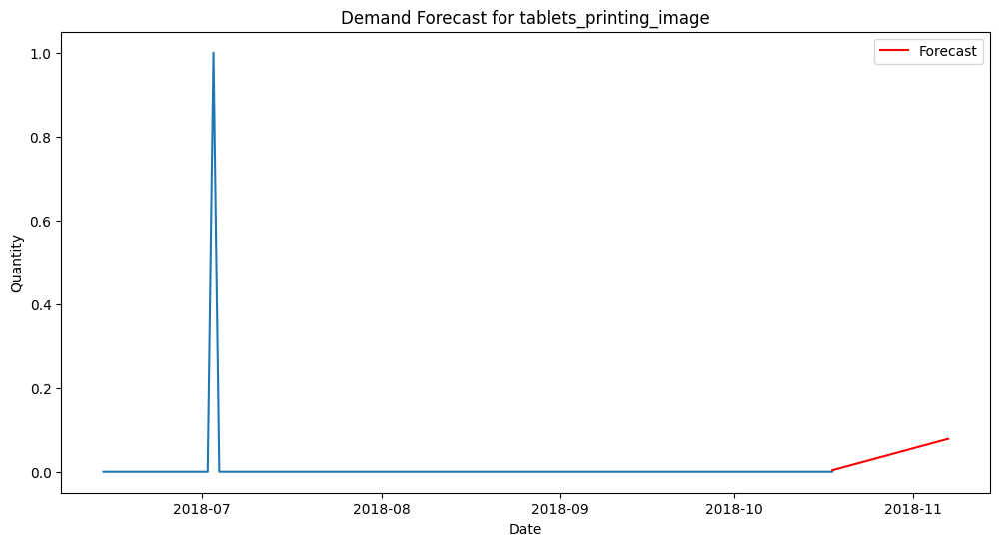

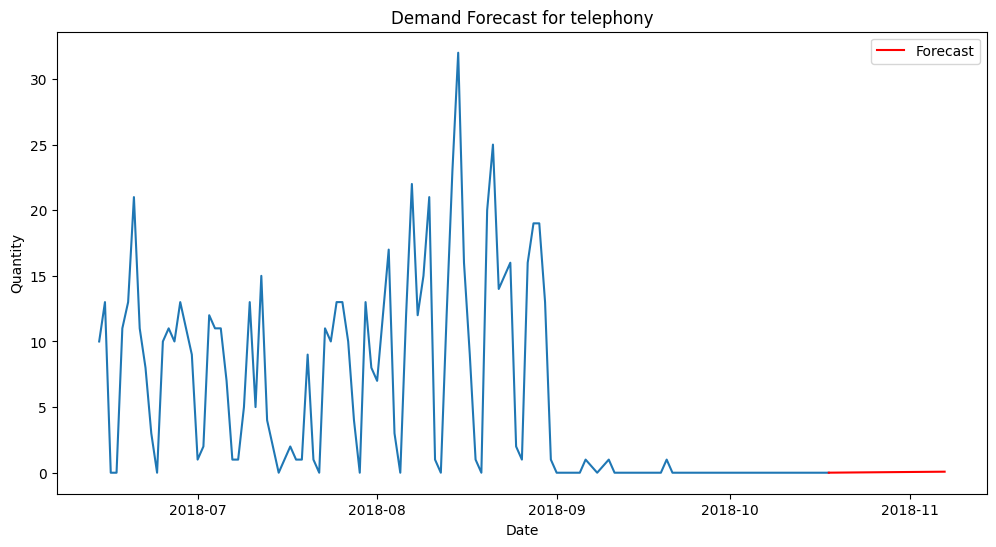

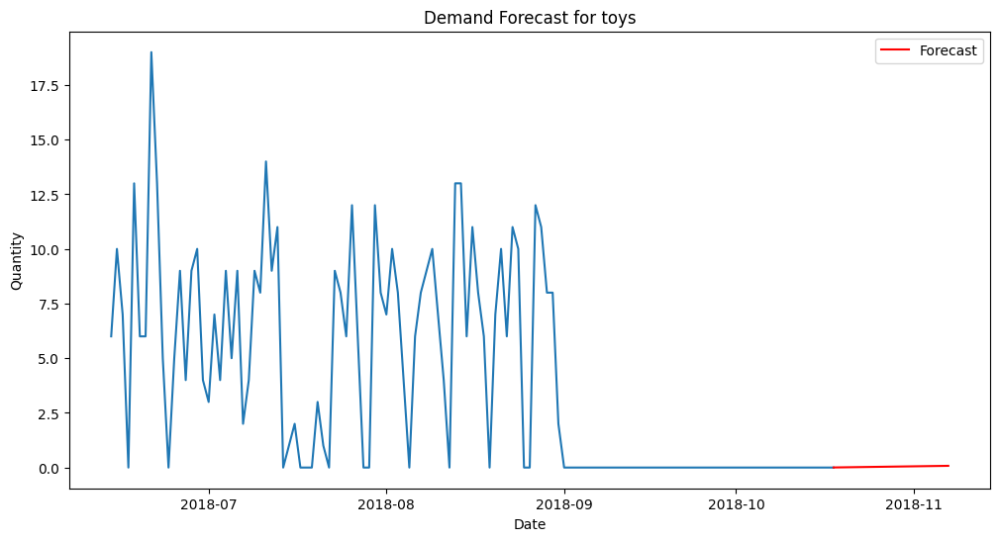

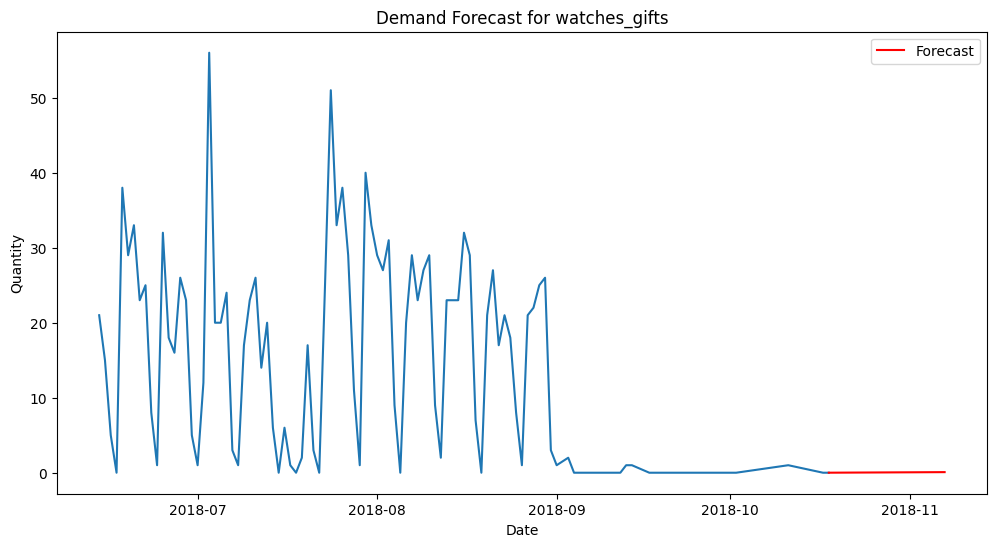

In [286]:
for category in df_t.columns:
  plt.figure(figsize=(12, 6))
  plt.plot(df_t.index[545:645], df_t[545:645][category])
  plt.plot(df_t[644:].index, 10000 * df_t[644:][category], label="Forecast", color="red")
  plt.title(f"Demand Forecast for {category}")
  plt.xlabel("Date")
  plt.ylabel("Quantity")
  plt.legend()
  plt.show()

# Висновок

1) Перше, що можна сказати, що на історичних даних можна підібрати певні моделі та параметри і прогнозувати, але це досить ненадійний спосіб. Такий спосіб можливий для короткочасних прогнозів і з детальнішим аналізом кожної категорії даних.

2) Загалом, моделі на основі таких даних навчилися непогано, незважаючи на те, що при аналізі не були використані більш наводжуючі дані про кожну категорію відносно певного періоду.

3) За графіками та результатами аналізу видно, що в деяких даних існує сезонність або залежність від дня тижня. При бажанні отримати якомога кращі результати треба врахувати ці моменти. Також, можна для кожно категорії можна додати додаткові фічі: коментар/оцінка покупця, день тижня, сезонність, геолокація та, можливо, ціна. В таких моментах теж важливо фільтрувати кількість додаткових фіч і слідкувати за перенавчанням моделей.

4) Також, можливий варіант перебору категорій, дослідження на схожість між ними властивостей (ознак) та групування між собою. При побудові моделі ARIMA диференціювання допомогло деяким категоріям, але не більшості.

## Пояснення вибору моделей

* **ARIMA (autoregressive integrated moving average)** -- модель авторегресійної інтегрованої ковзної середньої (AR + I + MA). Часто використовується в задачах на прогнозування відносно часових рядів: для прогнозування. Модель є ефективним рішенням для прогнозування на основі як стаціонарних так і нестаціонарних даних.

Авторегресійні моделі прогнозують значення часового ряду на основі його
минулих значень. Моделі ковзного середнього визначає прогноз часового ряду на
основі похибок минулих прогнозів.

Прогнозування часових рядів полягає у знаходженні майбутніх значень часового
ряду з якомога найбільшою точністю на основі минулих значень часового ряду та
інформації про його поведінку у минулому.

* **Random Forest / GBM** -- ансамблеві моделі класичного машинного навчання. Ансамблі чим хороші - це поєднання декількох алгоритмів, які навчаються одночасно і виправляють помилки один одного. Вони є гнучким та інтерпретованим способом вирішення проблем, що включає прогнозування цін на нерухомість, класифікацію споживачів та визначення шляху для реклами.

**Випадковий ліс** - це сукупність дерев рішень, які використовує деревоподібну структуру для розбиття набору даних на менші підмножини, а **Градієнтний бустинг** використовує градієнтний спуск для оптимізації та алгоритми ансамблів (дерев рішень) для передбачення.


Всі ці моделі єфективні та надійні перед задачами прогнозування, де в якості даних надаються нестабільні та неоднорідні дані. Ансамблі взагалі є чудовим рішенням для вирішення багатьох питань машинного навчання.


## Можливість розрахунку прогнозу на майбутні періоди

* def make_forecast(period)
* def random_forest(data, days)
* def gradient_boosting(data, days)